In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
# System imports
import os
import sys
import yaml

# External imports
import matplotlib.pyplot as plt
import scipy as sp
from sklearn.decomposition import PCA
from sklearn.metrics import auc
import numpy as np
import pandas as pd
import seaborn as sns
import torch
from pytorch_lightning.loggers import TensorBoardLogger, WandbLogger
from pytorch_lightning import Trainer
import frnn

sys.path.append('../..')

from LightningModules.Embedding.Models.cosine_layerless_embedding import CosineLayerlessEmbedding
from LightningModules.Embedding.Models.multi_layerless_embedding import MultiLayerlessEmbedding
import copy

device = "cuda" if torch.cuda.is_available() else "cpu"

In [3]:
with open("Multi_embedding.yaml") as f:
        multi_hparams = yaml.load(f, Loader=yaml.FullLoader)
with open("Cosine_embedding.yaml") as f:
        cosine_hparams = yaml.load(f, Loader=yaml.FullLoader)

In [4]:
training_name = input()

 with_noise6


In [5]:
multi_model = MultiLayerlessEmbedding(multi_hparams)
logger = WandbLogger(project="ITk_0GeV", group="Common_track_cosine_embedding_pretraining", name="pretrain_multiembedding_{}".format(training_name))
trainer = Trainer(gpus=1, max_epochs=multi_hparams["max_epochs"], logger=logger, num_sanity_val_steps=2)
trainer.fit(multi_model)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: exatrkx (use `wandb login --relogin` to force relogin)



  | Name            | Type       | Params
-----------------------------------------------
0 | layers          | ModuleList | 5.3 M 
1 | n_spaces_layers | ModuleList | 8.2 K 
2 | act             | GELU       | 0     
-----------------------------------------------
5.3 M     Trainable params
0         Non-trainable params
5.3 M     Total params
21.074    Total estimated model params size (MB)


Validation sanity check:   0%|          | 0/2 [00:00<?, ?it/s]

/global/homes/r/ryanliu/.conda/envs/gnn/lib/python3.8/site-packages/pytorch_lightning/trainer/data_loading.py:116: UserWarning: The dataloader, val_dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 256 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


Validation sanity check:  50%|█████     | 1/2 [00:07<00:07,  7.91s/it]

/global/u2/r/ryanliu/Tracking-ML-Exa.TrkX/Pipelines/Common_Tracking_Example/notebooks/ITk/../../LightningModules/Embedding/multi_embedding_base.py:285: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  eff = torch.tensor(cluster_true_positive / cluster_true)
/global/u2/r/ryanliu/Tracking-ML-Exa.TrkX/Pipelines/Common_Tracking_Example/notebooks/ITk/../../LightningModules/Embedding/multi_embedding_base.py:286: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  pur = torch.tensor(cluster_true_positive / cluster_positive)
/global/homes/r/ryanliu/.conda/envs/gnn/lib/python3.8/site-packages/pytorch_lightning/utilities/data.py:59: UserWarning: Trying to infer the `batch_size` from an ambiguous collection

/global/homes/r/ryanliu/.conda/envs/gnn/lib/python3.8/site-packages/pytorch_lightning/trainer/data_loading.py:116: UserWarning: The dataloader, train_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 256 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


Epoch 0:  98%|█████████▊| 1000/1020 [05:04<00:06,  3.28it/s, loss=0.457, v_num=bec0]
Validating: 0it [00:00, ?it/s]
Epoch 1:  98%|█████████▊| 1000/1020 [05:10<00:06,  3.22it/s, loss=0.439, v_num=bec0]
Validating: 0it [00:00, ?it/s]
Epoch 2:  98%|█████████▊| 1000/1020 [05:16<00:06,  3.16it/s, loss=0.437, v_num=bec0]
Validating: 0it [00:00, ?it/s]
Epoch 3:  98%|█████████▊| 1000/1020 [05:38<00:06,  2.95it/s, loss=0.41, v_num=bec0] 
Validating: 0it [00:00, ?it/s]
Epoch 4:  98%|█████████▊| 1000/1020 [05:43<00:06,  2.91it/s, loss=0.404, v_num=bec0]
Validating: 0it [00:00, ?it/s]
Epoch 4: 100%|██████████| 1020/1020 [07:22<00:00,  2.30it/s, loss=0.404, v_num=bec0]


In [6]:
cosine_model = CosineLayerlessEmbedding(cosine_hparams)
cosine_model.load_state_dict(multi_model.state_dict())
del multi_model
del trainer
del logger
import wandb
wandb.finish()
from pytorch_lightning.loggers import TensorBoardLogger, WandbLogger

current_lr,▁▁▁▁▁
eff@1.0,▁████
epoch,▁▁▁▁▁▁▁▁▃▃▃▃▃▃▃▃▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆████████
pur@1.0,▁████
train_loss,████████▇▇█▇▇▇▆▆▅▆▅▆▅▅▅▆▅▅▅▄▃▃▃▂▃▂▂▂▂▂▂▁
trainer/global_step,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇████
val_loss@1.0,██▇▂▁
current_lr,0.0005
eff@1.0,0.95195
epoch,4
pur@1.0,0.00274


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



  | Name            | Type             | Params
-----------------------------------------------------
0 | cos             | CosineSimilarity | 0     
1 | layers          | ModuleList       | 5.3 M 
2 | n_spaces_layers | ModuleList       | 8.2 K 
3 | act             | GELU             | 0     
-----------------------------------------------------
5.3 M     Trainable params
0         Non-trainable params
5.3 M     Total params
21.074    Total estimated model params size (MB)
/global/homes/r/ryanliu/.conda/envs/gnn/lib/python3.8/site-packages/pytorch_lightning/trainer/data_loading.py:116: UserWarning: The dataloader, train_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 256 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(
/global/homes/r/ryanliu/.conda/envs/gnn/lib/python3.8/site-packages/pytorch_lightning/trainer/data_loading.py:116: UserWarn

Epoch 0:  98%|█████████▊| 1000/1020 [07:03<00:08,  2.36it/s, loss=0.582, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

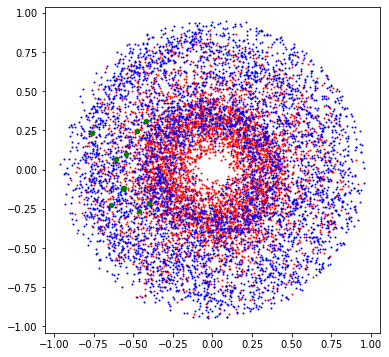


Epoch 0:  98%|█████████▊| 1002/1020 [07:12<00:07,  2.32it/s, loss=0.582, v_num=kt0p]

/global/u2/r/ryanliu/Tracking-ML-Exa.TrkX/Pipelines/Common_Tracking_Example/notebooks/ITk/../../LightningModules/Embedding/cosine_embedding_base.py:362: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  eff = torch.tensor(cluster_true_positive / cluster_true)
/global/u2/r/ryanliu/Tracking-ML-Exa.TrkX/Pipelines/Common_Tracking_Example/notebooks/ITk/../../LightningModules/Embedding/cosine_embedding_base.py:363: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  pur = torch.tensor(cluster_true_positive / cluster_positive)


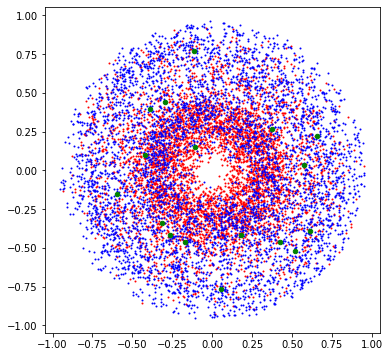


Validating:  10%|█         | 2/20 [00:15<02:17,  7.66s/it]

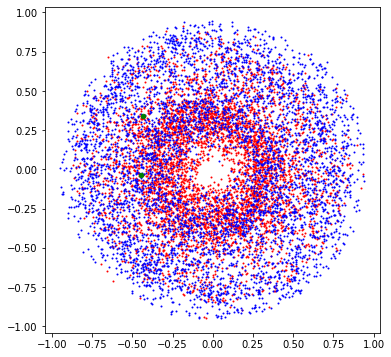


Epoch 0:  98%|█████████▊| 1004/1020 [07:26<00:07,  2.25it/s, loss=0.582, v_num=kt0p]

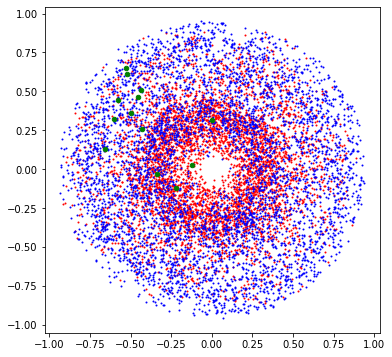


Epoch 0:  99%|█████████▊| 1005/1020 [07:32<00:06,  2.22it/s, loss=0.582, v_num=kt0p]

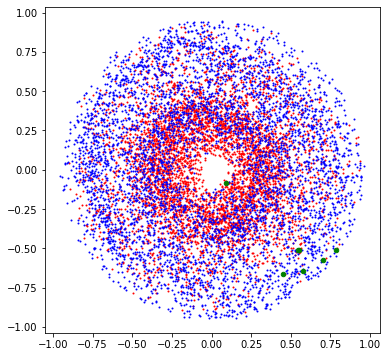


Epoch 0:  99%|█████████▊| 1006/1020 [07:39<00:06,  2.19it/s, loss=0.582, v_num=kt0p]

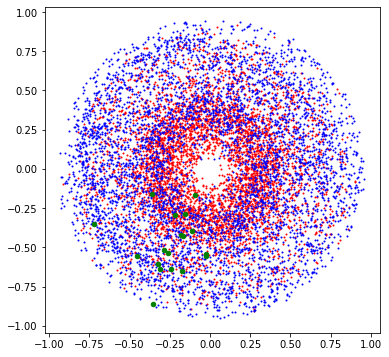


Epoch 0:  99%|█████████▊| 1007/1020 [07:46<00:06,  2.16it/s, loss=0.582, v_num=kt0p]

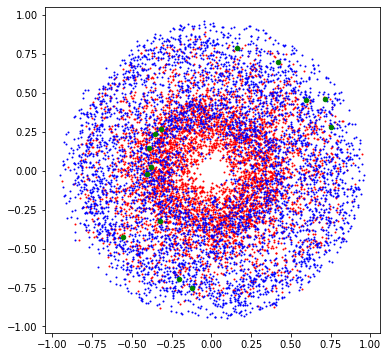


Epoch 0:  99%|█████████▉| 1008/1020 [07:53<00:05,  2.13it/s, loss=0.582, v_num=kt0p]

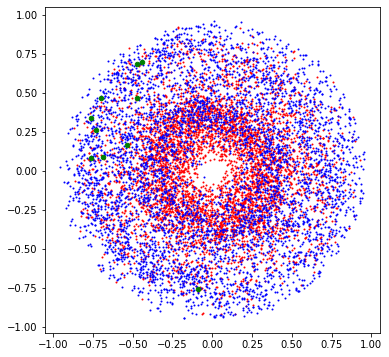


Epoch 0:  99%|█████████▉| 1009/1020 [07:59<00:05,  2.10it/s, loss=0.582, v_num=kt0p]

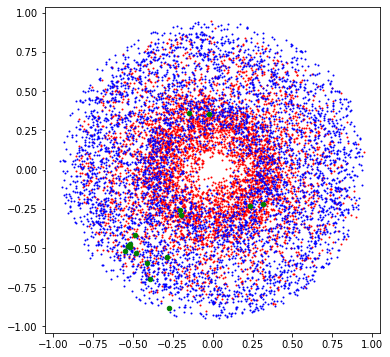


Epoch 0:  99%|█████████▉| 1010/1020 [08:06<00:04,  2.07it/s, loss=0.582, v_num=kt0p]

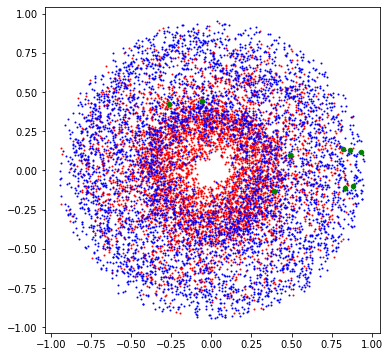


Epoch 0:  99%|█████████▉| 1011/1020 [08:13<00:04,  2.05it/s, loss=0.582, v_num=kt0p]

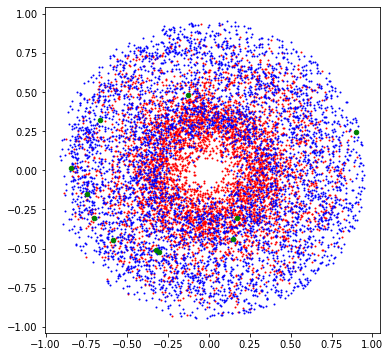


Epoch 0:  99%|█████████▉| 1012/1020 [08:21<00:03,  2.02it/s, loss=0.582, v_num=kt0p]

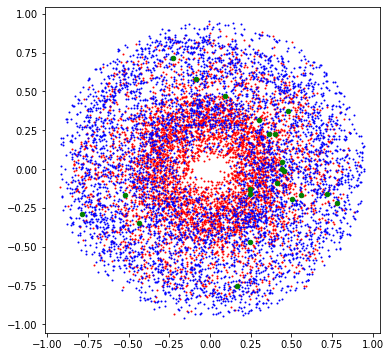


Epoch 0:  99%|█████████▉| 1013/1020 [08:28<00:03,  1.99it/s, loss=0.582, v_num=kt0p]

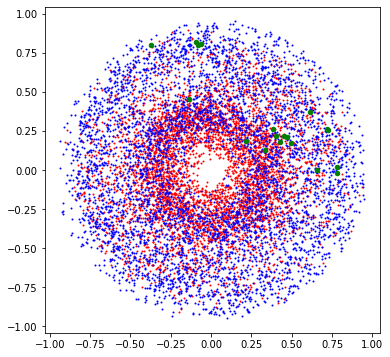


Epoch 0:  99%|█████████▉| 1014/1020 [08:35<00:03,  1.97it/s, loss=0.582, v_num=kt0p]

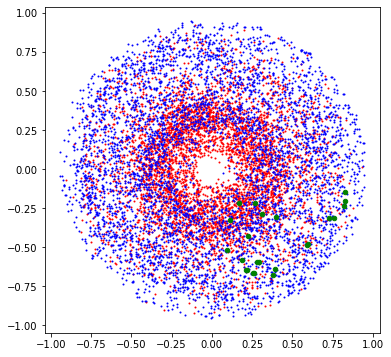


Epoch 0: 100%|█████████▉| 1015/1020 [08:43<00:02,  1.94it/s, loss=0.582, v_num=kt0p]

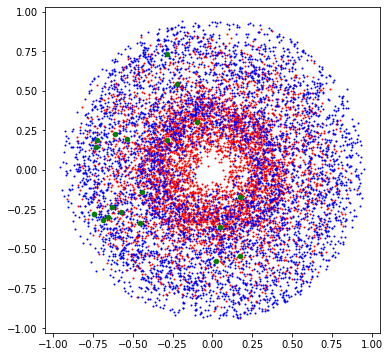


Epoch 0: 100%|█████████▉| 1016/1020 [08:50<00:02,  1.91it/s, loss=0.582, v_num=kt0p]

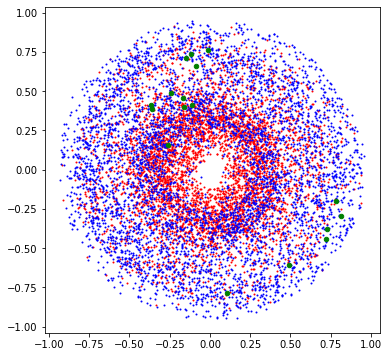


Epoch 0: 100%|█████████▉| 1017/1020 [08:56<00:01,  1.89it/s, loss=0.582, v_num=kt0p]

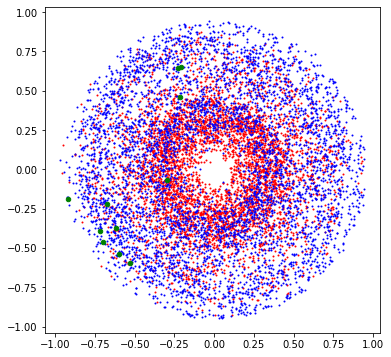


Epoch 0: 100%|█████████▉| 1018/1020 [09:04<00:01,  1.87it/s, loss=0.582, v_num=kt0p]

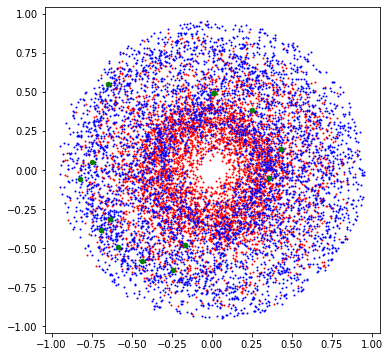


Epoch 0: 100%|█████████▉| 1019/1020 [09:10<00:00,  1.85it/s, loss=0.582, v_num=kt0p]

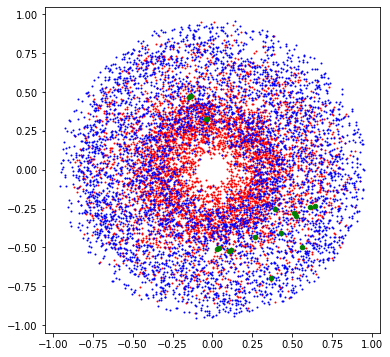


Epoch 0: 100%|██████████| 1020/1020 [09:17<00:00,  1.83it/s, loss=0.582, v_num=kt0p]

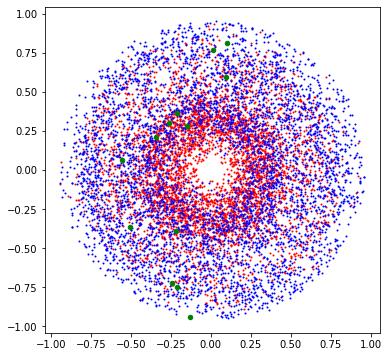


Epoch 1:  98%|█████████▊| 1000/1020 [06:52<00:08,  2.42it/s, loss=0.577, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

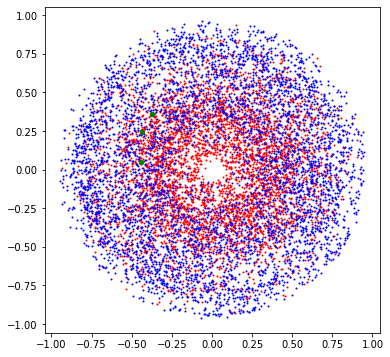


Epoch 1:  98%|█████████▊| 1002/1020 [07:03<00:07,  2.37it/s, loss=0.577, v_num=kt0p]

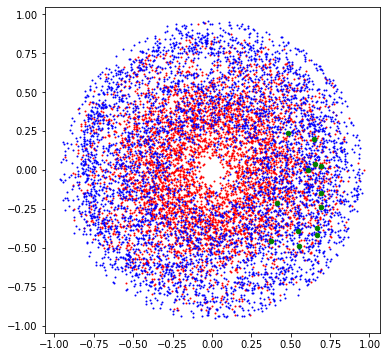


Epoch 1:  98%|█████████▊| 1003/1020 [07:11<00:07,  2.33it/s, loss=0.577, v_num=kt0p]

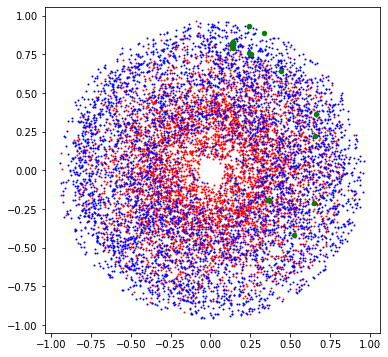


Epoch 1:  98%|█████████▊| 1004/1020 [07:18<00:06,  2.29it/s, loss=0.577, v_num=kt0p]

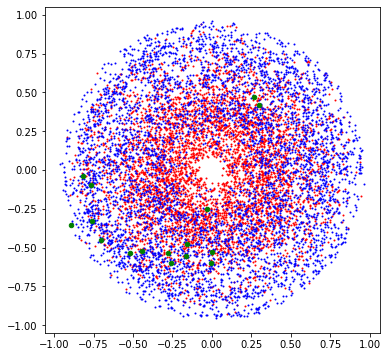


Epoch 1:  99%|█████████▊| 1005/1020 [07:26<00:06,  2.25it/s, loss=0.577, v_num=kt0p]

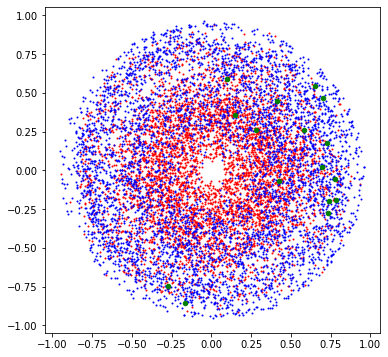


Epoch 1:  99%|█████████▊| 1006/1020 [07:35<00:06,  2.21it/s, loss=0.577, v_num=kt0p]

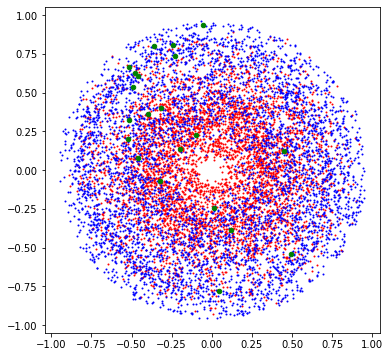


Epoch 1:  99%|█████████▊| 1007/1020 [07:43<00:05,  2.17it/s, loss=0.577, v_num=kt0p]

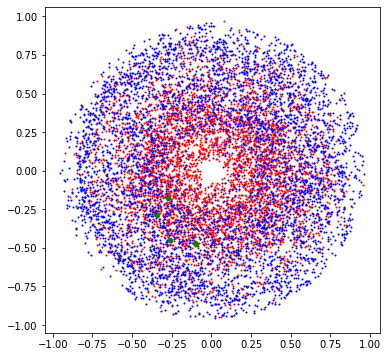


Epoch 1:  99%|█████████▉| 1008/1020 [07:51<00:05,  2.14it/s, loss=0.577, v_num=kt0p]

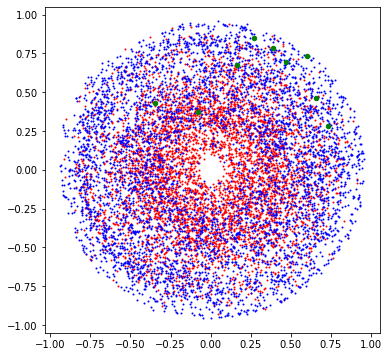


Epoch 1:  99%|█████████▉| 1009/1020 [07:58<00:05,  2.11it/s, loss=0.577, v_num=kt0p]

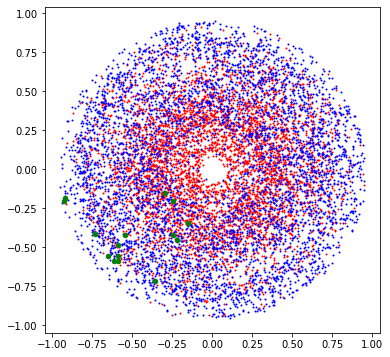


Epoch 1:  99%|█████████▉| 1010/1020 [08:07<00:04,  2.07it/s, loss=0.577, v_num=kt0p]

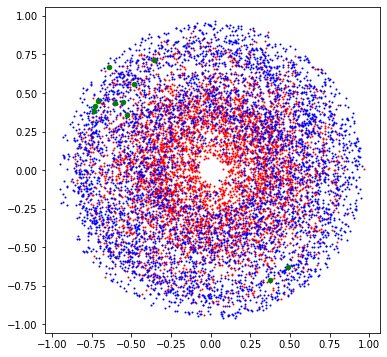


Epoch 1:  99%|█████████▉| 1011/1020 [08:15<00:04,  2.04it/s, loss=0.577, v_num=kt0p]

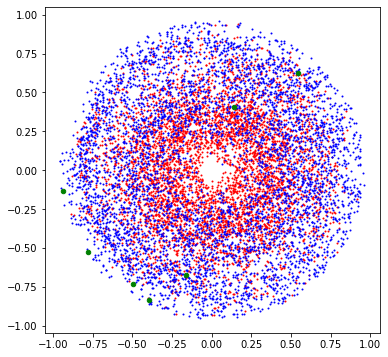


Epoch 1:  99%|█████████▉| 1012/1020 [08:24<00:03,  2.01it/s, loss=0.577, v_num=kt0p]

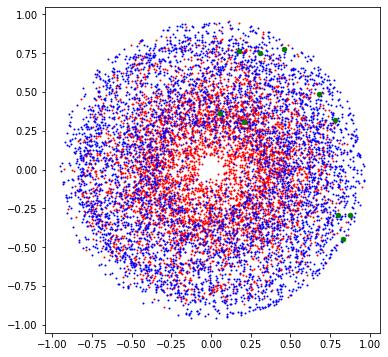


Epoch 1:  99%|█████████▉| 1013/1020 [08:32<00:03,  1.98it/s, loss=0.577, v_num=kt0p]

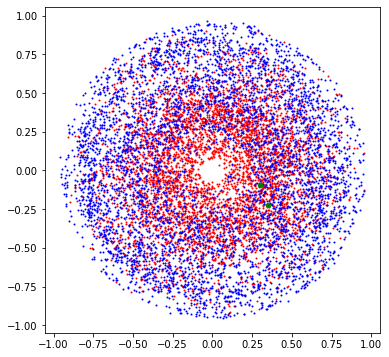


Epoch 1:  99%|█████████▉| 1014/1020 [08:41<00:03,  1.94it/s, loss=0.577, v_num=kt0p]

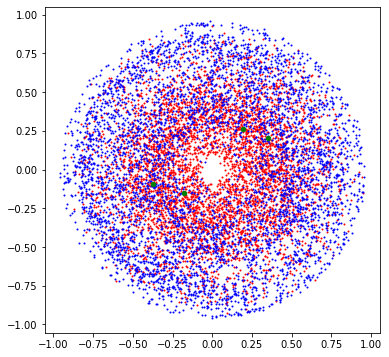


Epoch 1: 100%|█████████▉| 1015/1020 [08:51<00:02,  1.91it/s, loss=0.577, v_num=kt0p]

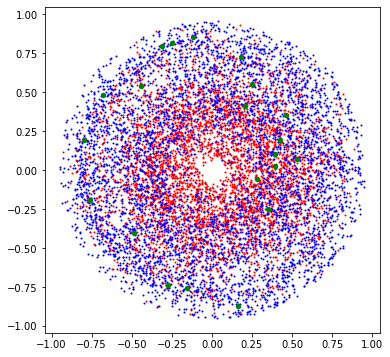


Epoch 1: 100%|█████████▉| 1016/1020 [08:59<00:02,  1.88it/s, loss=0.577, v_num=kt0p]

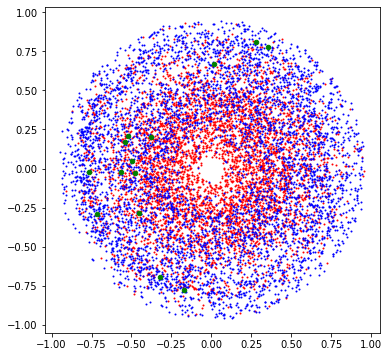


Epoch 1: 100%|█████████▉| 1017/1020 [09:06<00:01,  1.86it/s, loss=0.577, v_num=kt0p]

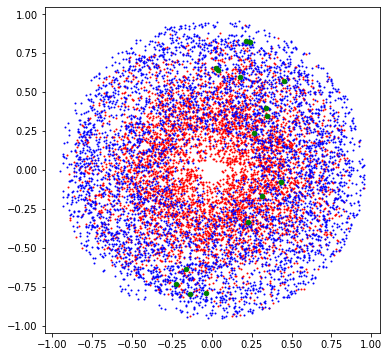


Epoch 1: 100%|█████████▉| 1018/1020 [09:15<00:01,  1.83it/s, loss=0.577, v_num=kt0p]

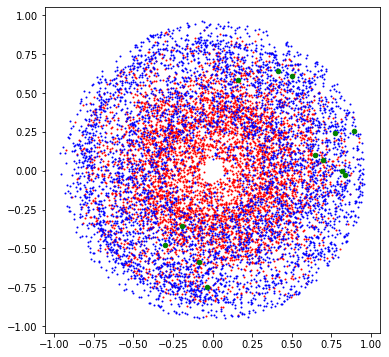


Epoch 1: 100%|█████████▉| 1019/1020 [09:23<00:00,  1.81it/s, loss=0.577, v_num=kt0p]

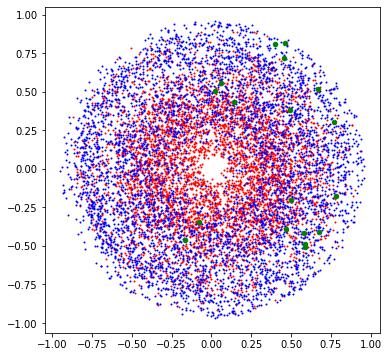


Epoch 1: 100%|██████████| 1020/1020 [09:31<00:00,  1.78it/s, loss=0.577, v_num=kt0p]

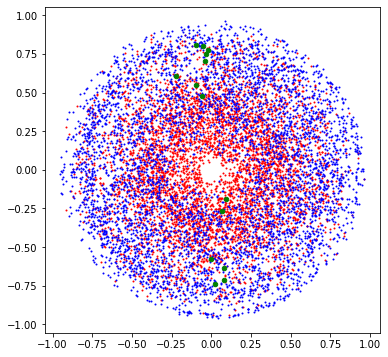


Epoch 2:  98%|█████████▊| 1000/1020 [07:06<00:08,  2.34it/s, loss=0.575, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

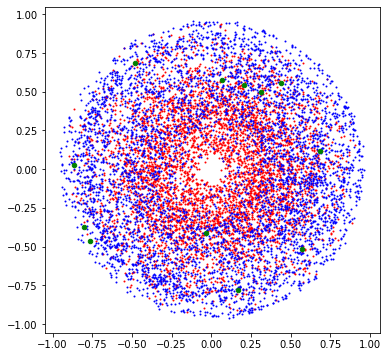


Epoch 2:  98%|█████████▊| 1002/1020 [07:17<00:07,  2.29it/s, loss=0.575, v_num=kt0p]

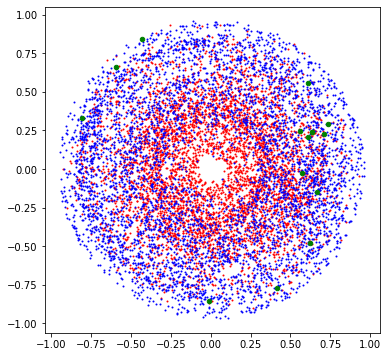


Epoch 2:  98%|█████████▊| 1003/1020 [07:25<00:07,  2.25it/s, loss=0.575, v_num=kt0p]

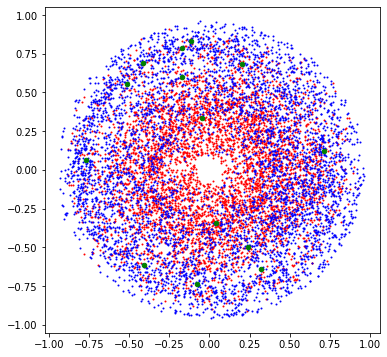


Epoch 2:  98%|█████████▊| 1004/1020 [07:33<00:07,  2.21it/s, loss=0.575, v_num=kt0p]

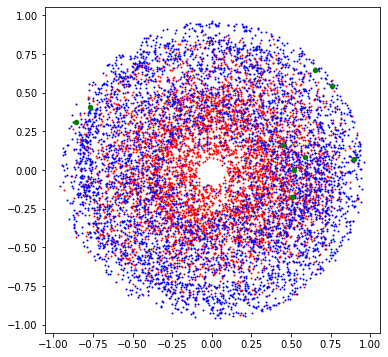


Epoch 2:  99%|█████████▊| 1005/1020 [07:40<00:06,  2.18it/s, loss=0.575, v_num=kt0p]

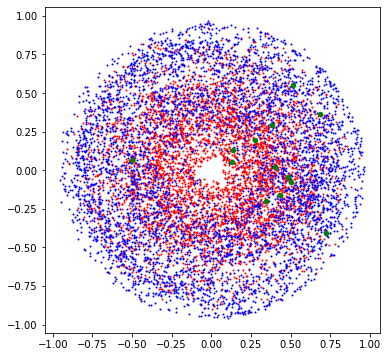


Epoch 2:  99%|█████████▊| 1006/1020 [07:50<00:06,  2.14it/s, loss=0.575, v_num=kt0p]

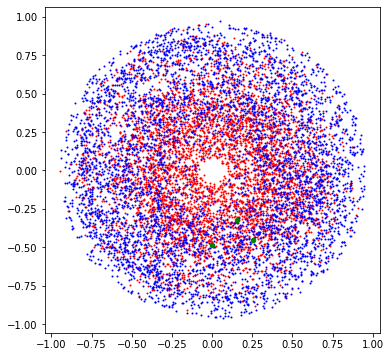


Epoch 2:  99%|█████████▊| 1007/1020 [07:58<00:06,  2.10it/s, loss=0.575, v_num=kt0p]

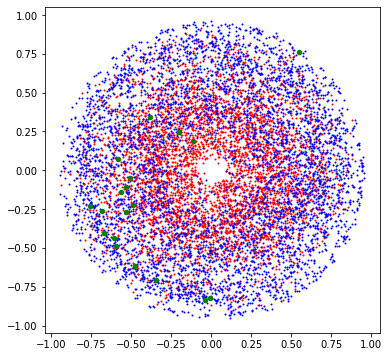


Epoch 2:  99%|█████████▉| 1008/1020 [08:06<00:05,  2.07it/s, loss=0.575, v_num=kt0p]

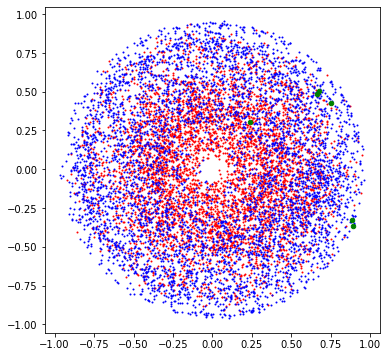


Epoch 2:  99%|█████████▉| 1009/1020 [08:14<00:05,  2.04it/s, loss=0.575, v_num=kt0p]

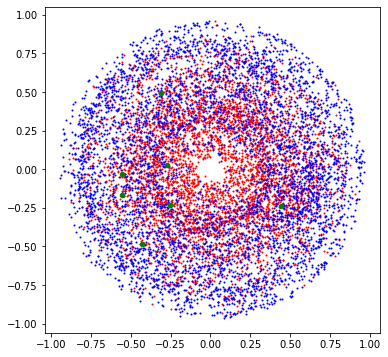


Epoch 2:  99%|█████████▉| 1010/1020 [08:23<00:04,  2.01it/s, loss=0.575, v_num=kt0p]

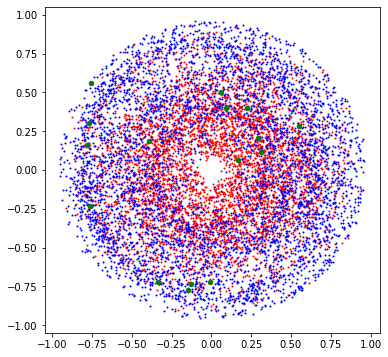


Epoch 2:  99%|█████████▉| 1011/1020 [08:31<00:04,  1.98it/s, loss=0.575, v_num=kt0p]

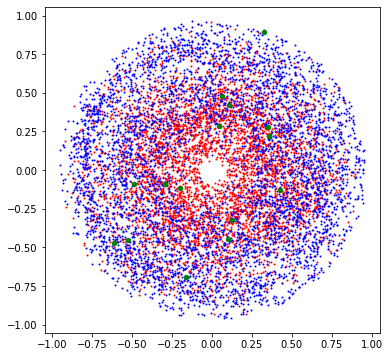


Epoch 2:  99%|█████████▉| 1012/1020 [08:41<00:04,  1.94it/s, loss=0.575, v_num=kt0p]

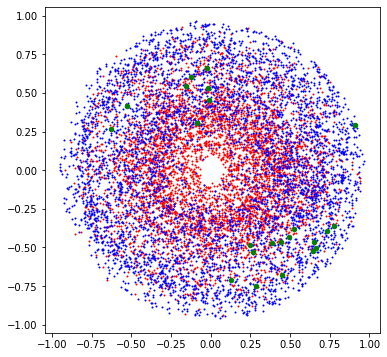


Epoch 2:  99%|█████████▉| 1013/1020 [08:49<00:03,  1.91it/s, loss=0.575, v_num=kt0p]

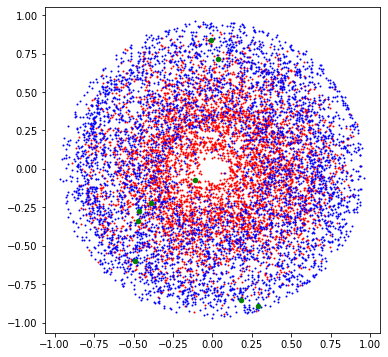


Epoch 2:  99%|█████████▉| 1014/1020 [08:58<00:03,  1.88it/s, loss=0.575, v_num=kt0p]

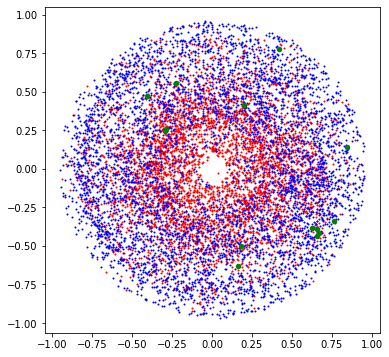


Epoch 2: 100%|█████████▉| 1015/1020 [09:08<00:02,  1.85it/s, loss=0.575, v_num=kt0p]

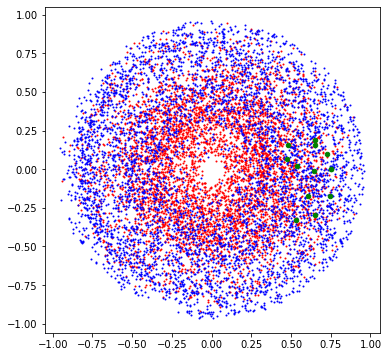


Epoch 2: 100%|█████████▉| 1016/1020 [09:17<00:02,  1.82it/s, loss=0.575, v_num=kt0p]

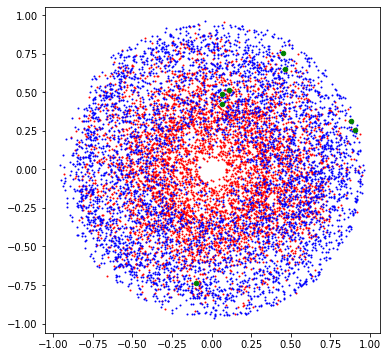


Epoch 2: 100%|█████████▉| 1017/1020 [09:25<00:01,  1.80it/s, loss=0.575, v_num=kt0p]

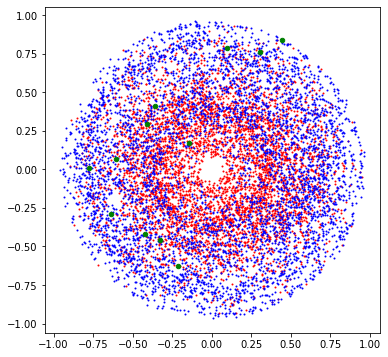


Epoch 2: 100%|█████████▉| 1018/1020 [09:34<00:01,  1.77it/s, loss=0.575, v_num=kt0p]

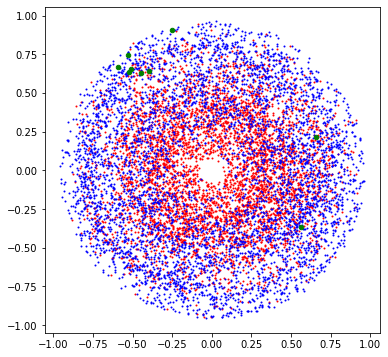


Epoch 2: 100%|█████████▉| 1019/1020 [09:42<00:00,  1.75it/s, loss=0.575, v_num=kt0p]

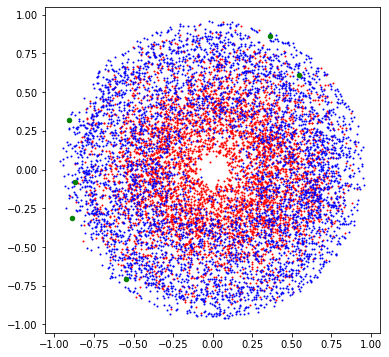


Epoch 2: 100%|██████████| 1020/1020 [09:50<00:00,  1.73it/s, loss=0.575, v_num=kt0p]

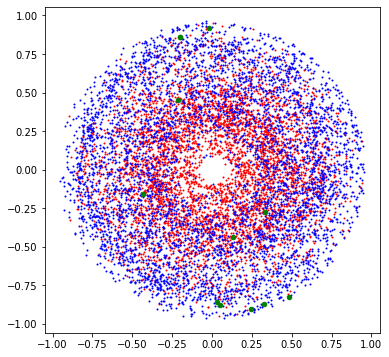


Epoch 3:  98%|█████████▊| 1000/1020 [06:47<00:08,  2.45it/s, loss=0.574, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

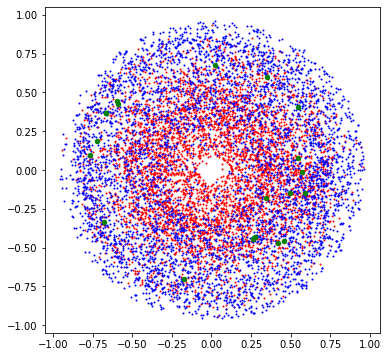


Epoch 3:  98%|█████████▊| 1002/1020 [06:58<00:07,  2.39it/s, loss=0.574, v_num=kt0p]

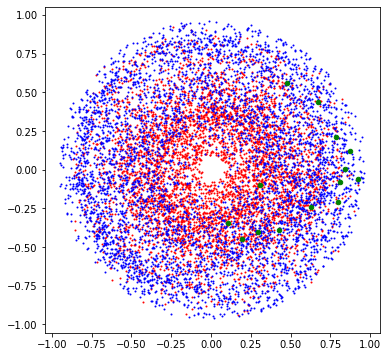


Epoch 3:  98%|█████████▊| 1003/1020 [07:07<00:07,  2.35it/s, loss=0.574, v_num=kt0p]

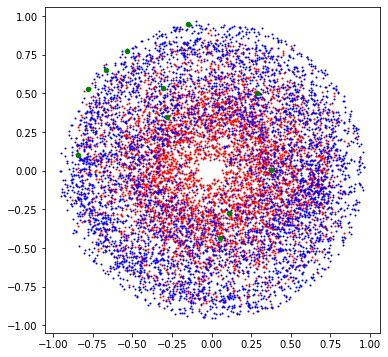


Epoch 3:  98%|█████████▊| 1004/1020 [07:15<00:06,  2.31it/s, loss=0.574, v_num=kt0p]

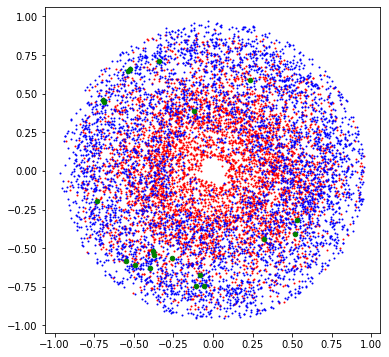


Epoch 3:  99%|█████████▊| 1005/1020 [07:22<00:06,  2.27it/s, loss=0.574, v_num=kt0p]

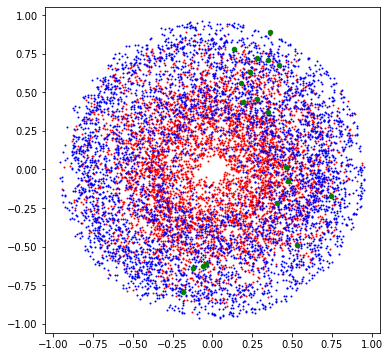


Epoch 3:  99%|█████████▊| 1006/1020 [07:32<00:06,  2.22it/s, loss=0.574, v_num=kt0p]

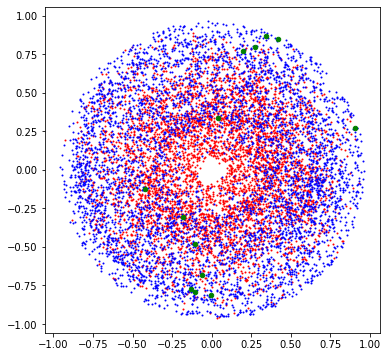


Epoch 3:  99%|█████████▊| 1007/1020 [07:41<00:05,  2.18it/s, loss=0.574, v_num=kt0p]

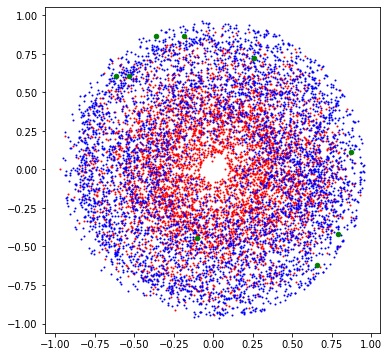


Epoch 3:  99%|█████████▉| 1008/1020 [07:49<00:05,  2.15it/s, loss=0.574, v_num=kt0p]

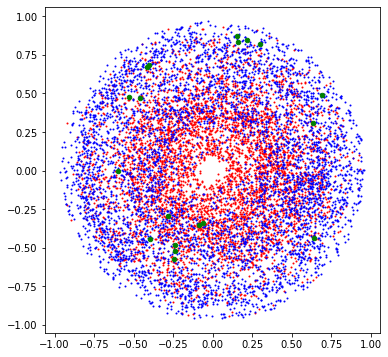


Epoch 3:  99%|█████████▉| 1009/1020 [07:57<00:05,  2.11it/s, loss=0.574, v_num=kt0p]

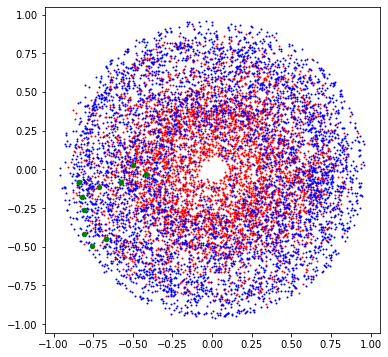


Epoch 3:  99%|█████████▉| 1010/1020 [08:06<00:04,  2.07it/s, loss=0.574, v_num=kt0p]

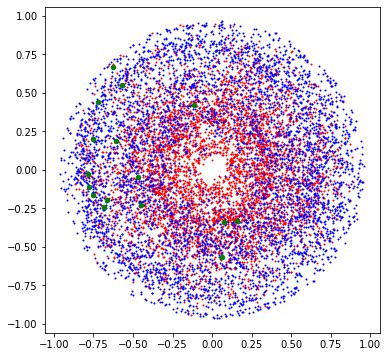


Epoch 3:  99%|█████████▉| 1011/1020 [08:15<00:04,  2.04it/s, loss=0.574, v_num=kt0p]

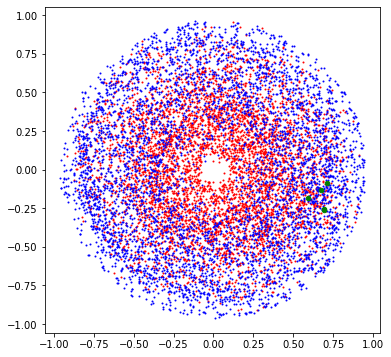


Epoch 3:  99%|█████████▉| 1012/1020 [08:26<00:04,  2.00it/s, loss=0.574, v_num=kt0p]

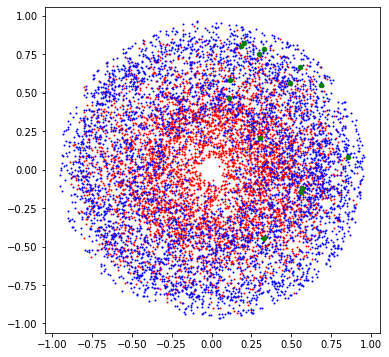


Epoch 3:  99%|█████████▉| 1013/1020 [08:34<00:03,  1.97it/s, loss=0.574, v_num=kt0p]

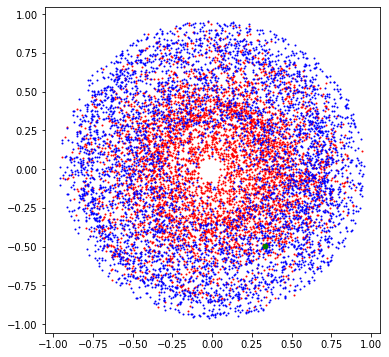


Epoch 3:  99%|█████████▉| 1014/1020 [08:44<00:03,  1.93it/s, loss=0.574, v_num=kt0p]

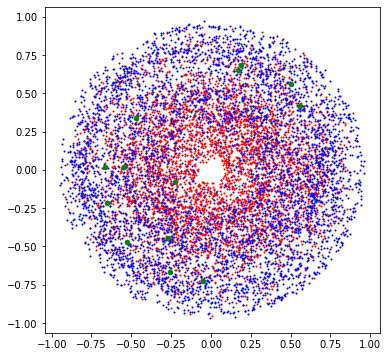


Epoch 3: 100%|█████████▉| 1015/1020 [08:55<00:02,  1.90it/s, loss=0.574, v_num=kt0p]

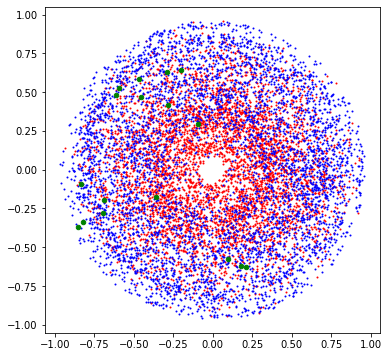


Epoch 3: 100%|█████████▉| 1016/1020 [09:03<00:02,  1.87it/s, loss=0.574, v_num=kt0p]

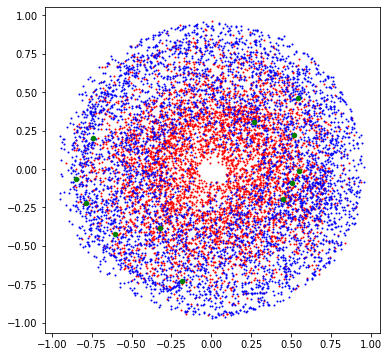


Epoch 3: 100%|█████████▉| 1017/1020 [09:11<00:01,  1.84it/s, loss=0.574, v_num=kt0p]

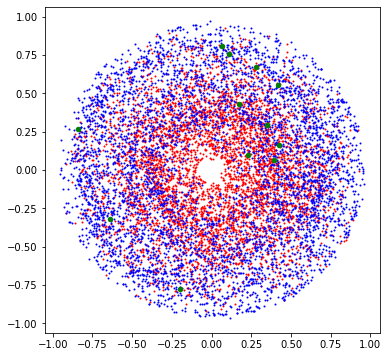


Epoch 3: 100%|█████████▉| 1018/1020 [09:20<00:01,  1.82it/s, loss=0.574, v_num=kt0p]

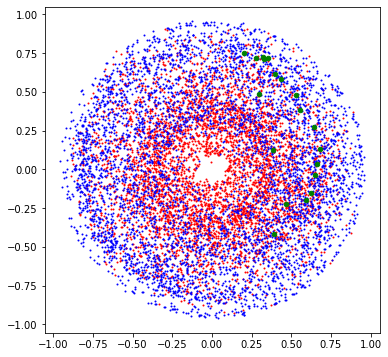


Epoch 3: 100%|█████████▉| 1019/1020 [09:28<00:00,  1.79it/s, loss=0.574, v_num=kt0p]

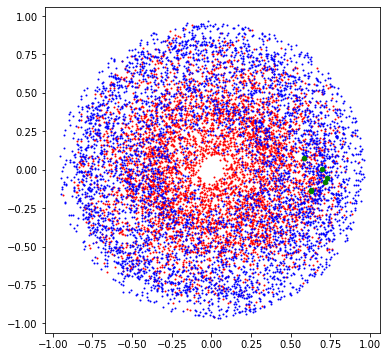


Epoch 3: 100%|██████████| 1020/1020 [09:37<00:00,  1.77it/s, loss=0.574, v_num=kt0p]

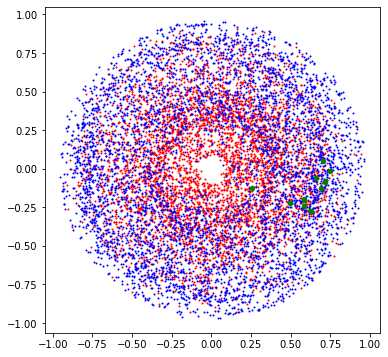


Epoch 4:  98%|█████████▊| 1000/1020 [06:58<00:08,  2.39it/s, loss=0.573, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

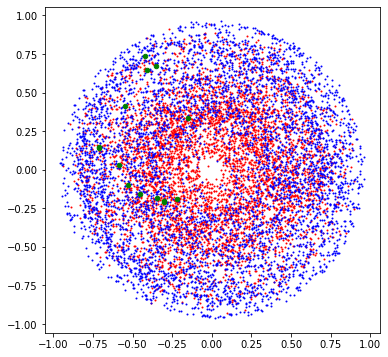


Epoch 4:  98%|█████████▊| 1002/1020 [07:09<00:07,  2.33it/s, loss=0.573, v_num=kt0p]

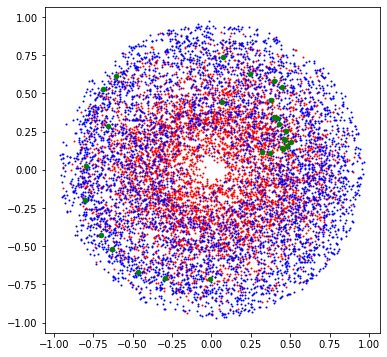


Epoch 4:  98%|█████████▊| 1003/1020 [07:18<00:07,  2.29it/s, loss=0.573, v_num=kt0p]

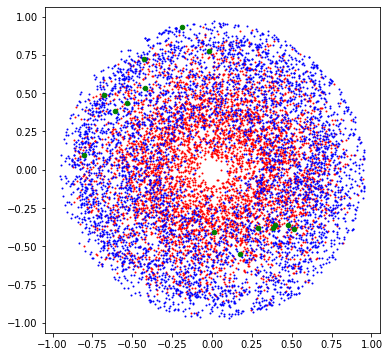


Epoch 4:  98%|█████████▊| 1004/1020 [07:26<00:07,  2.25it/s, loss=0.573, v_num=kt0p]

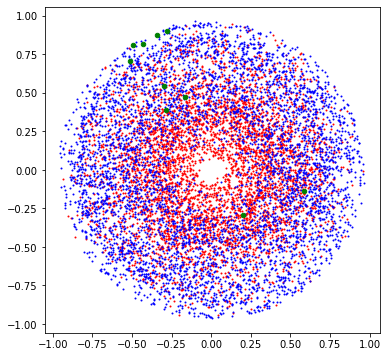


Epoch 4:  99%|█████████▊| 1005/1020 [07:34<00:06,  2.21it/s, loss=0.573, v_num=kt0p]

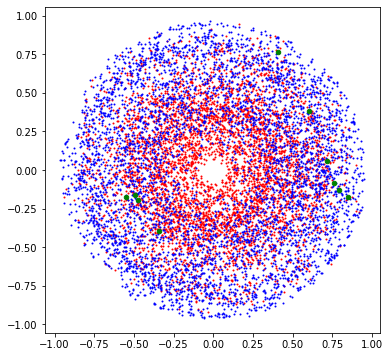


Epoch 4:  99%|█████████▊| 1006/1020 [07:43<00:06,  2.17it/s, loss=0.573, v_num=kt0p]

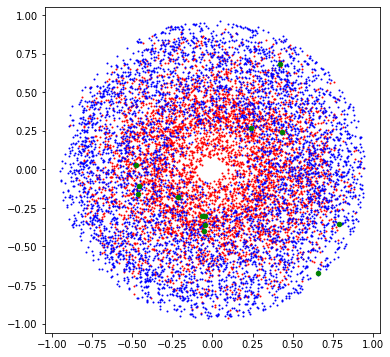


Epoch 4:  99%|█████████▊| 1007/1020 [07:52<00:06,  2.13it/s, loss=0.573, v_num=kt0p]

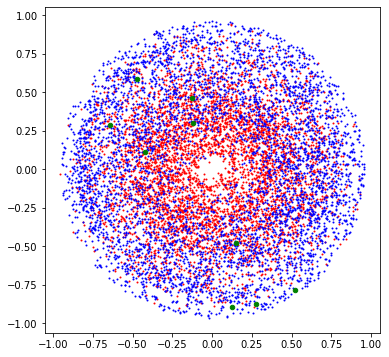


Epoch 4:  99%|█████████▉| 1008/1020 [08:00<00:05,  2.10it/s, loss=0.573, v_num=kt0p]

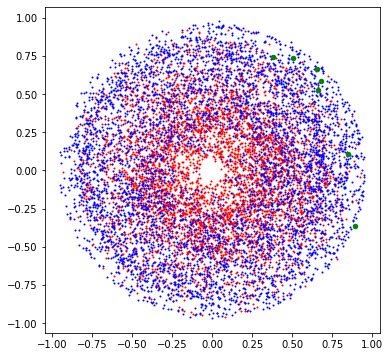


Epoch 4:  99%|█████████▉| 1009/1020 [08:08<00:05,  2.07it/s, loss=0.573, v_num=kt0p]

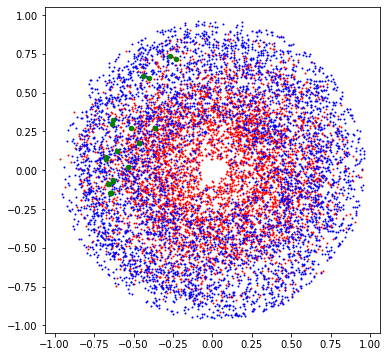


Epoch 4:  99%|█████████▉| 1010/1020 [08:17<00:04,  2.03it/s, loss=0.573, v_num=kt0p]

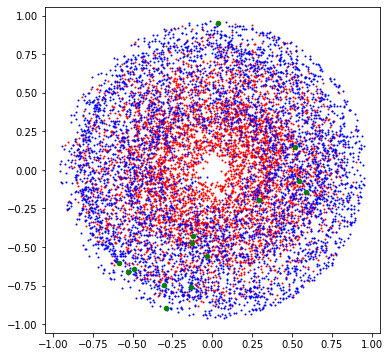


Epoch 4:  99%|█████████▉| 1011/1020 [08:25<00:04,  2.00it/s, loss=0.573, v_num=kt0p]

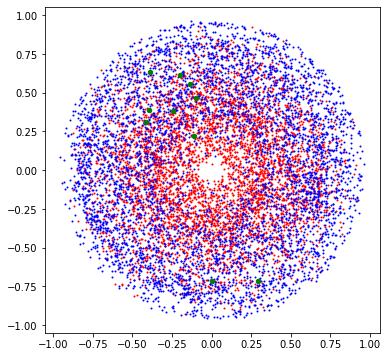


Epoch 4:  99%|█████████▉| 1012/1020 [08:36<00:04,  1.96it/s, loss=0.573, v_num=kt0p]

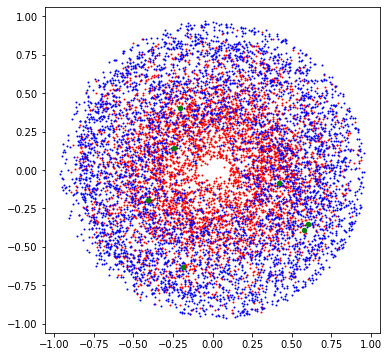


Epoch 4:  99%|█████████▉| 1013/1020 [08:45<00:03,  1.93it/s, loss=0.573, v_num=kt0p]

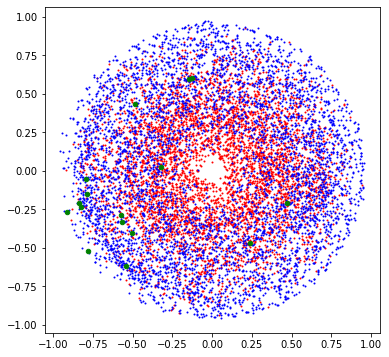


Epoch 4:  99%|█████████▉| 1014/1020 [08:54<00:03,  1.90it/s, loss=0.573, v_num=kt0p]

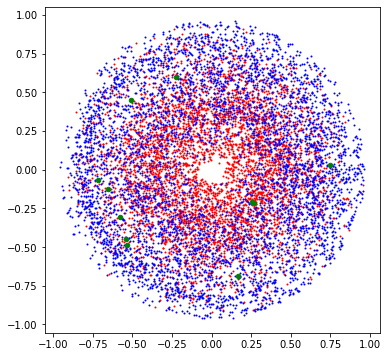


Epoch 4: 100%|█████████▉| 1015/1020 [09:04<00:02,  1.86it/s, loss=0.573, v_num=kt0p]

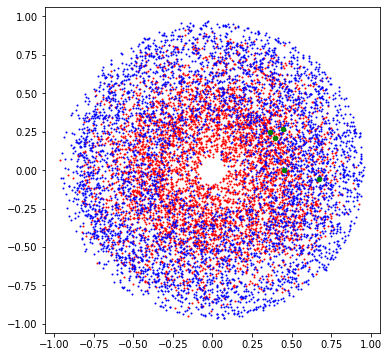


Epoch 4: 100%|█████████▉| 1016/1020 [09:13<00:02,  1.84it/s, loss=0.573, v_num=kt0p]

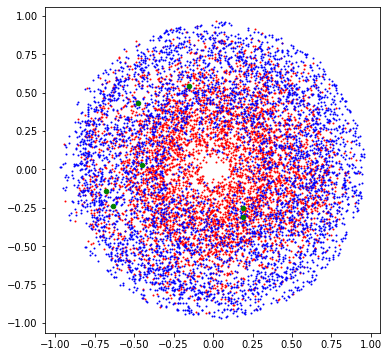


Epoch 4: 100%|█████████▉| 1017/1020 [09:21<00:01,  1.81it/s, loss=0.573, v_num=kt0p]

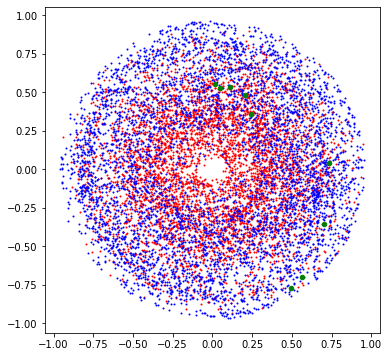


Epoch 4: 100%|█████████▉| 1018/1020 [09:30<00:01,  1.78it/s, loss=0.573, v_num=kt0p]

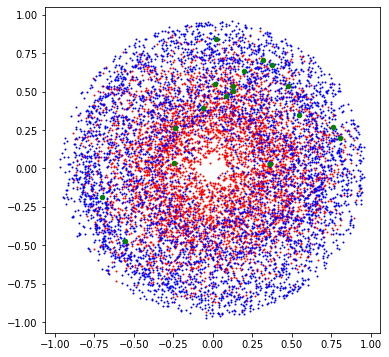


Epoch 4: 100%|█████████▉| 1019/1020 [09:38<00:00,  1.76it/s, loss=0.573, v_num=kt0p]

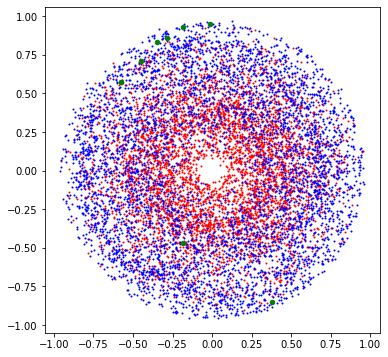


Epoch 4: 100%|██████████| 1020/1020 [09:47<00:00,  1.74it/s, loss=0.573, v_num=kt0p]

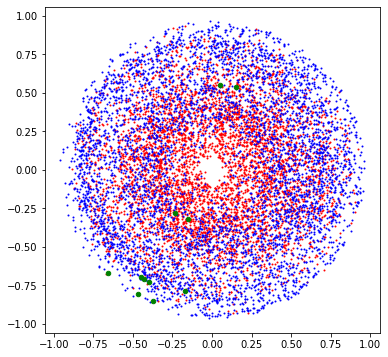


Epoch 5:  98%|█████████▊| 1000/1020 [06:56<00:08,  2.40it/s, loss=0.573, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

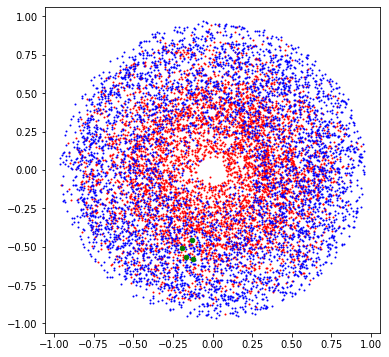


Epoch 5:  98%|█████████▊| 1002/1020 [07:07<00:07,  2.35it/s, loss=0.573, v_num=kt0p]

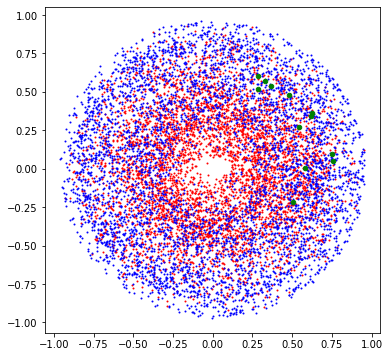


Epoch 5:  98%|█████████▊| 1003/1020 [07:16<00:07,  2.30it/s, loss=0.573, v_num=kt0p]

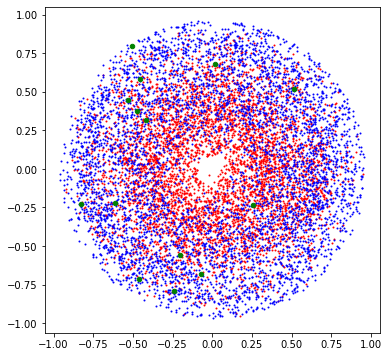


Epoch 5:  98%|█████████▊| 1004/1020 [07:24<00:07,  2.26it/s, loss=0.573, v_num=kt0p]

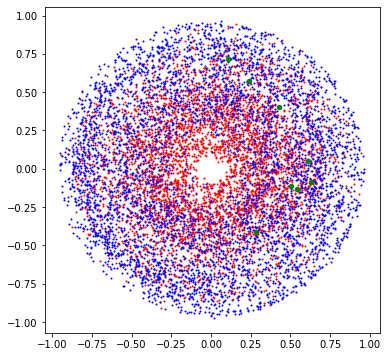


Epoch 5:  99%|█████████▊| 1005/1020 [07:32<00:06,  2.22it/s, loss=0.573, v_num=kt0p]

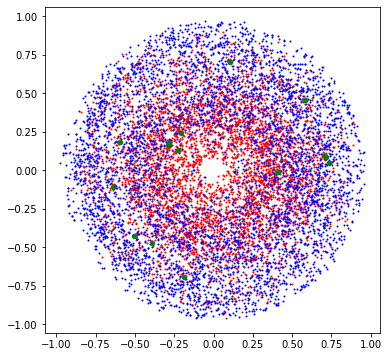


Epoch 5:  99%|█████████▊| 1006/1020 [07:42<00:06,  2.18it/s, loss=0.573, v_num=kt0p]

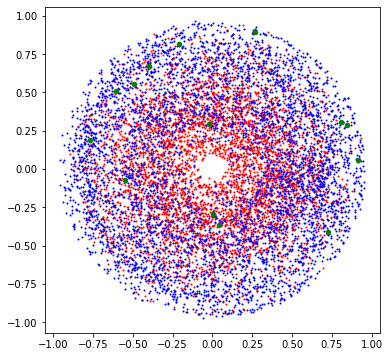


Epoch 5:  99%|█████████▊| 1007/1020 [07:51<00:06,  2.14it/s, loss=0.573, v_num=kt0p]

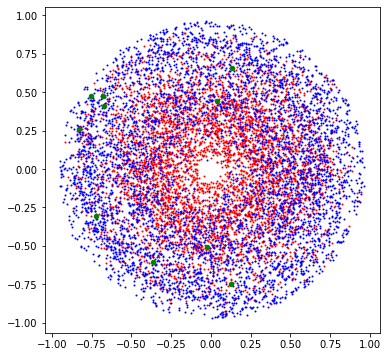


Epoch 5:  99%|█████████▉| 1008/1020 [07:59<00:05,  2.10it/s, loss=0.573, v_num=kt0p]

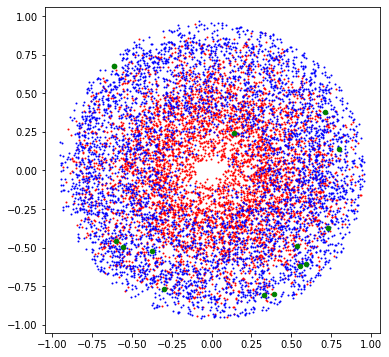


Epoch 5:  99%|█████████▉| 1009/1020 [08:07<00:05,  2.07it/s, loss=0.573, v_num=kt0p]

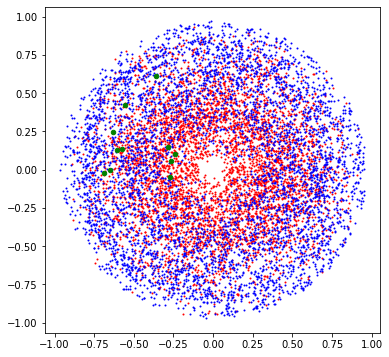


Epoch 5:  99%|█████████▉| 1010/1020 [08:17<00:04,  2.03it/s, loss=0.573, v_num=kt0p]

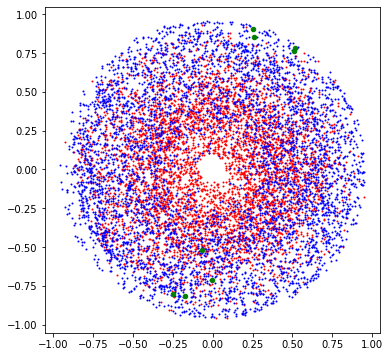


Epoch 5:  99%|█████████▉| 1011/1020 [08:25<00:04,  2.00it/s, loss=0.573, v_num=kt0p]

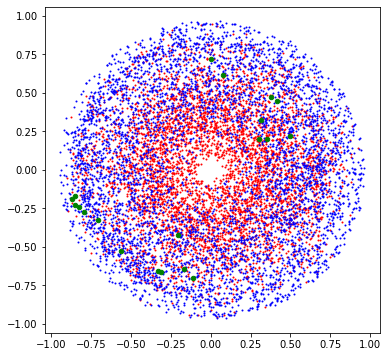


Epoch 5:  99%|█████████▉| 1012/1020 [08:36<00:04,  1.96it/s, loss=0.573, v_num=kt0p]

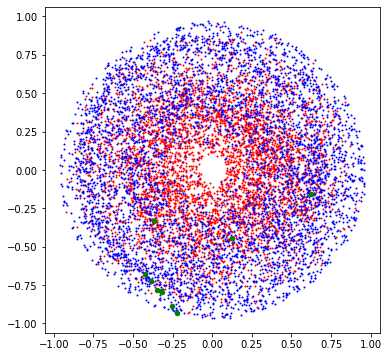


Epoch 5:  99%|█████████▉| 1013/1020 [08:45<00:03,  1.93it/s, loss=0.573, v_num=kt0p]

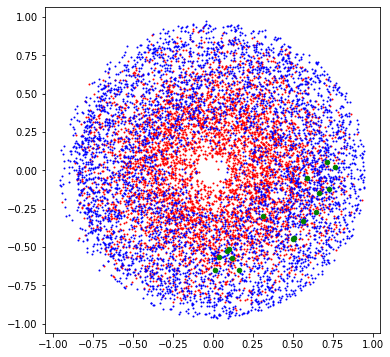


Epoch 5:  99%|█████████▉| 1014/1020 [08:54<00:03,  1.90it/s, loss=0.573, v_num=kt0p]

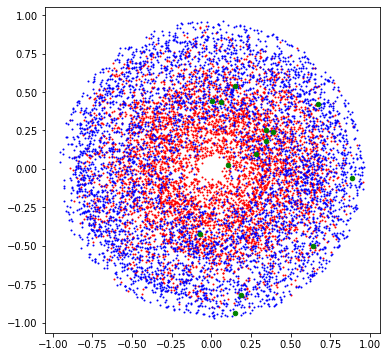


Epoch 5: 100%|█████████▉| 1015/1020 [09:05<00:02,  1.86it/s, loss=0.573, v_num=kt0p]

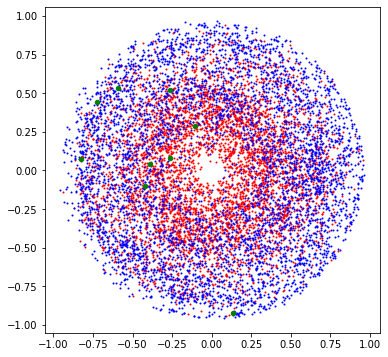


Epoch 5: 100%|█████████▉| 1016/1020 [09:14<00:02,  1.83it/s, loss=0.573, v_num=kt0p]

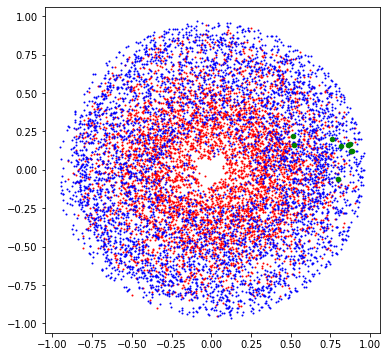


Epoch 5: 100%|█████████▉| 1017/1020 [09:22<00:01,  1.81it/s, loss=0.573, v_num=kt0p]

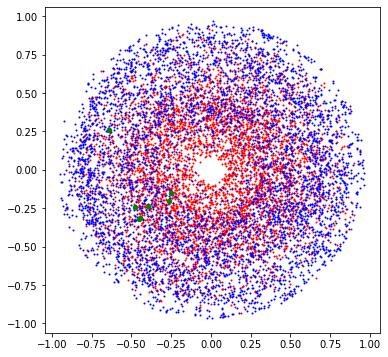


Epoch 5: 100%|█████████▉| 1018/1020 [09:32<00:01,  1.78it/s, loss=0.573, v_num=kt0p]

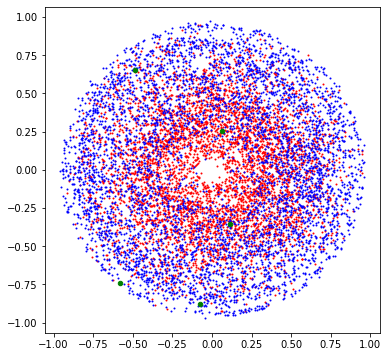


Epoch 5: 100%|█████████▉| 1019/1020 [09:40<00:00,  1.75it/s, loss=0.573, v_num=kt0p]

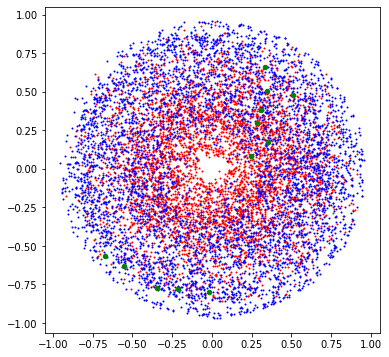


Epoch 5: 100%|██████████| 1020/1020 [09:49<00:00,  1.73it/s, loss=0.573, v_num=kt0p]

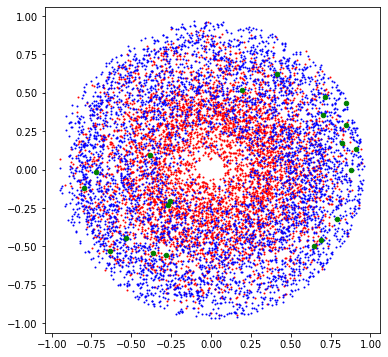


Epoch 6:  98%|█████████▊| 1000/1020 [06:56<00:08,  2.40it/s, loss=0.572, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

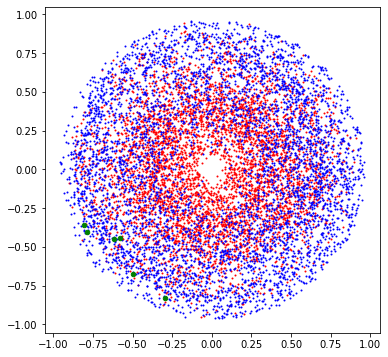


Epoch 6:  98%|█████████▊| 1002/1020 [07:07<00:07,  2.34it/s, loss=0.572, v_num=kt0p]

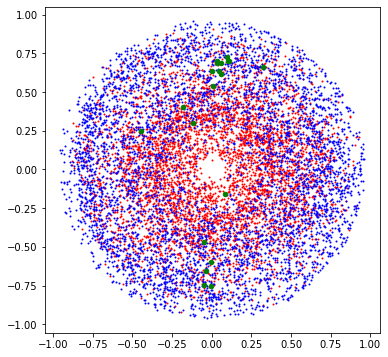


Epoch 6:  98%|█████████▊| 1003/1020 [07:16<00:07,  2.30it/s, loss=0.572, v_num=kt0p]

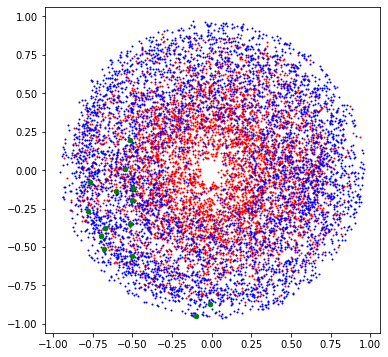


Epoch 6:  98%|█████████▊| 1004/1020 [07:25<00:07,  2.26it/s, loss=0.572, v_num=kt0p]

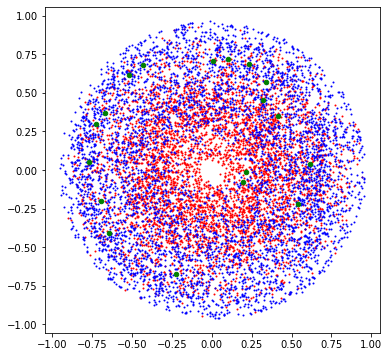


Epoch 6:  99%|█████████▊| 1005/1020 [07:32<00:06,  2.22it/s, loss=0.572, v_num=kt0p]

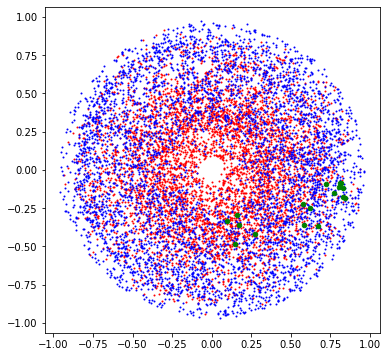


Epoch 6:  99%|█████████▊| 1006/1020 [07:43<00:06,  2.17it/s, loss=0.572, v_num=kt0p]

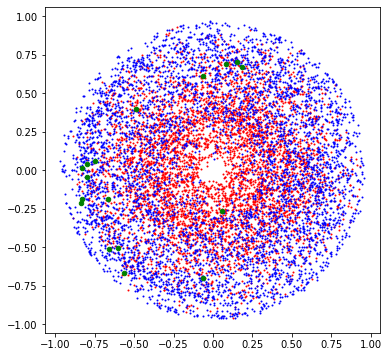


Epoch 6:  99%|█████████▊| 1007/1020 [07:51<00:06,  2.13it/s, loss=0.572, v_num=kt0p]

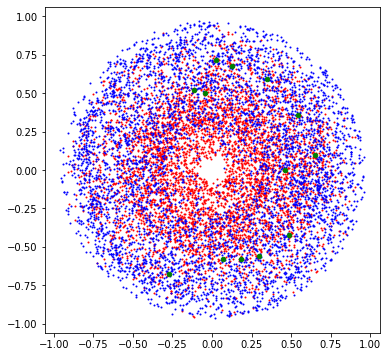


Epoch 6:  99%|█████████▉| 1008/1020 [08:00<00:05,  2.10it/s, loss=0.572, v_num=kt0p]

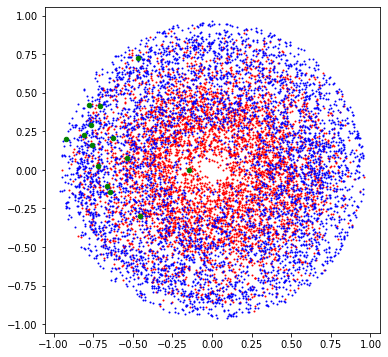


Epoch 6:  99%|█████████▉| 1009/1020 [08:08<00:05,  2.07it/s, loss=0.572, v_num=kt0p]

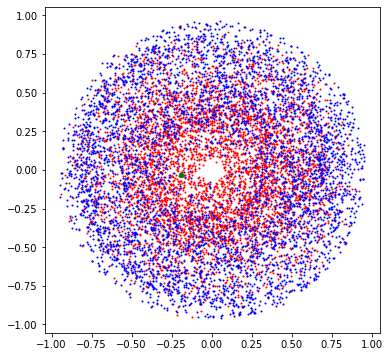


Epoch 6:  99%|█████████▉| 1010/1020 [08:17<00:04,  2.03it/s, loss=0.572, v_num=kt0p]

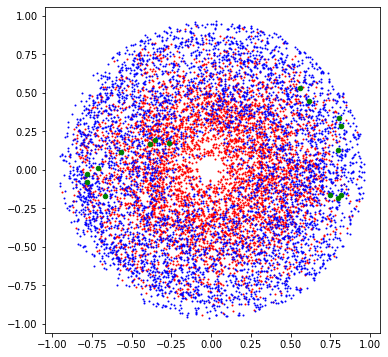


Epoch 6:  99%|█████████▉| 1011/1020 [08:26<00:04,  2.00it/s, loss=0.572, v_num=kt0p]

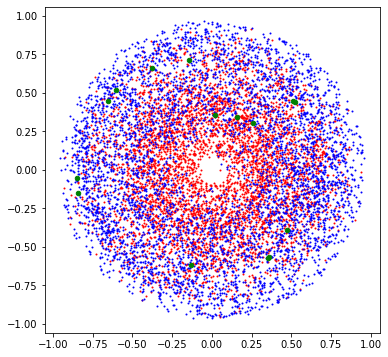


Epoch 6:  99%|█████████▉| 1012/1020 [08:36<00:04,  1.96it/s, loss=0.572, v_num=kt0p]

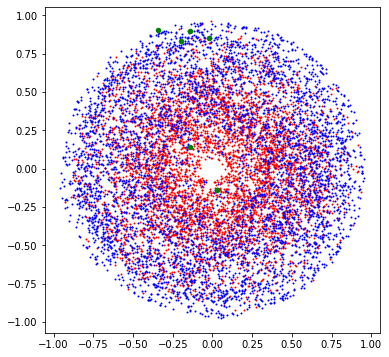


Epoch 6:  99%|█████████▉| 1013/1020 [08:45<00:03,  1.93it/s, loss=0.572, v_num=kt0p]

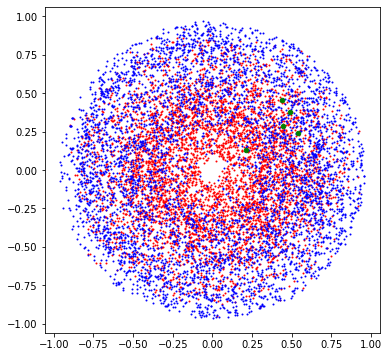


Epoch 6:  99%|█████████▉| 1014/1020 [08:54<00:03,  1.90it/s, loss=0.572, v_num=kt0p]

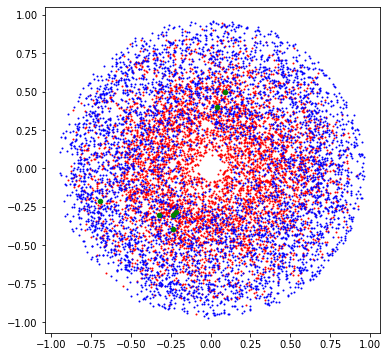


Epoch 6: 100%|█████████▉| 1015/1020 [09:05<00:02,  1.86it/s, loss=0.572, v_num=kt0p]

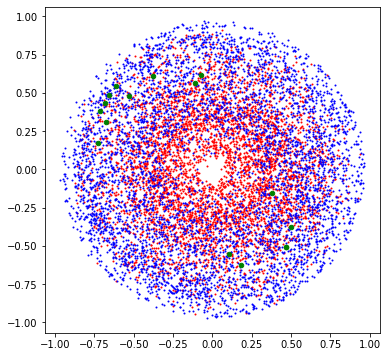


Epoch 6: 100%|█████████▉| 1016/1020 [09:13<00:02,  1.83it/s, loss=0.572, v_num=kt0p]

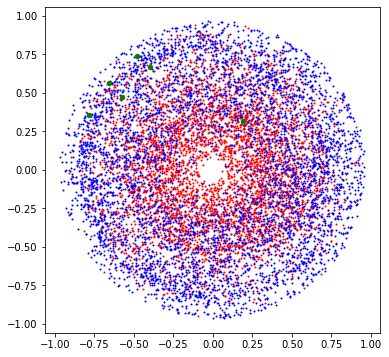


Epoch 6: 100%|█████████▉| 1017/1020 [09:22<00:01,  1.81it/s, loss=0.572, v_num=kt0p]

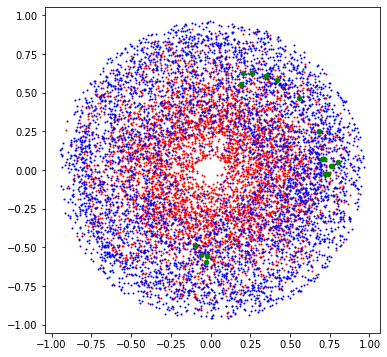


Epoch 6: 100%|█████████▉| 1018/1020 [09:31<00:01,  1.78it/s, loss=0.572, v_num=kt0p]

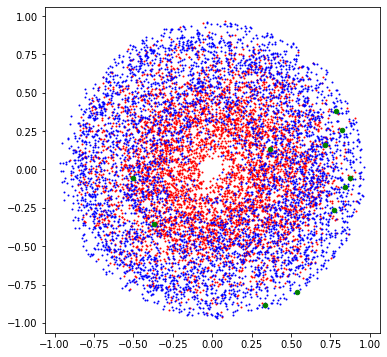


Epoch 6: 100%|█████████▉| 1019/1020 [09:40<00:00,  1.76it/s, loss=0.572, v_num=kt0p]

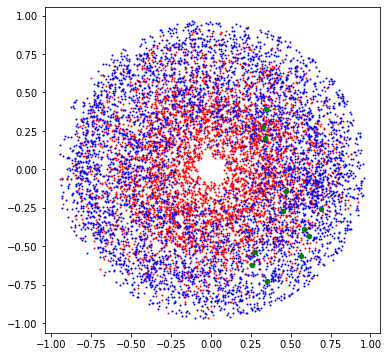


Epoch 6: 100%|██████████| 1020/1020 [09:49<00:00,  1.73it/s, loss=0.572, v_num=kt0p]

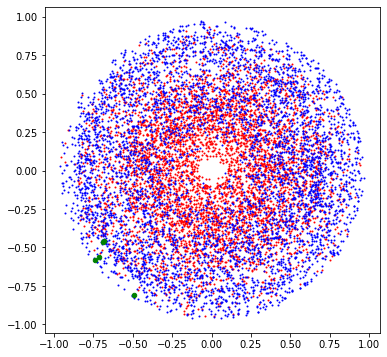


Epoch 7:  98%|█████████▊| 1000/1020 [06:56<00:08,  2.40it/s, loss=0.572, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

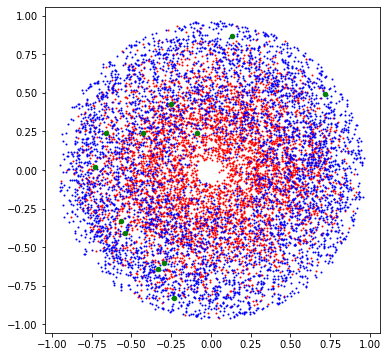


Epoch 7:  98%|█████████▊| 1002/1020 [07:08<00:07,  2.34it/s, loss=0.572, v_num=kt0p]

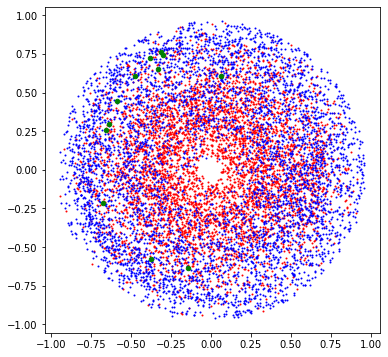


Epoch 7:  98%|█████████▊| 1003/1020 [07:17<00:07,  2.29it/s, loss=0.572, v_num=kt0p]

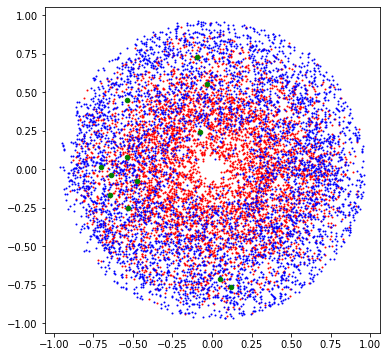


Epoch 7:  98%|█████████▊| 1004/1020 [07:25<00:07,  2.25it/s, loss=0.572, v_num=kt0p]

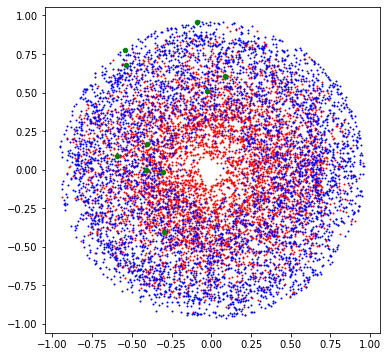


Epoch 7:  99%|█████████▊| 1005/1020 [07:33<00:06,  2.22it/s, loss=0.572, v_num=kt0p]

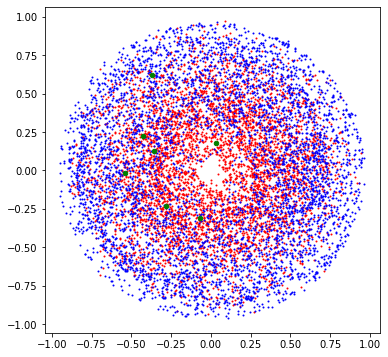


Epoch 7:  99%|█████████▊| 1006/1020 [07:44<00:06,  2.17it/s, loss=0.572, v_num=kt0p]

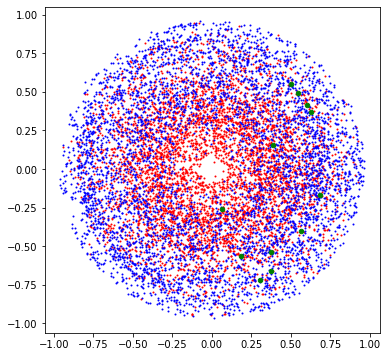


Epoch 7:  99%|█████████▊| 1007/1020 [07:53<00:06,  2.13it/s, loss=0.572, v_num=kt0p]

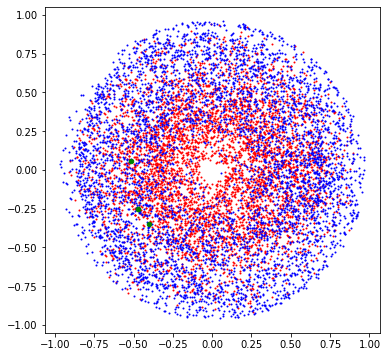


Epoch 7:  99%|█████████▉| 1008/1020 [08:01<00:05,  2.09it/s, loss=0.572, v_num=kt0p]

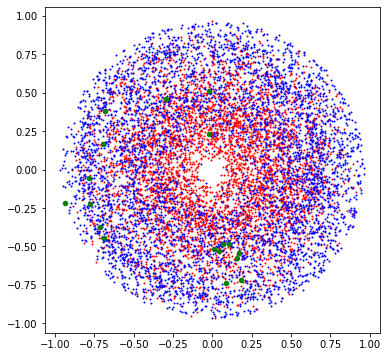


Epoch 7:  99%|█████████▉| 1009/1020 [08:09<00:05,  2.06it/s, loss=0.572, v_num=kt0p]

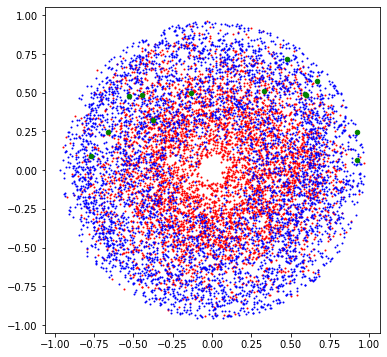


Epoch 7:  99%|█████████▉| 1010/1020 [08:18<00:04,  2.02it/s, loss=0.572, v_num=kt0p]

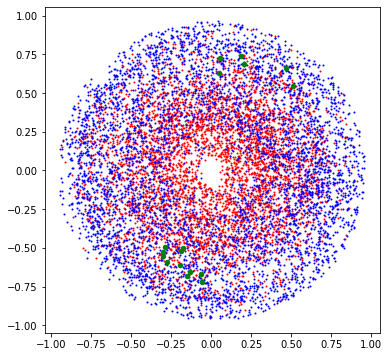


Epoch 7:  99%|█████████▉| 1011/1020 [08:27<00:04,  1.99it/s, loss=0.572, v_num=kt0p]

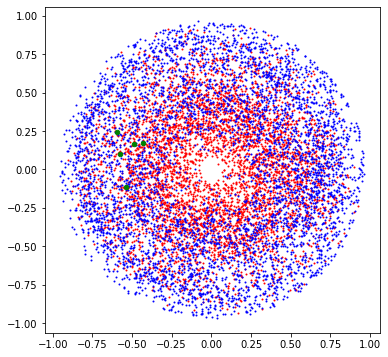


Epoch 7:  99%|█████████▉| 1012/1020 [08:38<00:04,  1.95it/s, loss=0.572, v_num=kt0p]

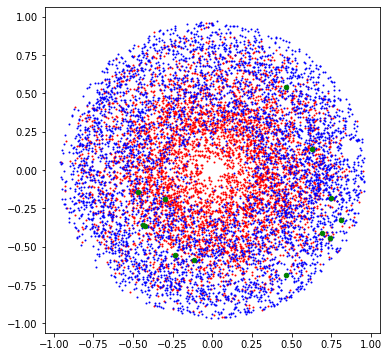


Epoch 7:  99%|█████████▉| 1013/1020 [08:47<00:03,  1.92it/s, loss=0.572, v_num=kt0p]

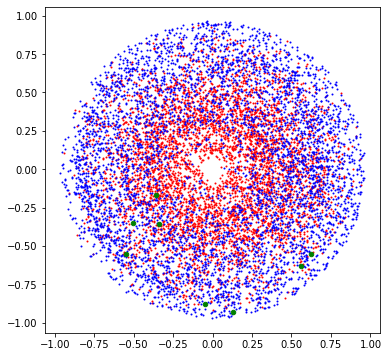


Epoch 7:  99%|█████████▉| 1014/1020 [08:56<00:03,  1.89it/s, loss=0.572, v_num=kt0p]

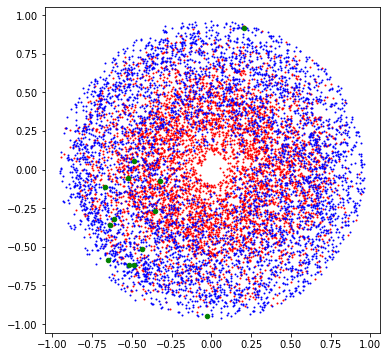


Epoch 7: 100%|█████████▉| 1015/1020 [09:07<00:02,  1.86it/s, loss=0.572, v_num=kt0p]

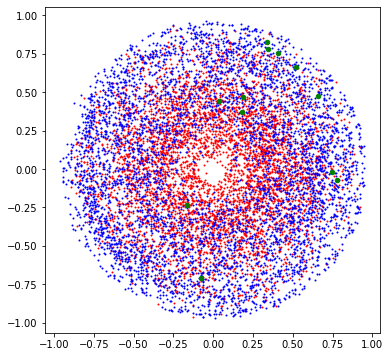


Epoch 7: 100%|█████████▉| 1016/1020 [09:15<00:02,  1.83it/s, loss=0.572, v_num=kt0p]

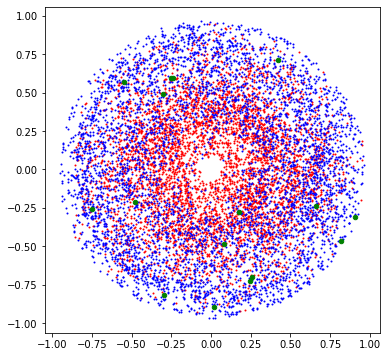


Epoch 7: 100%|█████████▉| 1017/1020 [09:24<00:01,  1.80it/s, loss=0.572, v_num=kt0p]

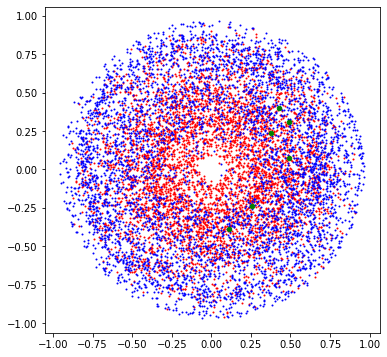


Epoch 7: 100%|█████████▉| 1018/1020 [09:33<00:01,  1.77it/s, loss=0.572, v_num=kt0p]

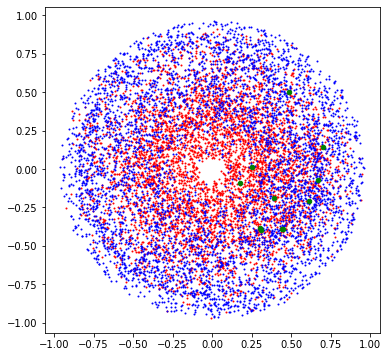


Epoch 7: 100%|█████████▉| 1019/1020 [09:42<00:00,  1.75it/s, loss=0.572, v_num=kt0p]

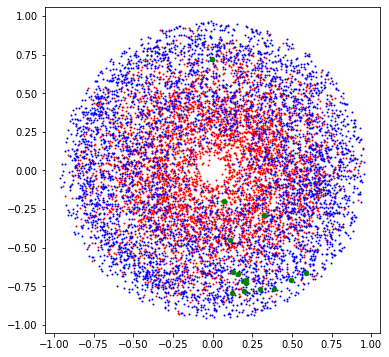


Epoch 7: 100%|██████████| 1020/1020 [09:51<00:00,  1.73it/s, loss=0.572, v_num=kt0p]

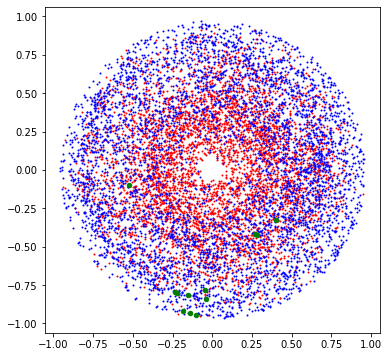


Epoch 8:  98%|█████████▊| 1000/1020 [06:59<00:08,  2.38it/s, loss=0.572, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

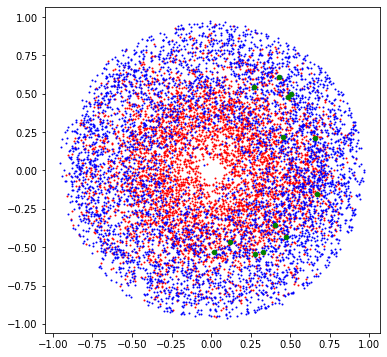


Epoch 8:  98%|█████████▊| 1002/1020 [07:11<00:07,  2.32it/s, loss=0.572, v_num=kt0p]

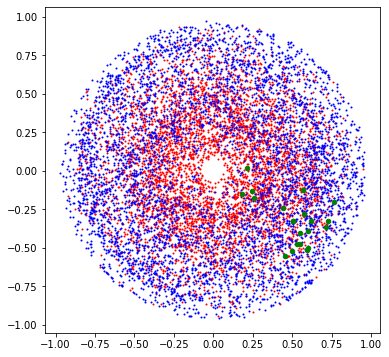


Epoch 8:  98%|█████████▊| 1003/1020 [07:20<00:07,  2.28it/s, loss=0.572, v_num=kt0p]

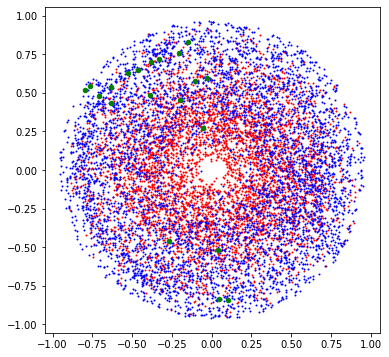


Epoch 8:  98%|█████████▊| 1004/1020 [07:28<00:07,  2.24it/s, loss=0.572, v_num=kt0p]

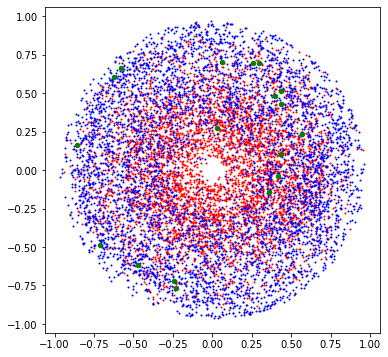


Epoch 8:  99%|█████████▊| 1005/1020 [07:36<00:06,  2.20it/s, loss=0.572, v_num=kt0p]

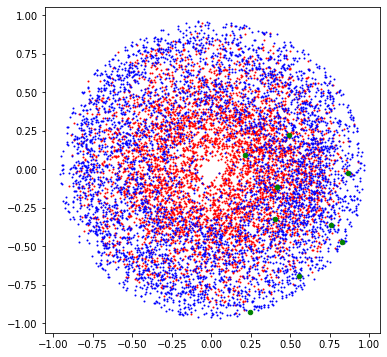


Epoch 8:  99%|█████████▊| 1006/1020 [07:47<00:06,  2.15it/s, loss=0.572, v_num=kt0p]

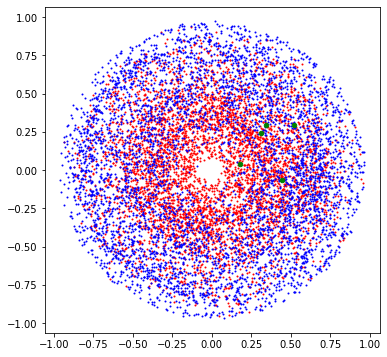


Epoch 8:  99%|█████████▊| 1007/1020 [07:55<00:06,  2.12it/s, loss=0.572, v_num=kt0p]

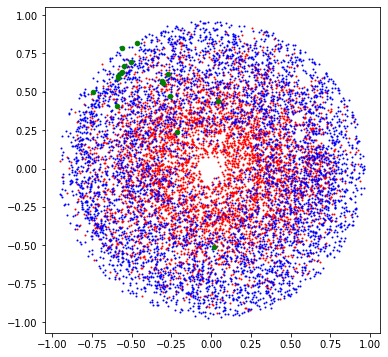


Epoch 8:  99%|█████████▉| 1008/1020 [08:04<00:05,  2.08it/s, loss=0.572, v_num=kt0p]

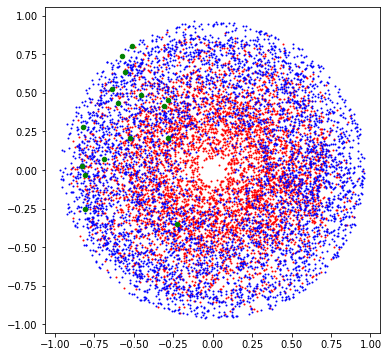


Epoch 8:  99%|█████████▉| 1009/1020 [08:12<00:05,  2.05it/s, loss=0.572, v_num=kt0p]

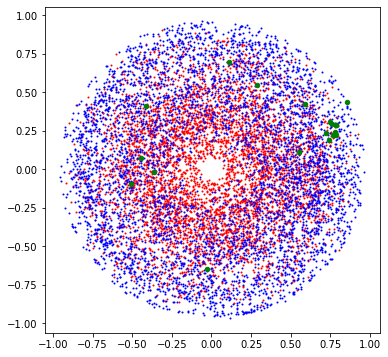


Epoch 8:  99%|█████████▉| 1010/1020 [08:21<00:04,  2.01it/s, loss=0.572, v_num=kt0p]

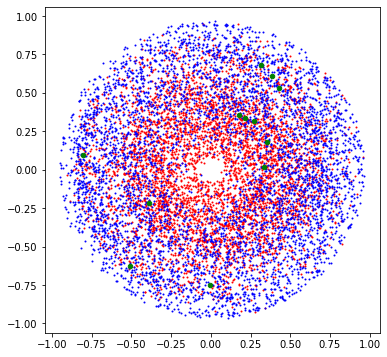


Epoch 8:  99%|█████████▉| 1011/1020 [08:30<00:04,  1.98it/s, loss=0.572, v_num=kt0p]

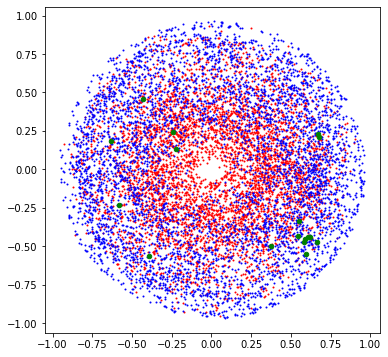


Epoch 8:  99%|█████████▉| 1012/1020 [08:41<00:04,  1.94it/s, loss=0.572, v_num=kt0p]

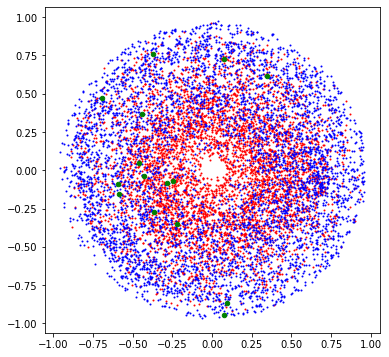


Epoch 8:  99%|█████████▉| 1013/1020 [08:50<00:03,  1.91it/s, loss=0.572, v_num=kt0p]

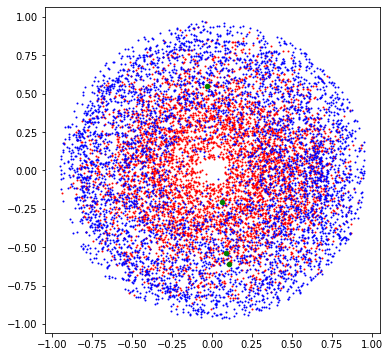


Epoch 8:  99%|█████████▉| 1014/1020 [09:00<00:03,  1.88it/s, loss=0.572, v_num=kt0p]

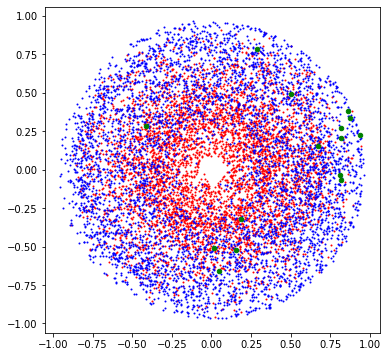


Epoch 8: 100%|█████████▉| 1015/1020 [09:10<00:02,  1.84it/s, loss=0.572, v_num=kt0p]

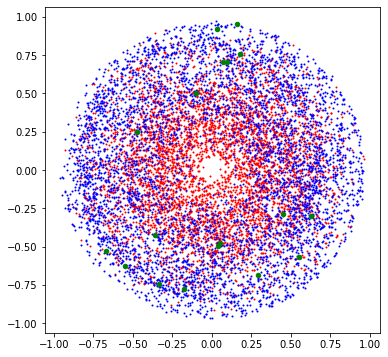


Epoch 8: 100%|█████████▉| 1016/1020 [09:19<00:02,  1.82it/s, loss=0.572, v_num=kt0p]

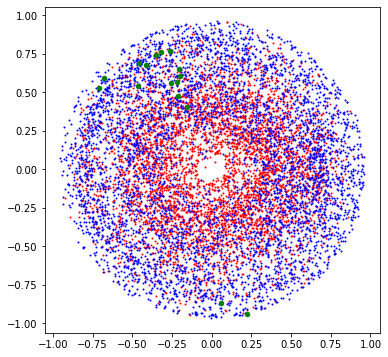


Epoch 8: 100%|█████████▉| 1017/1020 [09:28<00:01,  1.79it/s, loss=0.572, v_num=kt0p]

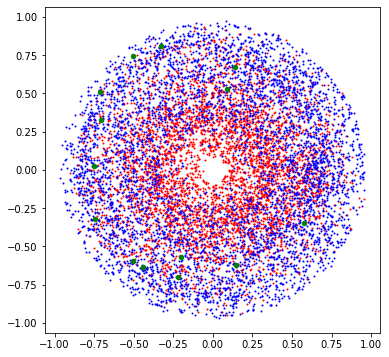


Epoch 8: 100%|█████████▉| 1018/1020 [09:37<00:01,  1.76it/s, loss=0.572, v_num=kt0p]

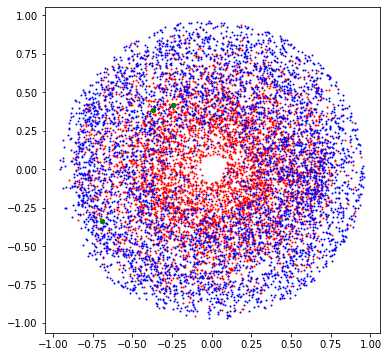


Epoch 8: 100%|█████████▉| 1019/1020 [09:46<00:00,  1.74it/s, loss=0.572, v_num=kt0p]

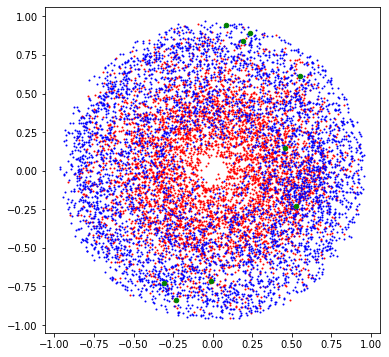


Epoch 8: 100%|██████████| 1020/1020 [09:55<00:00,  1.71it/s, loss=0.572, v_num=kt0p]

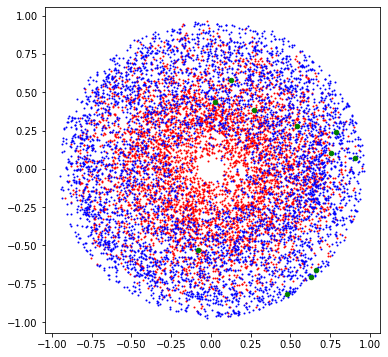


Epoch 9:  98%|█████████▊| 1000/1020 [07:07<00:08,  2.34it/s, loss=0.572, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

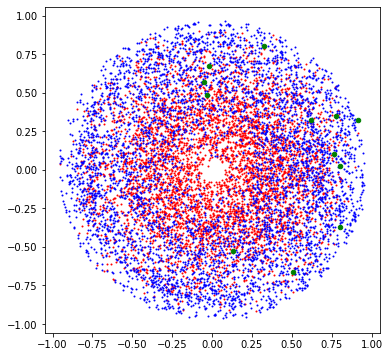


Epoch 9:  98%|█████████▊| 1002/1020 [07:18<00:07,  2.29it/s, loss=0.572, v_num=kt0p]

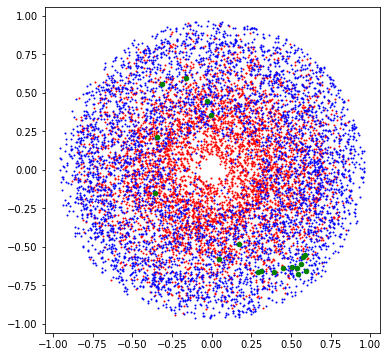


Epoch 9:  98%|█████████▊| 1003/1020 [07:27<00:07,  2.24it/s, loss=0.572, v_num=kt0p]

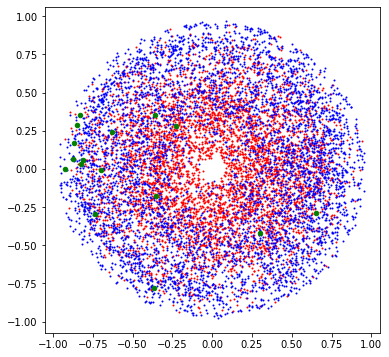


Epoch 9:  98%|█████████▊| 1004/1020 [07:35<00:07,  2.20it/s, loss=0.572, v_num=kt0p]

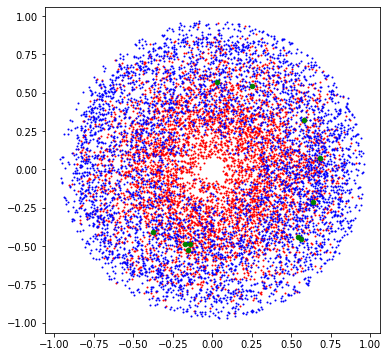


Epoch 9:  99%|█████████▊| 1005/1020 [07:43<00:06,  2.17it/s, loss=0.572, v_num=kt0p]

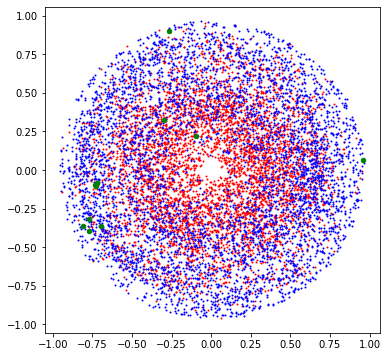


Epoch 9:  99%|█████████▊| 1006/1020 [07:53<00:06,  2.12it/s, loss=0.572, v_num=kt0p]

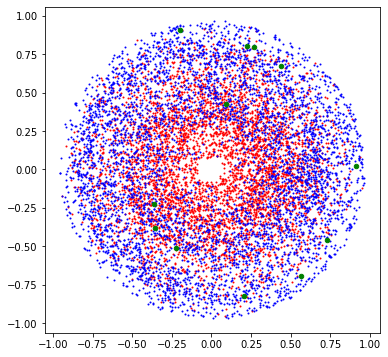


Epoch 9:  99%|█████████▊| 1007/1020 [08:02<00:06,  2.09it/s, loss=0.572, v_num=kt0p]

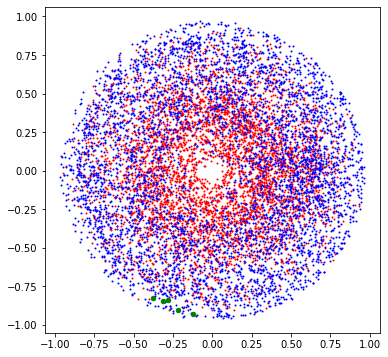


Epoch 9:  99%|█████████▉| 1008/1020 [08:10<00:05,  2.05it/s, loss=0.572, v_num=kt0p]

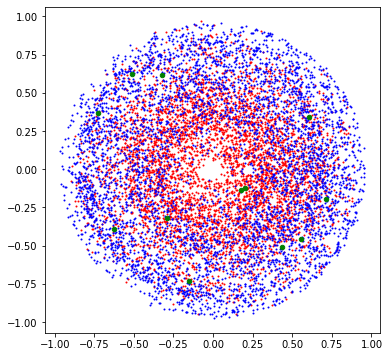


Epoch 9:  99%|█████████▉| 1009/1020 [08:18<00:05,  2.02it/s, loss=0.572, v_num=kt0p]

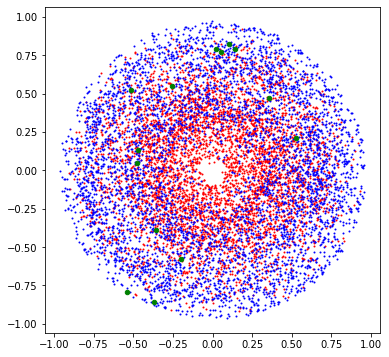


Epoch 9:  99%|█████████▉| 1010/1020 [08:27<00:05,  1.99it/s, loss=0.572, v_num=kt0p]

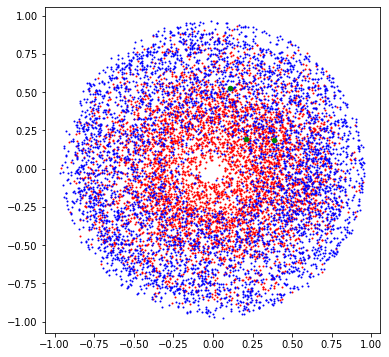


Epoch 9:  99%|█████████▉| 1011/1020 [08:37<00:04,  1.95it/s, loss=0.572, v_num=kt0p]

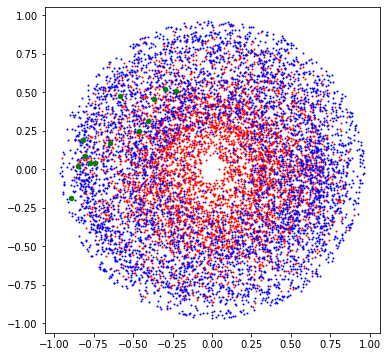


Epoch 9:  99%|█████████▉| 1012/1020 [08:47<00:04,  1.92it/s, loss=0.572, v_num=kt0p]

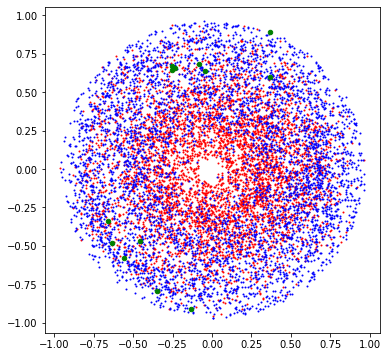


Epoch 9:  99%|█████████▉| 1013/1020 [08:57<00:03,  1.89it/s, loss=0.572, v_num=kt0p]

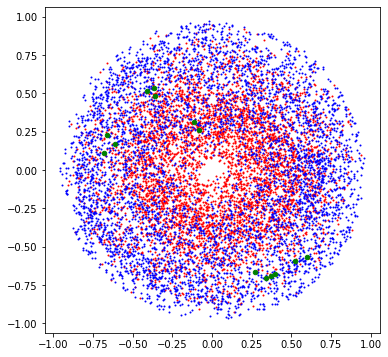


Epoch 9:  99%|█████████▉| 1014/1020 [09:06<00:03,  1.86it/s, loss=0.572, v_num=kt0p]

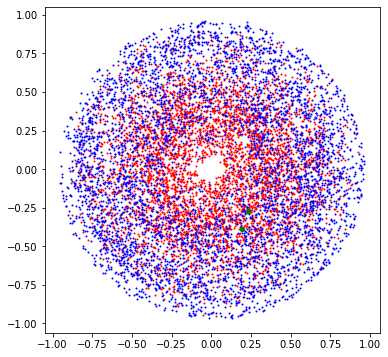


Epoch 9: 100%|█████████▉| 1015/1020 [09:17<00:02,  1.82it/s, loss=0.572, v_num=kt0p]

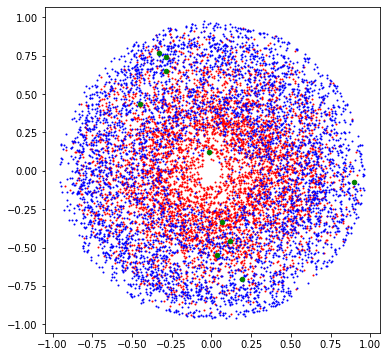


Epoch 9: 100%|█████████▉| 1016/1020 [09:25<00:02,  1.80it/s, loss=0.572, v_num=kt0p]

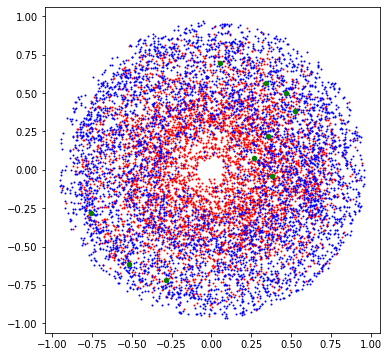


Epoch 9: 100%|█████████▉| 1017/1020 [09:34<00:01,  1.77it/s, loss=0.572, v_num=kt0p]

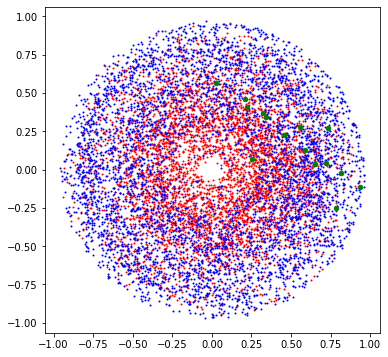


Epoch 9: 100%|█████████▉| 1018/1020 [09:43<00:01,  1.75it/s, loss=0.572, v_num=kt0p]

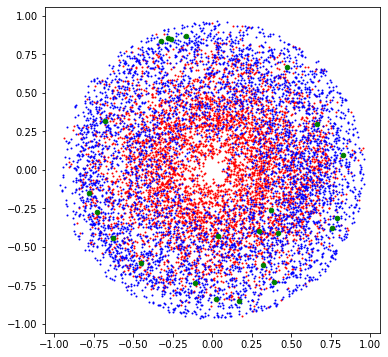


Epoch 9: 100%|█████████▉| 1019/1020 [09:51<00:00,  1.72it/s, loss=0.572, v_num=kt0p]

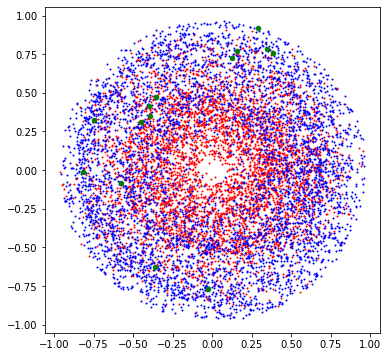


Epoch 9: 100%|██████████| 1020/1020 [10:00<00:00,  1.70it/s, loss=0.572, v_num=kt0p]

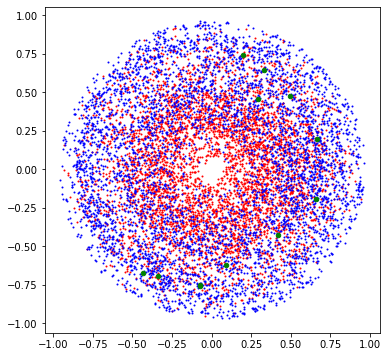


Epoch 10:  98%|█████████▊| 1000/1020 [06:49<00:08,  2.44it/s, loss=0.571, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

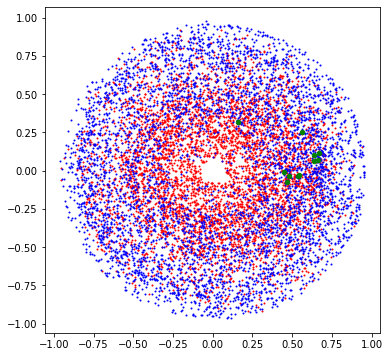


Epoch 10:  98%|█████████▊| 1002/1020 [07:00<00:07,  2.38it/s, loss=0.571, v_num=kt0p]

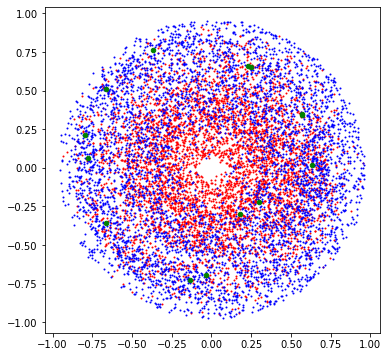


Epoch 10:  98%|█████████▊| 1003/1020 [07:09<00:07,  2.33it/s, loss=0.571, v_num=kt0p]

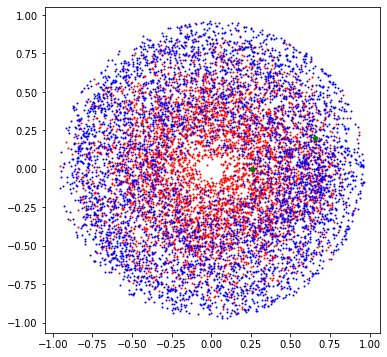


Epoch 10:  98%|█████████▊| 1004/1020 [07:17<00:06,  2.29it/s, loss=0.571, v_num=kt0p]

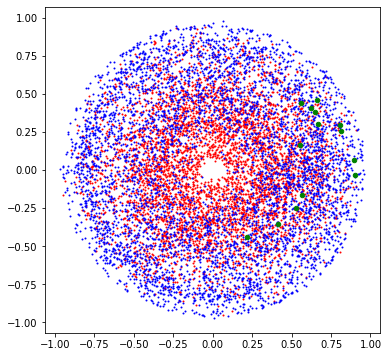


Epoch 10:  99%|█████████▊| 1005/1020 [07:25<00:06,  2.26it/s, loss=0.571, v_num=kt0p]

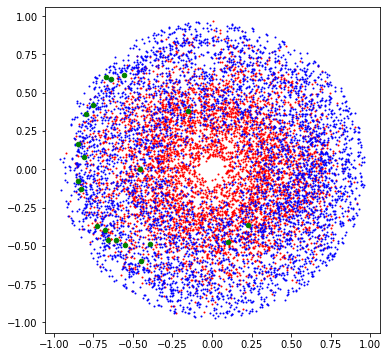


Epoch 10:  99%|█████████▊| 1006/1020 [07:35<00:06,  2.21it/s, loss=0.571, v_num=kt0p]

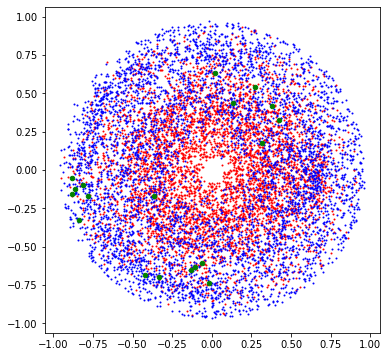


Epoch 10:  99%|█████████▊| 1007/1020 [07:44<00:05,  2.17it/s, loss=0.571, v_num=kt0p]

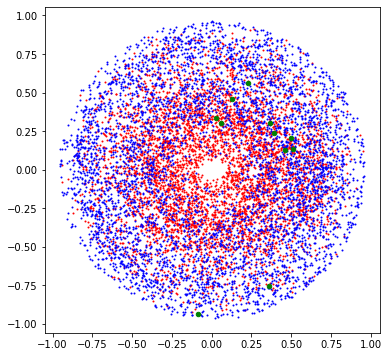


Epoch 10:  99%|█████████▉| 1008/1020 [07:52<00:05,  2.13it/s, loss=0.571, v_num=kt0p]

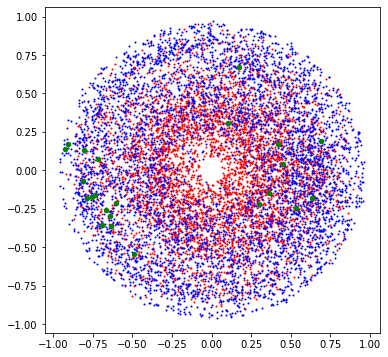


Epoch 10:  99%|█████████▉| 1009/1020 [08:00<00:05,  2.10it/s, loss=0.571, v_num=kt0p]

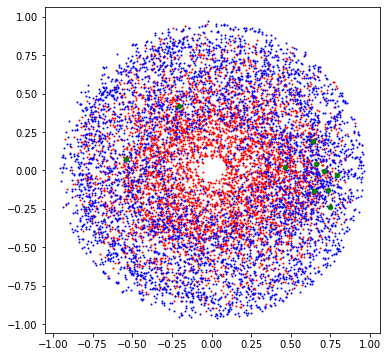


Epoch 10:  99%|█████████▉| 1010/1020 [08:09<00:04,  2.06it/s, loss=0.571, v_num=kt0p]

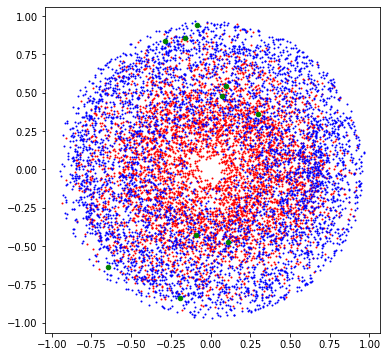


Epoch 10:  99%|█████████▉| 1011/1020 [08:17<00:04,  2.03it/s, loss=0.571, v_num=kt0p]

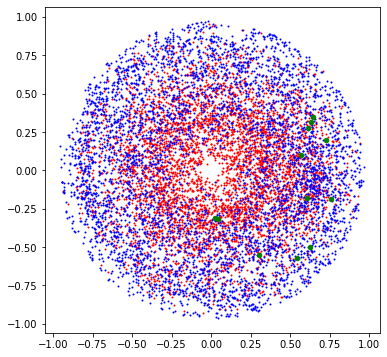


Epoch 10:  99%|█████████▉| 1012/1020 [08:28<00:04,  1.99it/s, loss=0.571, v_num=kt0p]

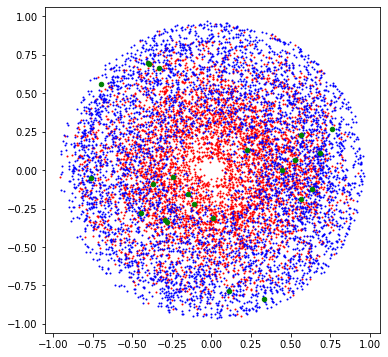


Epoch 10:  99%|█████████▉| 1013/1020 [08:37<00:03,  1.96it/s, loss=0.571, v_num=kt0p]

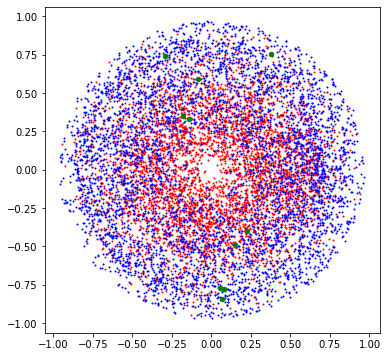


Epoch 10:  99%|█████████▉| 1014/1020 [08:46<00:03,  1.93it/s, loss=0.571, v_num=kt0p]

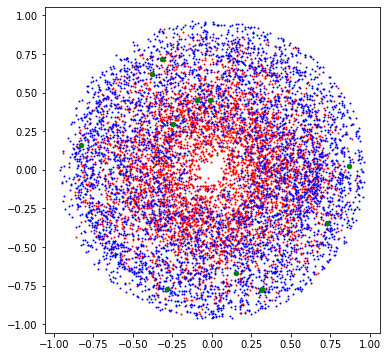


Epoch 10: 100%|█████████▉| 1015/1020 [08:56<00:02,  1.89it/s, loss=0.571, v_num=kt0p]

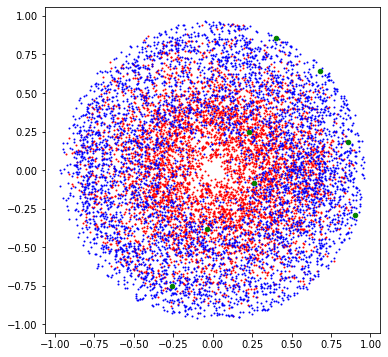


Epoch 10: 100%|█████████▉| 1016/1020 [09:05<00:02,  1.86it/s, loss=0.571, v_num=kt0p]

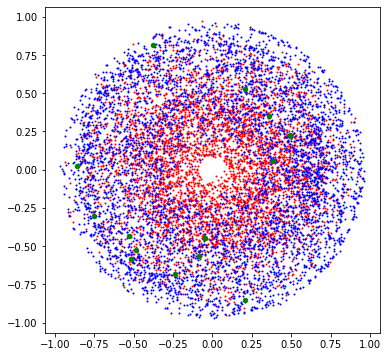


Epoch 10: 100%|█████████▉| 1017/1020 [09:13<00:01,  1.84it/s, loss=0.571, v_num=kt0p]

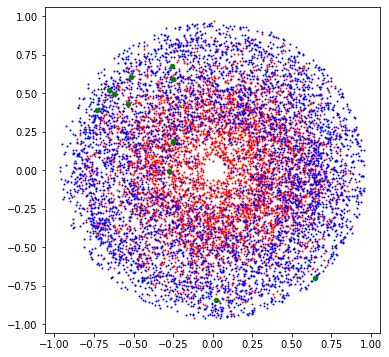


Epoch 10: 100%|█████████▉| 1018/1020 [09:22<00:01,  1.81it/s, loss=0.571, v_num=kt0p]

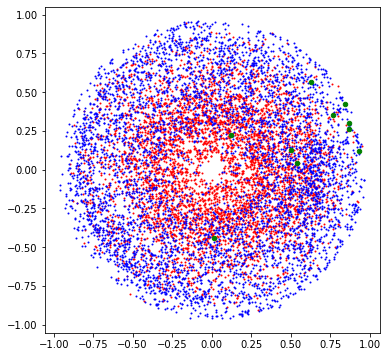


Epoch 10: 100%|█████████▉| 1019/1020 [09:31<00:00,  1.78it/s, loss=0.571, v_num=kt0p]

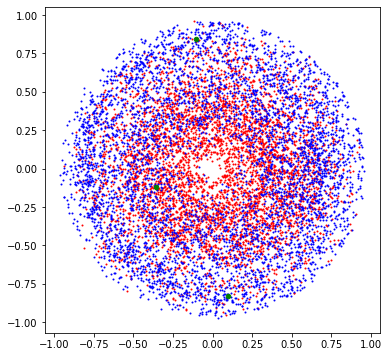


Epoch 10: 100%|██████████| 1020/1020 [09:40<00:00,  1.76it/s, loss=0.571, v_num=kt0p]

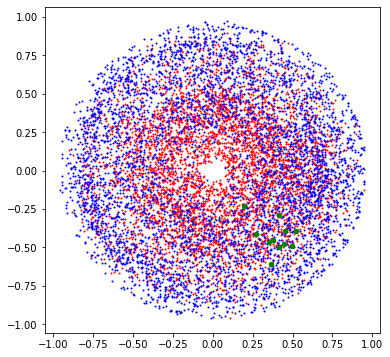


Epoch 11:  98%|█████████▊| 1000/1020 [06:54<00:08,  2.41it/s, loss=0.571, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

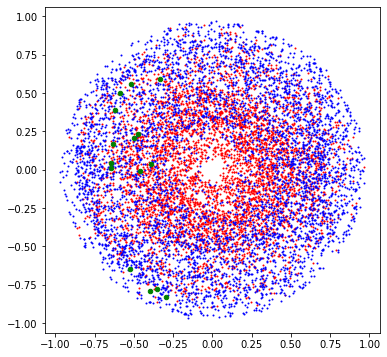


Epoch 11:  98%|█████████▊| 1002/1020 [07:06<00:07,  2.35it/s, loss=0.571, v_num=kt0p]

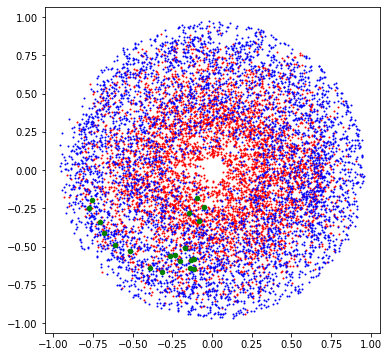


Epoch 11:  98%|█████████▊| 1003/1020 [07:15<00:07,  2.30it/s, loss=0.571, v_num=kt0p]

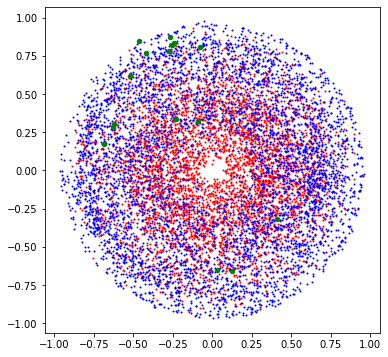


Epoch 11:  98%|█████████▊| 1004/1020 [07:23<00:07,  2.26it/s, loss=0.571, v_num=kt0p]

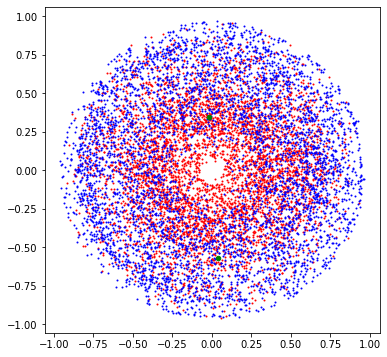


Epoch 11:  99%|█████████▊| 1005/1020 [07:31<00:06,  2.22it/s, loss=0.571, v_num=kt0p]

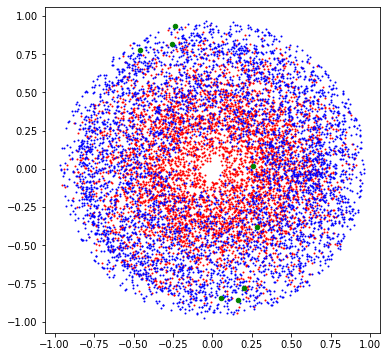


Epoch 11:  99%|█████████▊| 1006/1020 [07:41<00:06,  2.18it/s, loss=0.571, v_num=kt0p]

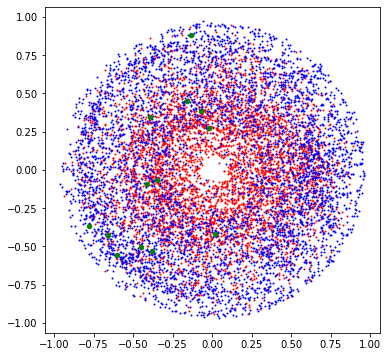


Epoch 11:  99%|█████████▊| 1007/1020 [07:50<00:06,  2.14it/s, loss=0.571, v_num=kt0p]

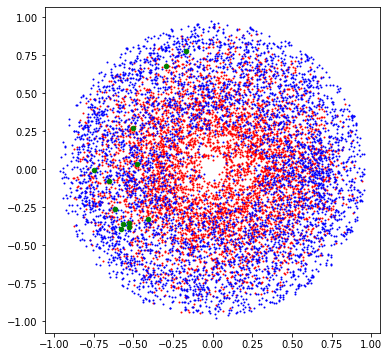


Epoch 11:  99%|█████████▉| 1008/1020 [07:59<00:05,  2.10it/s, loss=0.571, v_num=kt0p]

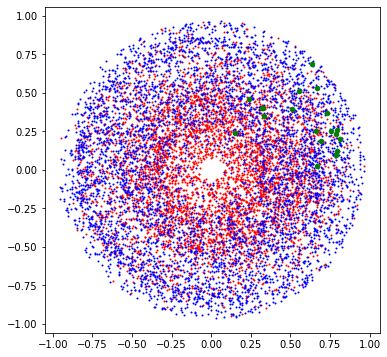


Epoch 11:  99%|█████████▉| 1009/1020 [08:07<00:05,  2.07it/s, loss=0.571, v_num=kt0p]

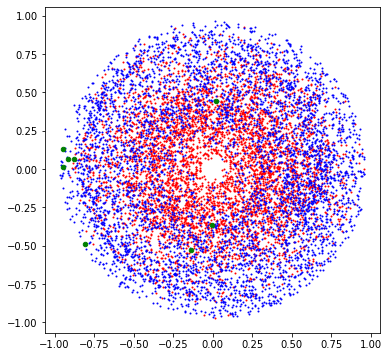


Epoch 11:  99%|█████████▉| 1010/1020 [08:16<00:04,  2.03it/s, loss=0.571, v_num=kt0p]

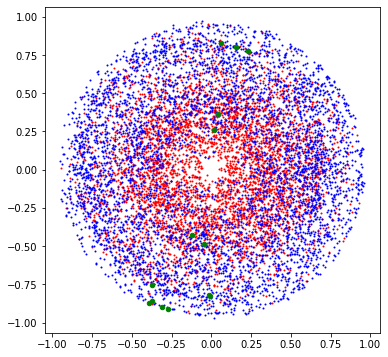


Epoch 11:  99%|█████████▉| 1011/1020 [08:24<00:04,  2.00it/s, loss=0.571, v_num=kt0p]

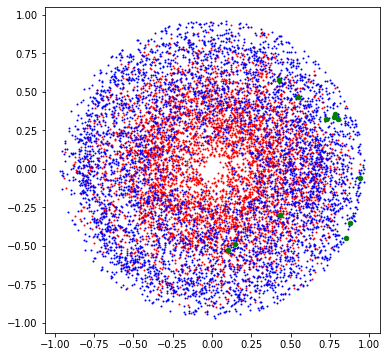


Epoch 11:  99%|█████████▉| 1012/1020 [08:35<00:04,  1.96it/s, loss=0.571, v_num=kt0p]

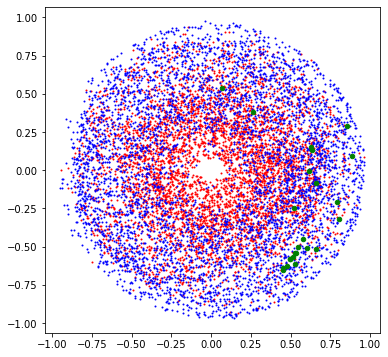


Epoch 11:  99%|█████████▉| 1013/1020 [08:43<00:03,  1.93it/s, loss=0.571, v_num=kt0p]

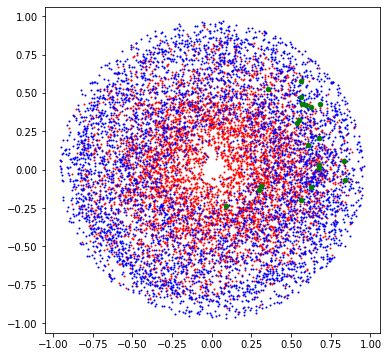


Epoch 11:  99%|█████████▉| 1014/1020 [08:53<00:03,  1.90it/s, loss=0.571, v_num=kt0p]

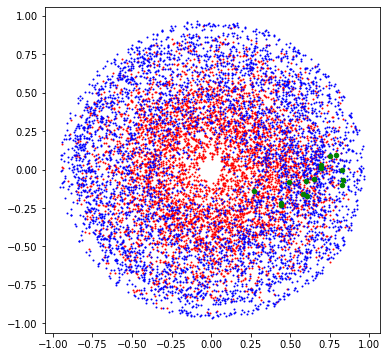


Epoch 11: 100%|█████████▉| 1015/1020 [09:03<00:02,  1.87it/s, loss=0.571, v_num=kt0p]

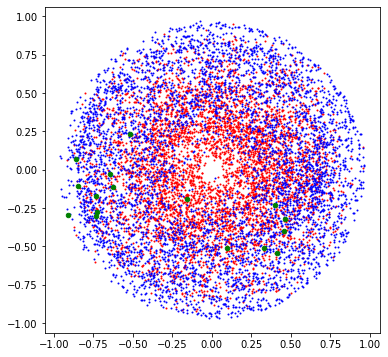


Epoch 11: 100%|█████████▉| 1016/1020 [09:12<00:02,  1.84it/s, loss=0.571, v_num=kt0p]

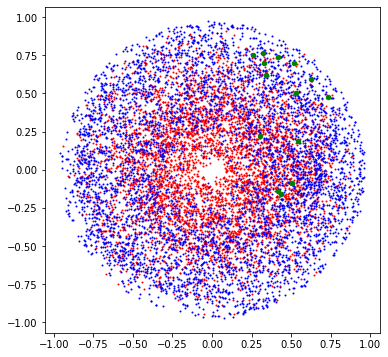


Epoch 11: 100%|█████████▉| 1017/1020 [09:20<00:01,  1.81it/s, loss=0.571, v_num=kt0p]

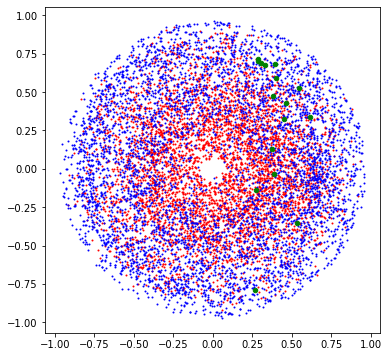


Epoch 11: 100%|█████████▉| 1018/1020 [09:30<00:01,  1.78it/s, loss=0.571, v_num=kt0p]

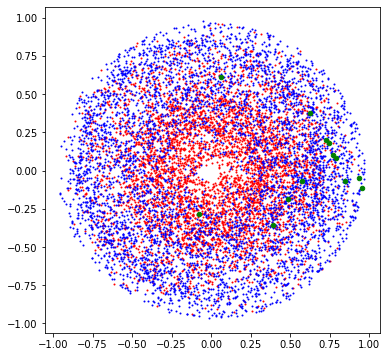


Epoch 11: 100%|█████████▉| 1019/1020 [09:38<00:00,  1.76it/s, loss=0.571, v_num=kt0p]

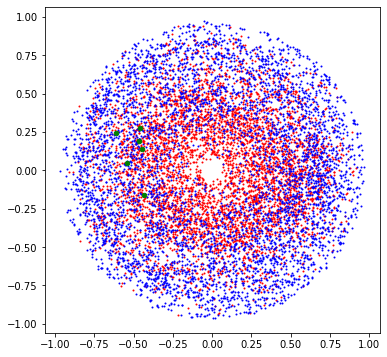


Epoch 11: 100%|██████████| 1020/1020 [09:47<00:00,  1.74it/s, loss=0.571, v_num=kt0p]

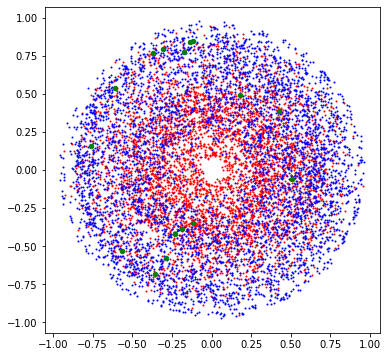


Epoch 12:  98%|█████████▊| 1000/1020 [06:57<00:08,  2.40it/s, loss=0.571, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

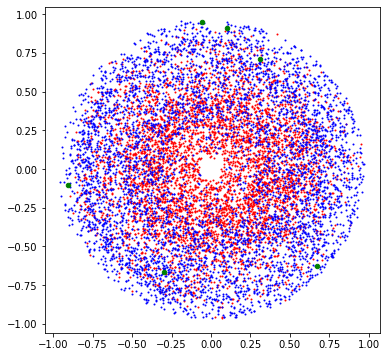


Epoch 12:  98%|█████████▊| 1002/1020 [07:08<00:07,  2.34it/s, loss=0.571, v_num=kt0p]

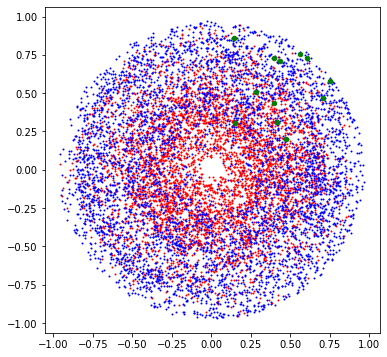


Epoch 12:  98%|█████████▊| 1003/1020 [07:17<00:07,  2.29it/s, loss=0.571, v_num=kt0p]

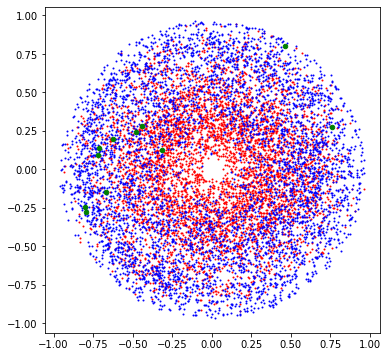


Epoch 12:  98%|█████████▊| 1004/1020 [07:25<00:07,  2.25it/s, loss=0.571, v_num=kt0p]

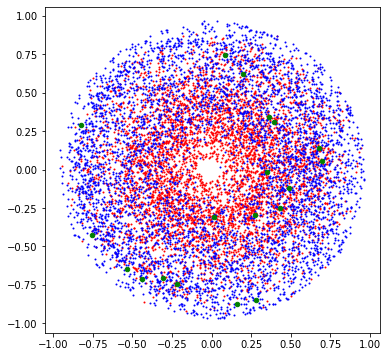


Epoch 12:  99%|█████████▊| 1005/1020 [07:33<00:06,  2.21it/s, loss=0.571, v_num=kt0p]

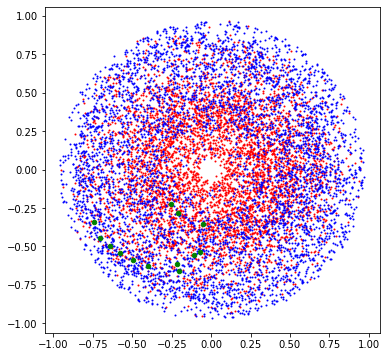


Epoch 12:  99%|█████████▊| 1006/1020 [07:43<00:06,  2.17it/s, loss=0.571, v_num=kt0p]

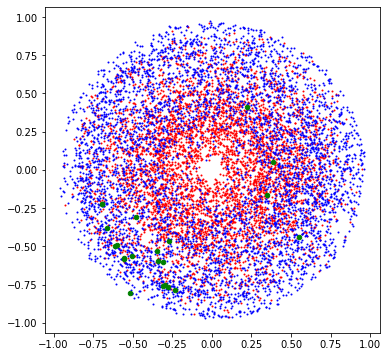


Epoch 12:  99%|█████████▊| 1007/1020 [07:52<00:06,  2.13it/s, loss=0.571, v_num=kt0p]

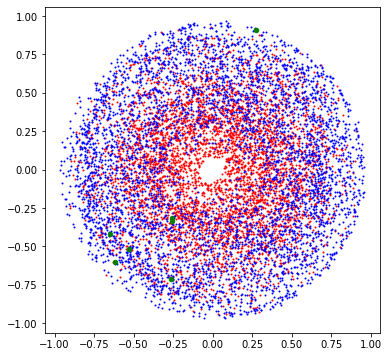


Epoch 12:  99%|█████████▉| 1008/1020 [08:01<00:05,  2.09it/s, loss=0.571, v_num=kt0p]

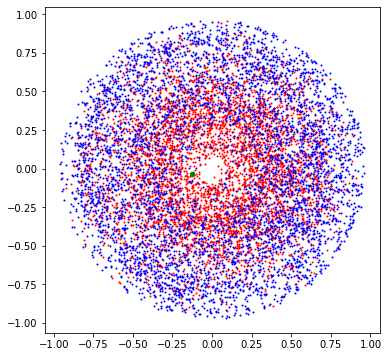


Epoch 12:  99%|█████████▉| 1009/1020 [08:09<00:05,  2.06it/s, loss=0.571, v_num=kt0p]

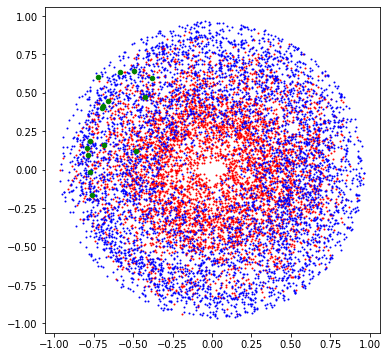


Epoch 12:  99%|█████████▉| 1010/1020 [08:19<00:04,  2.02it/s, loss=0.571, v_num=kt0p]

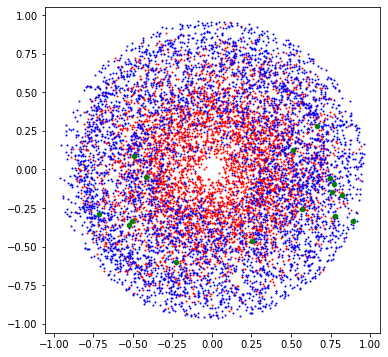


Epoch 12:  99%|█████████▉| 1011/1020 [08:27<00:04,  1.99it/s, loss=0.571, v_num=kt0p]

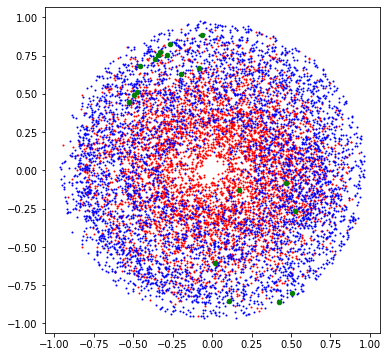


Epoch 12:  99%|█████████▉| 1012/1020 [08:38<00:04,  1.95it/s, loss=0.571, v_num=kt0p]

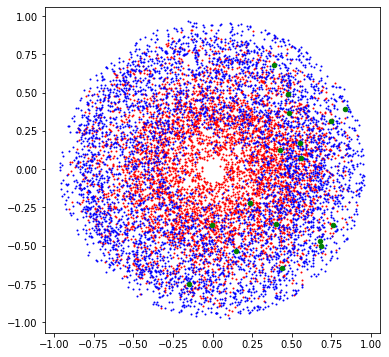


Epoch 12:  99%|█████████▉| 1013/1020 [08:47<00:03,  1.92it/s, loss=0.571, v_num=kt0p]

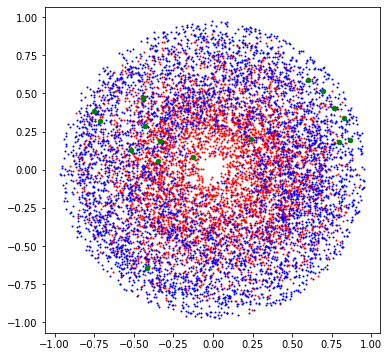


Epoch 12:  99%|█████████▉| 1014/1020 [08:56<00:03,  1.89it/s, loss=0.571, v_num=kt0p]

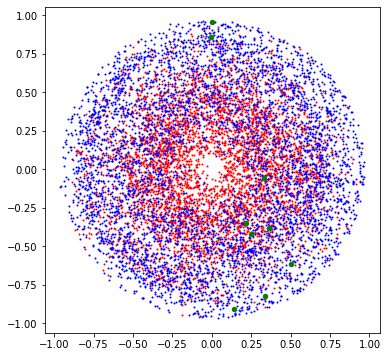


Epoch 12: 100%|█████████▉| 1015/1020 [09:07<00:02,  1.85it/s, loss=0.571, v_num=kt0p]

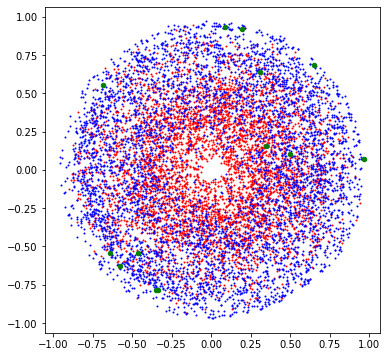


Epoch 12: 100%|█████████▉| 1016/1020 [09:15<00:02,  1.83it/s, loss=0.571, v_num=kt0p]

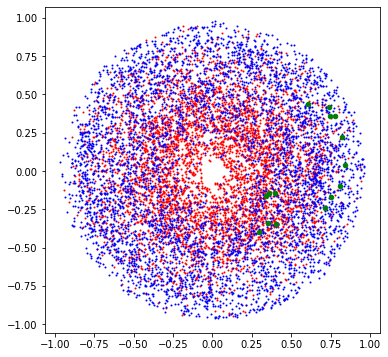


Epoch 12: 100%|█████████▉| 1017/1020 [09:24<00:01,  1.80it/s, loss=0.571, v_num=kt0p]

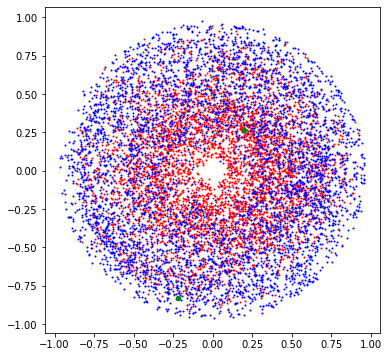


Epoch 12: 100%|█████████▉| 1018/1020 [09:33<00:01,  1.78it/s, loss=0.571, v_num=kt0p]

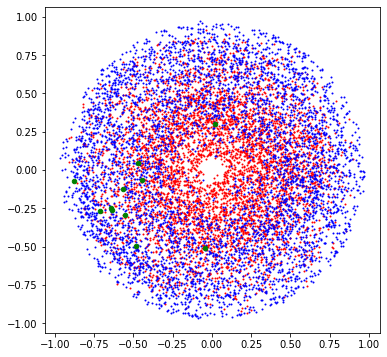


Epoch 12: 100%|█████████▉| 1019/1020 [09:41<00:00,  1.75it/s, loss=0.571, v_num=kt0p]

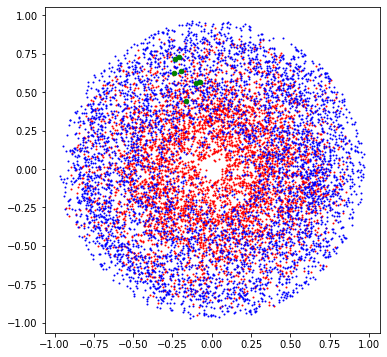


Epoch 12: 100%|██████████| 1020/1020 [09:50<00:00,  1.73it/s, loss=0.571, v_num=kt0p]

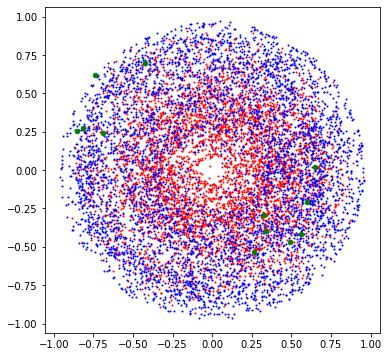


Epoch 13:  98%|█████████▊| 1000/1020 [06:56<00:08,  2.40it/s, loss=0.57, v_num=kt0p] 
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

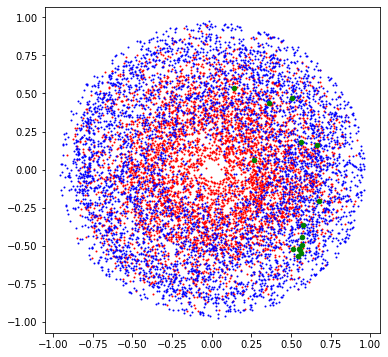


Epoch 13:  98%|█████████▊| 1002/1020 [07:08<00:07,  2.34it/s, loss=0.57, v_num=kt0p]

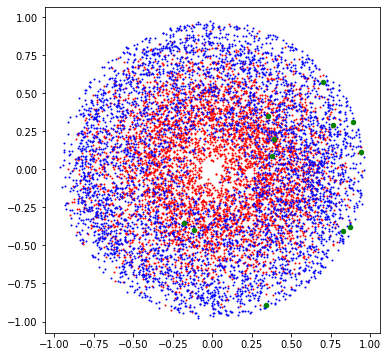


Epoch 13:  98%|█████████▊| 1003/1020 [07:17<00:07,  2.29it/s, loss=0.57, v_num=kt0p]

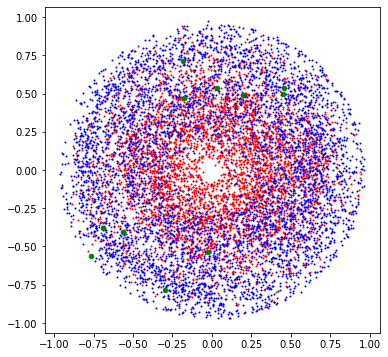


Epoch 13:  98%|█████████▊| 1004/1020 [07:25<00:07,  2.25it/s, loss=0.57, v_num=kt0p]

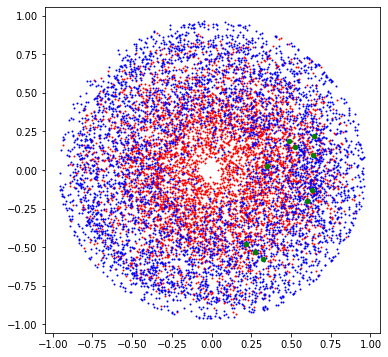


Epoch 13:  99%|█████████▊| 1005/1020 [07:33<00:06,  2.22it/s, loss=0.57, v_num=kt0p]

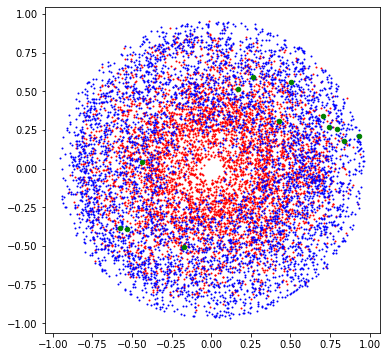


Epoch 13:  99%|█████████▊| 1006/1020 [07:43<00:06,  2.17it/s, loss=0.57, v_num=kt0p]

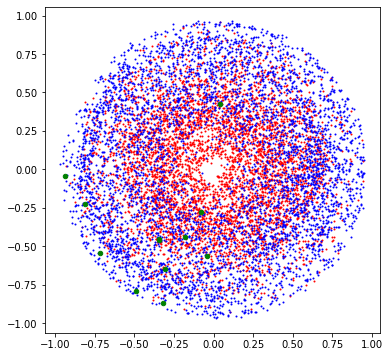


Epoch 13:  99%|█████████▊| 1007/1020 [07:52<00:06,  2.13it/s, loss=0.57, v_num=kt0p]

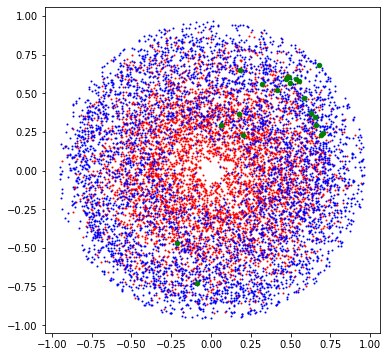


Epoch 13:  99%|█████████▉| 1008/1020 [08:00<00:05,  2.10it/s, loss=0.57, v_num=kt0p]

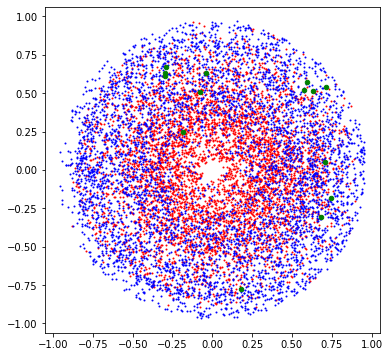


Epoch 13:  99%|█████████▉| 1009/1020 [08:07<00:05,  2.07it/s, loss=0.57, v_num=kt0p]

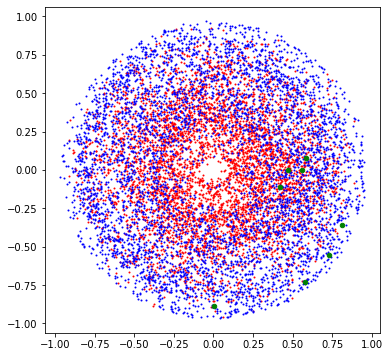


Epoch 13:  99%|█████████▉| 1010/1020 [08:17<00:04,  2.03it/s, loss=0.57, v_num=kt0p]

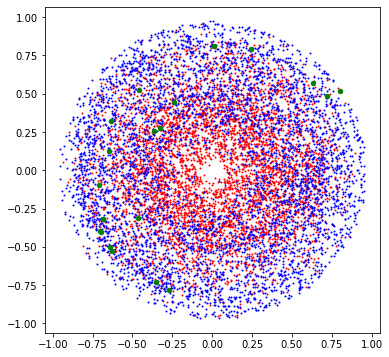


Epoch 13:  99%|█████████▉| 1011/1020 [08:25<00:04,  2.00it/s, loss=0.57, v_num=kt0p]

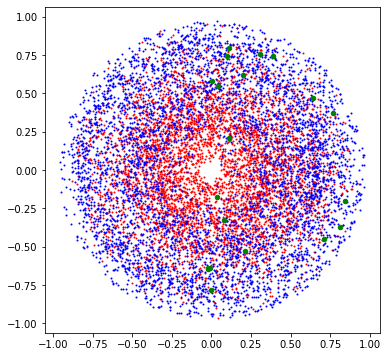


Epoch 13:  99%|█████████▉| 1012/1020 [08:35<00:04,  1.96it/s, loss=0.57, v_num=kt0p]

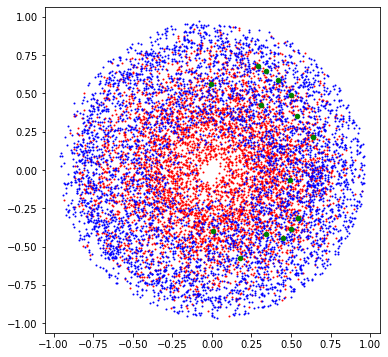


Epoch 13:  99%|█████████▉| 1013/1020 [08:44<00:03,  1.93it/s, loss=0.57, v_num=kt0p]

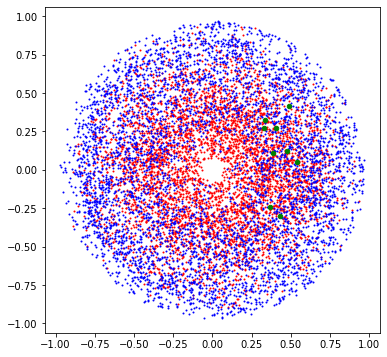


Epoch 13:  99%|█████████▉| 1014/1020 [08:53<00:03,  1.90it/s, loss=0.57, v_num=kt0p]

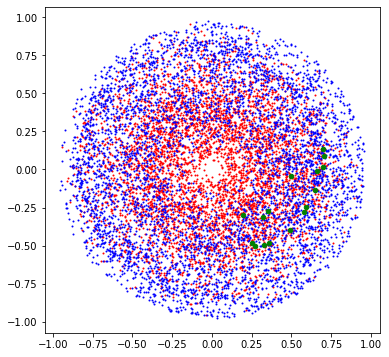


Epoch 13: 100%|█████████▉| 1015/1020 [09:04<00:02,  1.86it/s, loss=0.57, v_num=kt0p]

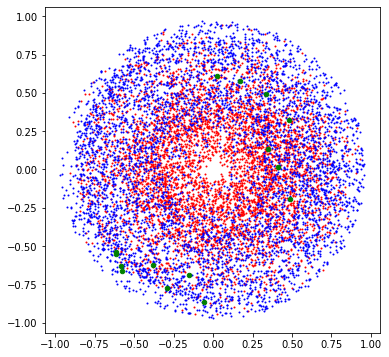


Epoch 13: 100%|█████████▉| 1016/1020 [09:13<00:02,  1.84it/s, loss=0.57, v_num=kt0p]

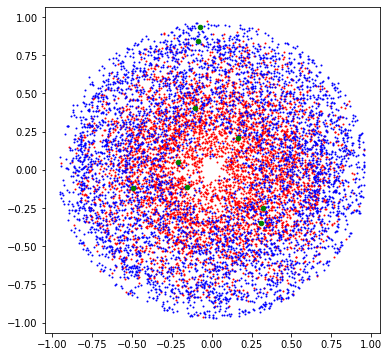


Epoch 13: 100%|█████████▉| 1017/1020 [09:21<00:01,  1.81it/s, loss=0.57, v_num=kt0p]

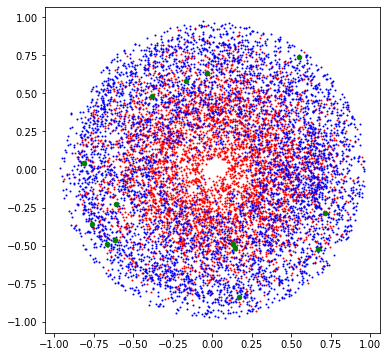


Epoch 13: 100%|█████████▉| 1018/1020 [09:30<00:01,  1.78it/s, loss=0.57, v_num=kt0p]

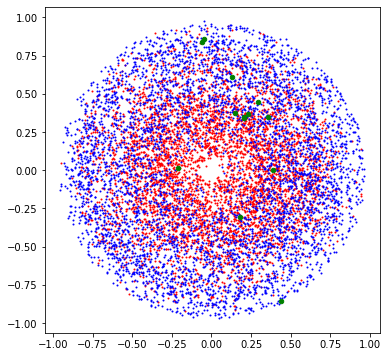


Epoch 13: 100%|█████████▉| 1019/1020 [09:39<00:00,  1.76it/s, loss=0.57, v_num=kt0p]

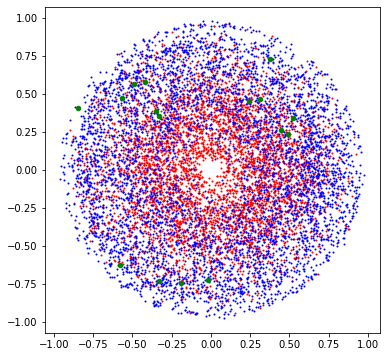


Epoch 13: 100%|██████████| 1020/1020 [09:47<00:00,  1.74it/s, loss=0.57, v_num=kt0p]

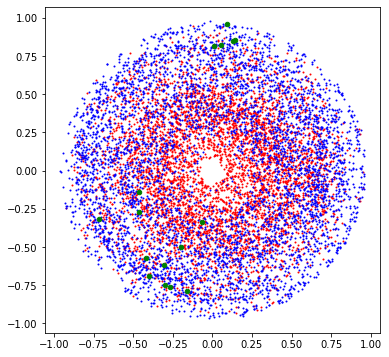


Epoch 14:  98%|█████████▊| 1000/1020 [07:02<00:08,  2.36it/s, loss=0.57, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

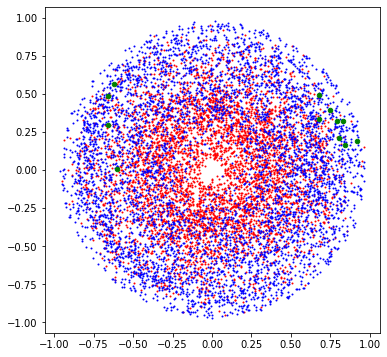


Epoch 14:  98%|█████████▊| 1002/1020 [07:14<00:07,  2.31it/s, loss=0.57, v_num=kt0p]

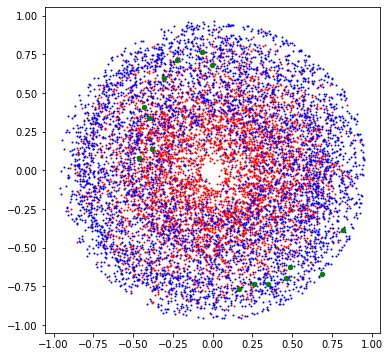


Epoch 14:  98%|█████████▊| 1003/1020 [07:23<00:07,  2.26it/s, loss=0.57, v_num=kt0p]

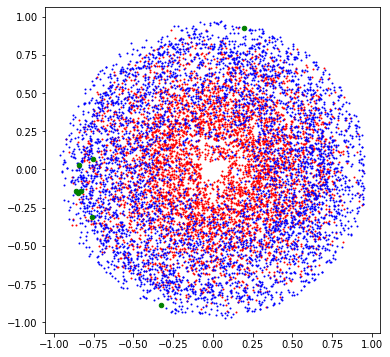


Epoch 14:  98%|█████████▊| 1004/1020 [07:31<00:07,  2.22it/s, loss=0.57, v_num=kt0p]

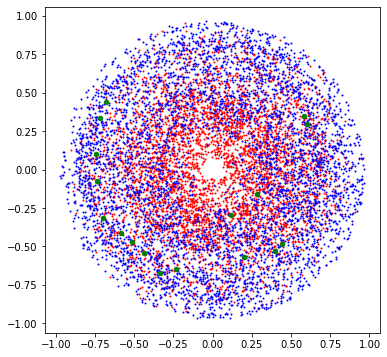


Epoch 14:  99%|█████████▊| 1005/1020 [07:39<00:06,  2.19it/s, loss=0.57, v_num=kt0p]

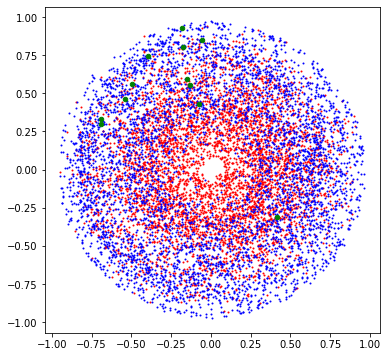


Epoch 14:  99%|█████████▊| 1006/1020 [07:49<00:06,  2.14it/s, loss=0.57, v_num=kt0p]

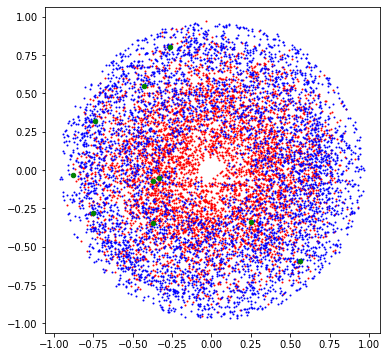


Epoch 14:  99%|█████████▊| 1007/1020 [07:57<00:06,  2.11it/s, loss=0.57, v_num=kt0p]

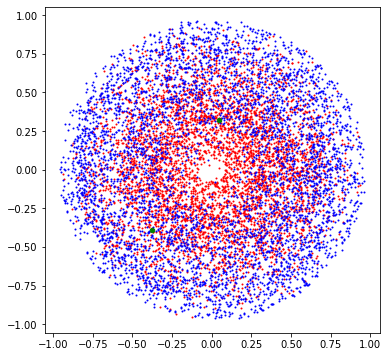


Epoch 14:  99%|█████████▉| 1008/1020 [08:06<00:05,  2.07it/s, loss=0.57, v_num=kt0p]

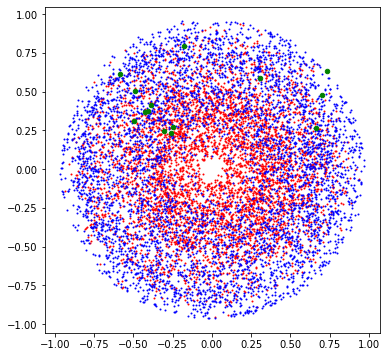


Epoch 14:  99%|█████████▉| 1009/1020 [08:13<00:05,  2.04it/s, loss=0.57, v_num=kt0p]

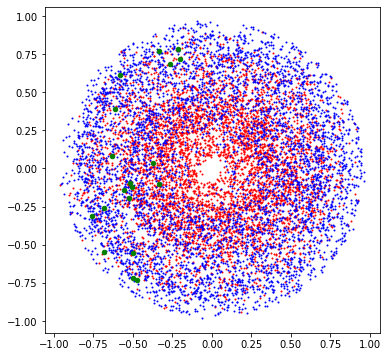


Epoch 14:  99%|█████████▉| 1010/1020 [08:22<00:04,  2.01it/s, loss=0.57, v_num=kt0p]

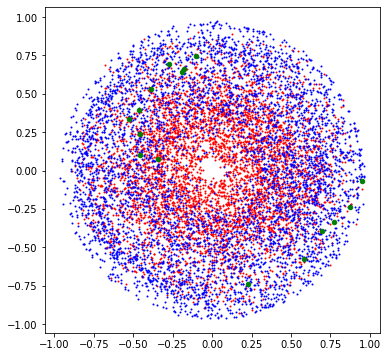


Epoch 14:  99%|█████████▉| 1011/1020 [08:30<00:04,  1.98it/s, loss=0.57, v_num=kt0p]

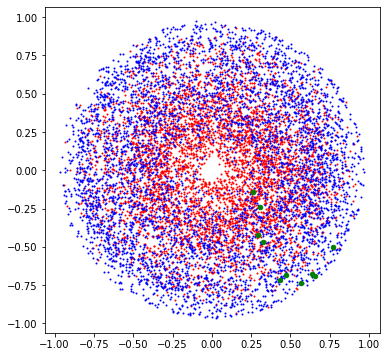


Epoch 14:  99%|█████████▉| 1012/1020 [08:41<00:04,  1.94it/s, loss=0.57, v_num=kt0p]

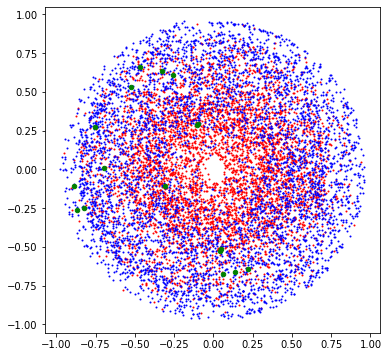


Epoch 14:  99%|█████████▉| 1013/1020 [08:50<00:03,  1.91it/s, loss=0.57, v_num=kt0p]

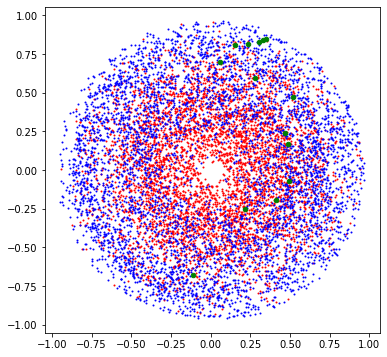


Epoch 14:  99%|█████████▉| 1014/1020 [08:59<00:03,  1.88it/s, loss=0.57, v_num=kt0p]

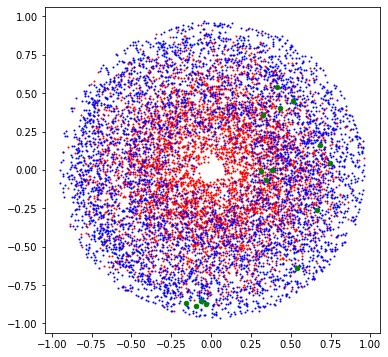


Epoch 14: 100%|█████████▉| 1015/1020 [09:10<00:02,  1.84it/s, loss=0.57, v_num=kt0p]

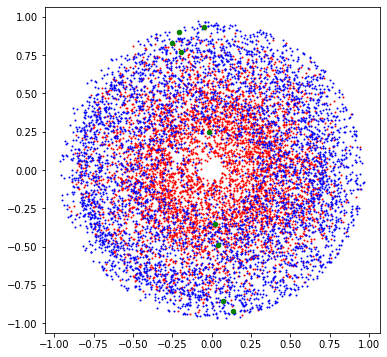


Epoch 14: 100%|█████████▉| 1016/1020 [09:18<00:02,  1.82it/s, loss=0.57, v_num=kt0p]

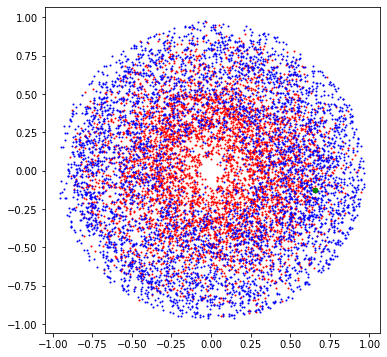


Epoch 14: 100%|█████████▉| 1017/1020 [09:26<00:01,  1.79it/s, loss=0.57, v_num=kt0p]

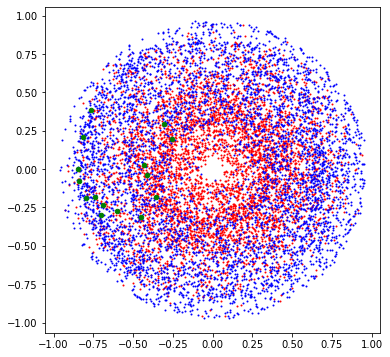


Epoch 14: 100%|█████████▉| 1018/1020 [09:36<00:01,  1.77it/s, loss=0.57, v_num=kt0p]

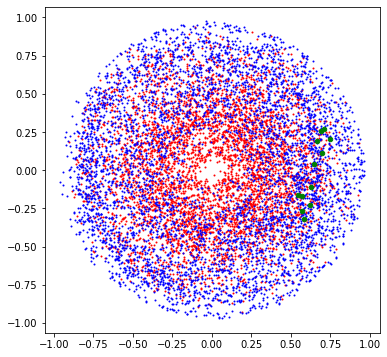


Epoch 14: 100%|█████████▉| 1019/1020 [09:44<00:00,  1.74it/s, loss=0.57, v_num=kt0p]

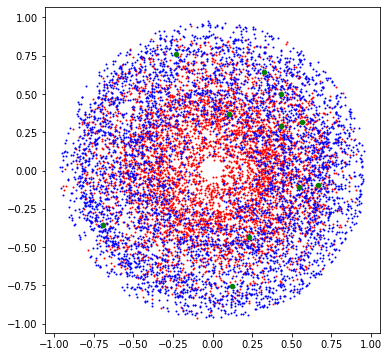


Epoch 14: 100%|██████████| 1020/1020 [09:53<00:00,  1.72it/s, loss=0.57, v_num=kt0p]

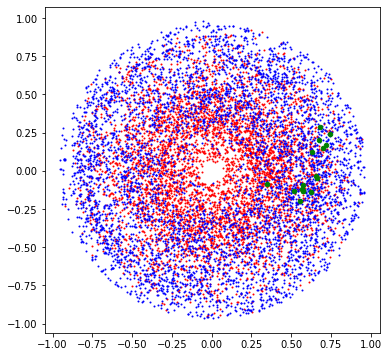


Epoch 15:  98%|█████████▊| 1000/1020 [07:01<00:08,  2.37it/s, loss=0.569, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

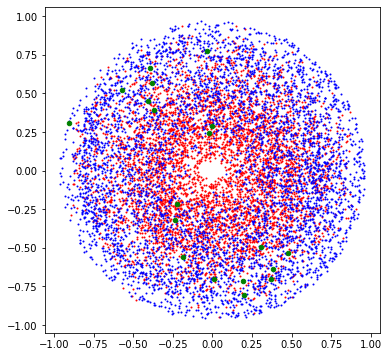


Epoch 15:  98%|█████████▊| 1002/1020 [07:12<00:07,  2.31it/s, loss=0.569, v_num=kt0p]

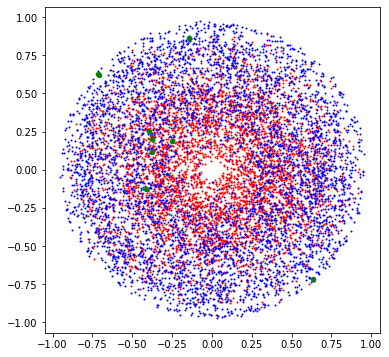


Epoch 15:  98%|█████████▊| 1003/1020 [07:21<00:07,  2.27it/s, loss=0.569, v_num=kt0p]

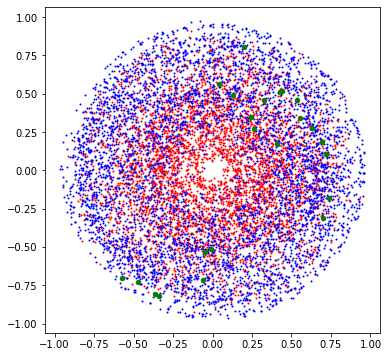


Epoch 15:  98%|█████████▊| 1004/1020 [07:30<00:07,  2.23it/s, loss=0.569, v_num=kt0p]

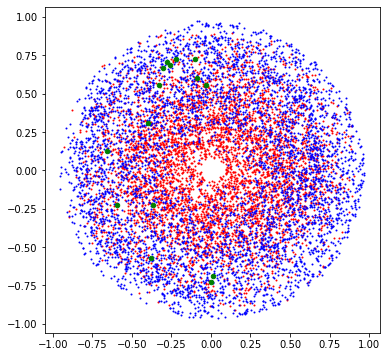


Epoch 15:  99%|█████████▊| 1005/1020 [07:37<00:06,  2.20it/s, loss=0.569, v_num=kt0p]

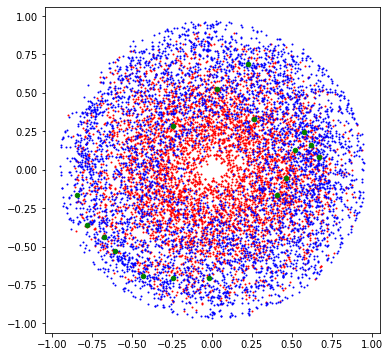


Epoch 15:  99%|█████████▊| 1006/1020 [07:47<00:06,  2.15it/s, loss=0.569, v_num=kt0p]

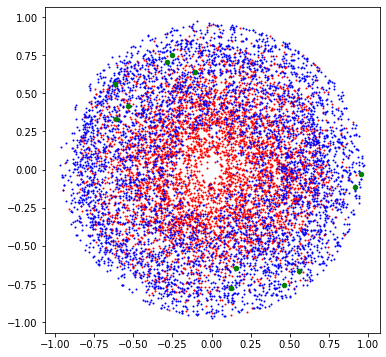


Epoch 15:  99%|█████████▊| 1007/1020 [07:56<00:06,  2.11it/s, loss=0.569, v_num=kt0p]

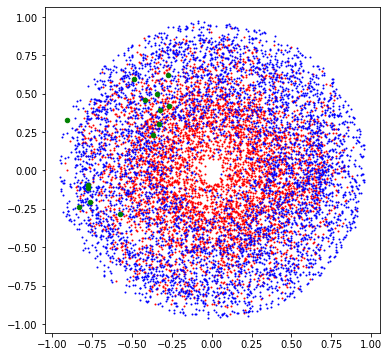


Epoch 15:  99%|█████████▉| 1008/1020 [08:05<00:05,  2.08it/s, loss=0.569, v_num=kt0p]

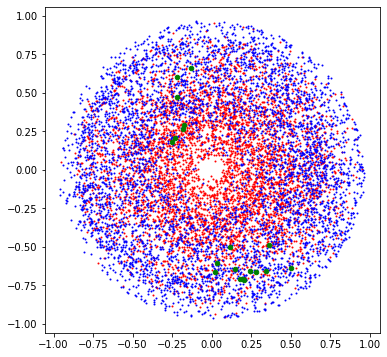


Epoch 15:  99%|█████████▉| 1009/1020 [08:12<00:05,  2.05it/s, loss=0.569, v_num=kt0p]

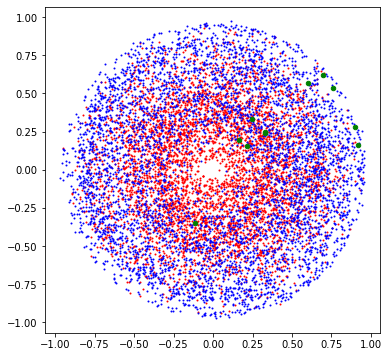


Epoch 15:  99%|█████████▉| 1010/1020 [08:21<00:04,  2.01it/s, loss=0.569, v_num=kt0p]

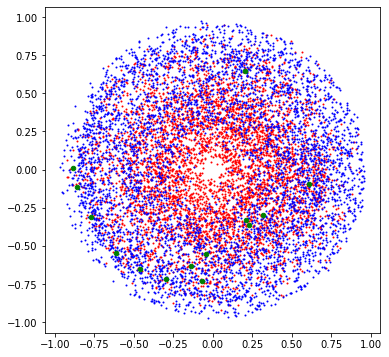


Epoch 15:  99%|█████████▉| 1011/1020 [08:30<00:04,  1.98it/s, loss=0.569, v_num=kt0p]

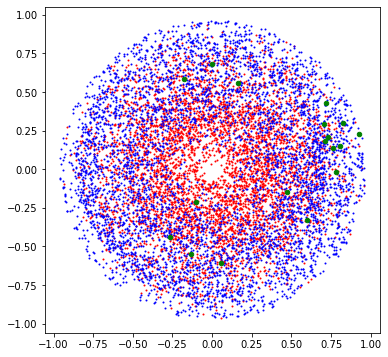


Epoch 15:  99%|█████████▉| 1012/1020 [08:40<00:04,  1.94it/s, loss=0.569, v_num=kt0p]

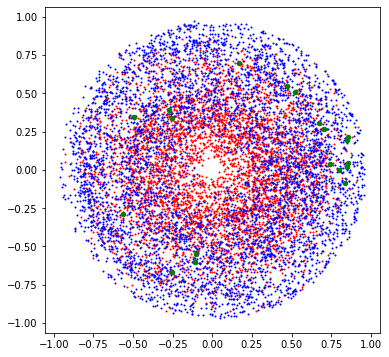


Epoch 15:  99%|█████████▉| 1013/1020 [08:49<00:03,  1.91it/s, loss=0.569, v_num=kt0p]

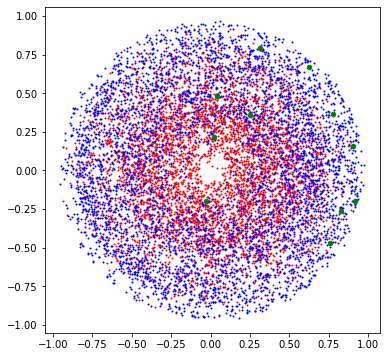


Epoch 15:  99%|█████████▉| 1014/1020 [08:58<00:03,  1.88it/s, loss=0.569, v_num=kt0p]

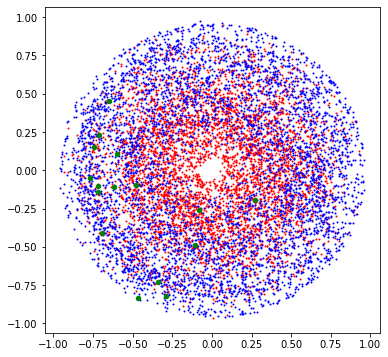


Epoch 15: 100%|█████████▉| 1015/1020 [09:09<00:02,  1.85it/s, loss=0.569, v_num=kt0p]

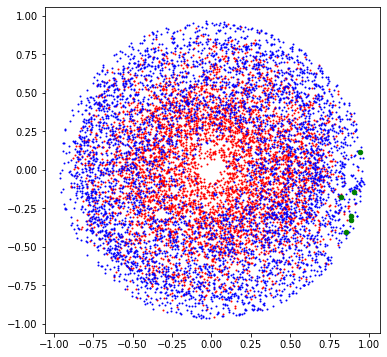


Epoch 15: 100%|█████████▉| 1016/1020 [09:17<00:02,  1.82it/s, loss=0.569, v_num=kt0p]

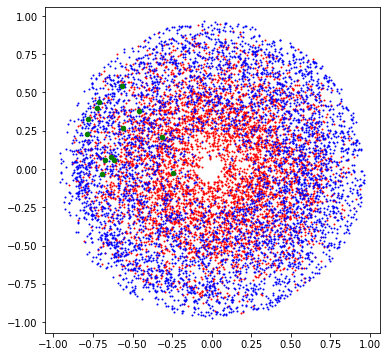


Epoch 15: 100%|█████████▉| 1017/1020 [09:26<00:01,  1.80it/s, loss=0.569, v_num=kt0p]

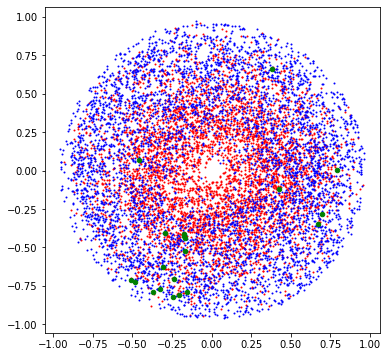


Epoch 15: 100%|█████████▉| 1018/1020 [09:35<00:01,  1.77it/s, loss=0.569, v_num=kt0p]

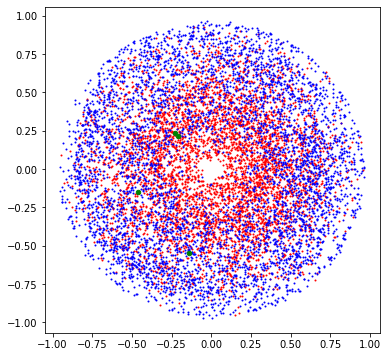


Epoch 15: 100%|█████████▉| 1019/1020 [09:43<00:00,  1.75it/s, loss=0.569, v_num=kt0p]

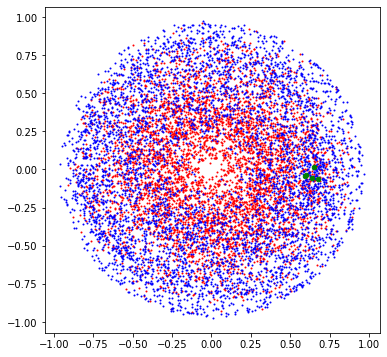


Epoch 15: 100%|██████████| 1020/1020 [09:52<00:00,  1.72it/s, loss=0.569, v_num=kt0p]

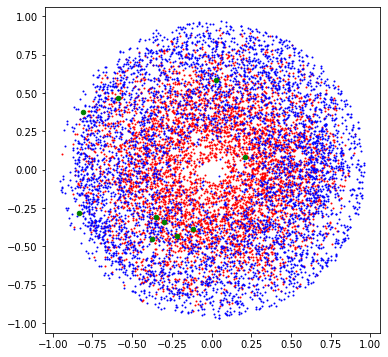


Epoch 16:  98%|█████████▊| 1000/1020 [07:02<00:08,  2.37it/s, loss=0.569, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

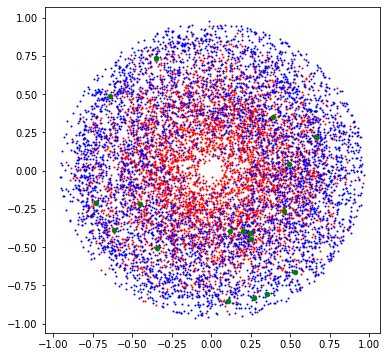


Epoch 16:  98%|█████████▊| 1002/1020 [07:14<00:07,  2.31it/s, loss=0.569, v_num=kt0p]

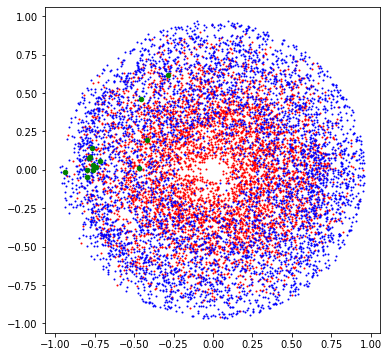


Epoch 16:  98%|█████████▊| 1003/1020 [07:23<00:07,  2.26it/s, loss=0.569, v_num=kt0p]

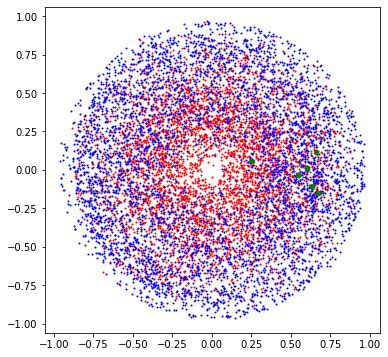


Epoch 16:  98%|█████████▊| 1004/1020 [07:31<00:07,  2.22it/s, loss=0.569, v_num=kt0p]

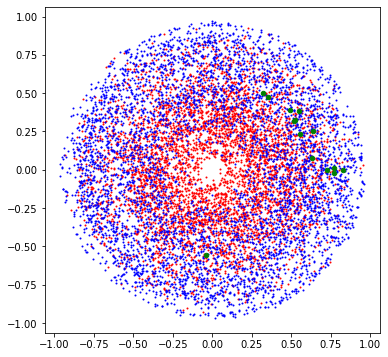


Epoch 16:  99%|█████████▊| 1005/1020 [07:39<00:06,  2.19it/s, loss=0.569, v_num=kt0p]

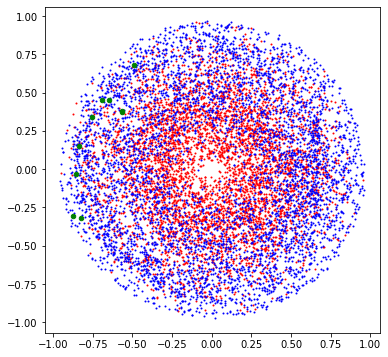


Epoch 16:  99%|█████████▊| 1006/1020 [07:48<00:06,  2.15it/s, loss=0.569, v_num=kt0p]

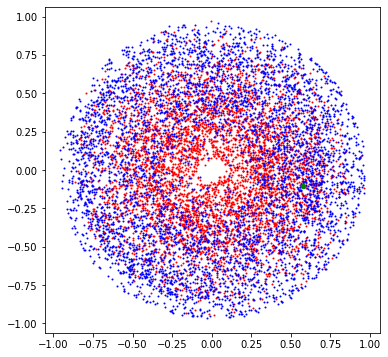


Epoch 16:  99%|█████████▊| 1007/1020 [07:57<00:06,  2.11it/s, loss=0.569, v_num=kt0p]

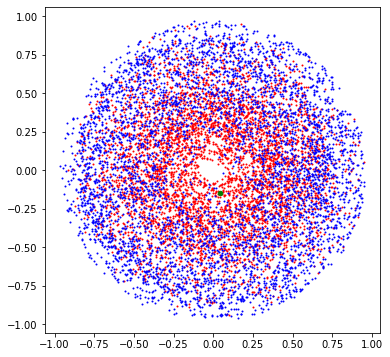


Epoch 16:  99%|█████████▉| 1008/1020 [08:06<00:05,  2.07it/s, loss=0.569, v_num=kt0p]

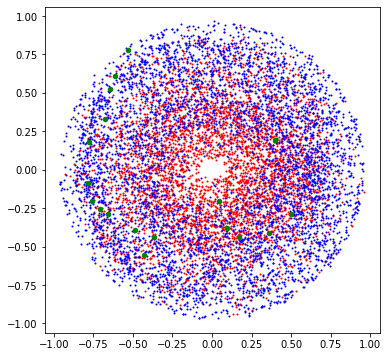


Epoch 16:  99%|█████████▉| 1009/1020 [08:13<00:05,  2.05it/s, loss=0.569, v_num=kt0p]

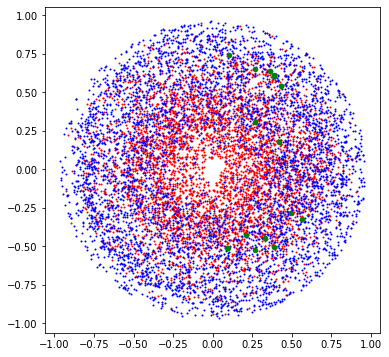


Epoch 16:  99%|█████████▉| 1010/1020 [08:22<00:04,  2.01it/s, loss=0.569, v_num=kt0p]

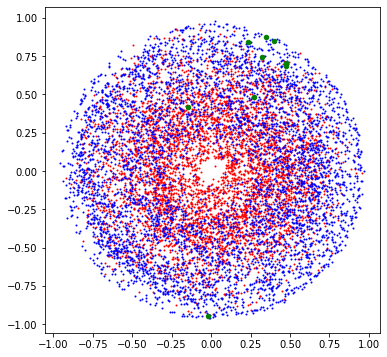


Epoch 16:  99%|█████████▉| 1011/1020 [08:31<00:04,  1.98it/s, loss=0.569, v_num=kt0p]

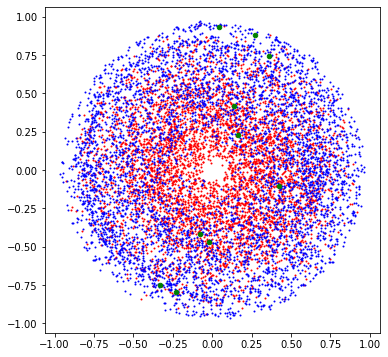


Epoch 16:  99%|█████████▉| 1012/1020 [08:41<00:04,  1.94it/s, loss=0.569, v_num=kt0p]

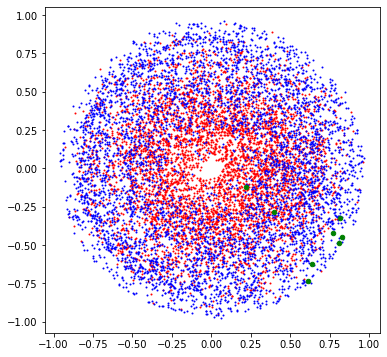


Epoch 16:  99%|█████████▉| 1013/1020 [08:50<00:03,  1.91it/s, loss=0.569, v_num=kt0p]

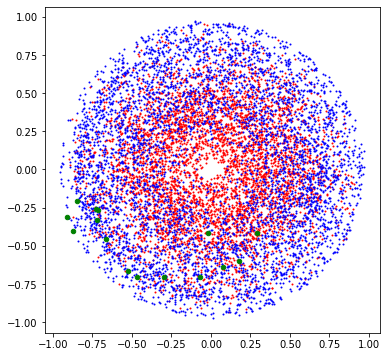


Epoch 16:  99%|█████████▉| 1014/1020 [08:59<00:03,  1.88it/s, loss=0.569, v_num=kt0p]

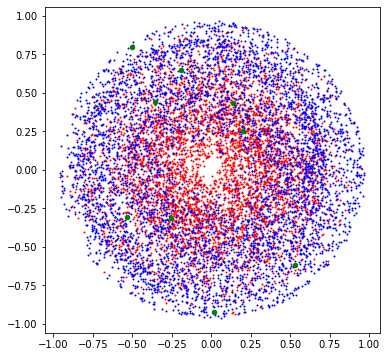


Epoch 16: 100%|█████████▉| 1015/1020 [09:10<00:02,  1.84it/s, loss=0.569, v_num=kt0p]

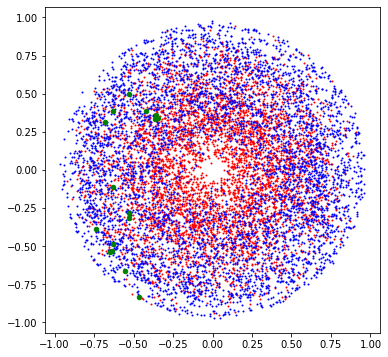


Epoch 16: 100%|█████████▉| 1016/1020 [09:18<00:02,  1.82it/s, loss=0.569, v_num=kt0p]

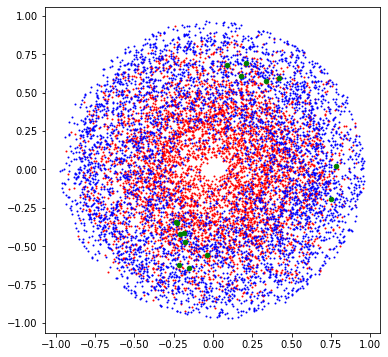


Epoch 16: 100%|█████████▉| 1017/1020 [09:27<00:01,  1.79it/s, loss=0.569, v_num=kt0p]

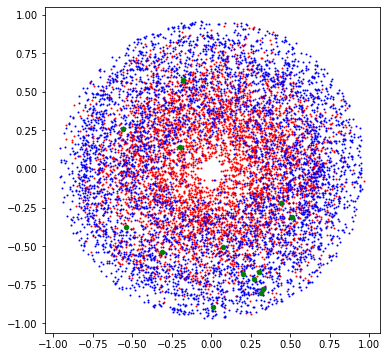


Epoch 16: 100%|█████████▉| 1018/1020 [09:36<00:01,  1.77it/s, loss=0.569, v_num=kt0p]

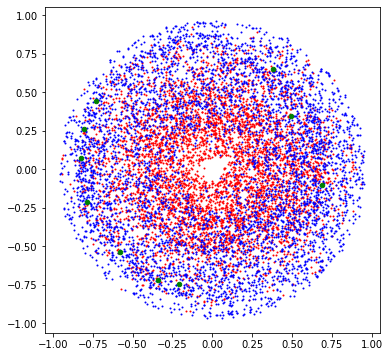


Epoch 16: 100%|█████████▉| 1019/1020 [09:44<00:00,  1.74it/s, loss=0.569, v_num=kt0p]

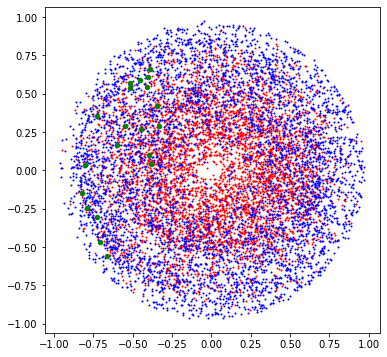


Epoch 16: 100%|██████████| 1020/1020 [09:53<00:00,  1.72it/s, loss=0.569, v_num=kt0p]

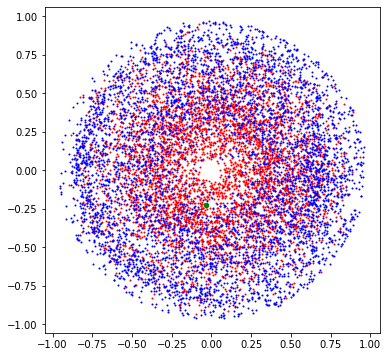


Epoch 17:  98%|█████████▊| 1000/1020 [06:53<00:08,  2.42it/s, loss=0.569, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

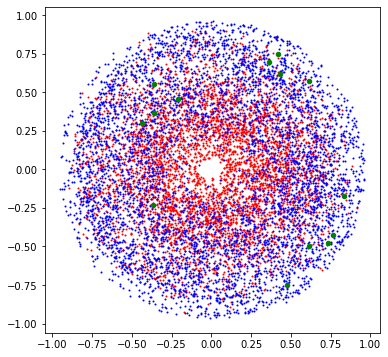


Epoch 17:  98%|█████████▊| 1002/1020 [07:04<00:07,  2.36it/s, loss=0.569, v_num=kt0p]

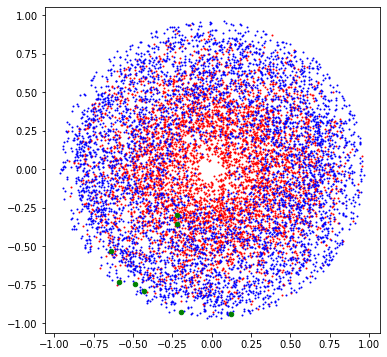


Epoch 17:  98%|█████████▊| 1003/1020 [07:13<00:07,  2.31it/s, loss=0.569, v_num=kt0p]

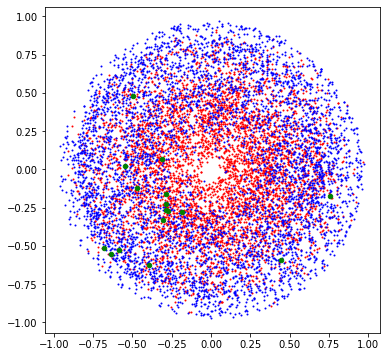


Epoch 17:  98%|█████████▊| 1004/1020 [07:22<00:07,  2.27it/s, loss=0.569, v_num=kt0p]

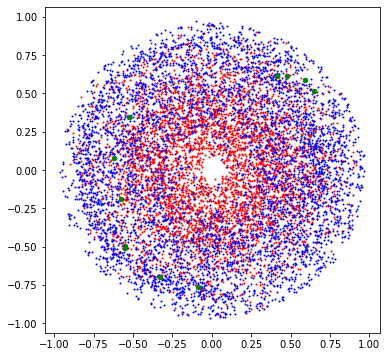


Epoch 17:  99%|█████████▊| 1005/1020 [07:29<00:06,  2.23it/s, loss=0.569, v_num=kt0p]

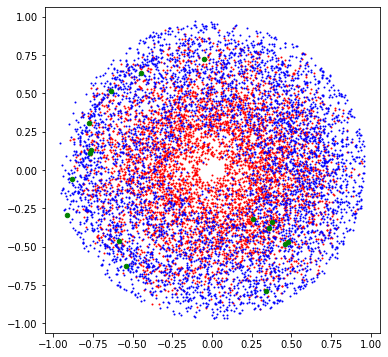


Epoch 17:  99%|█████████▊| 1006/1020 [07:39<00:06,  2.19it/s, loss=0.569, v_num=kt0p]

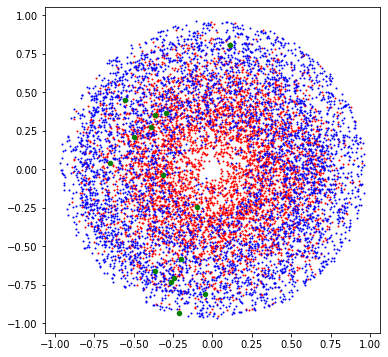


Epoch 17:  99%|█████████▊| 1007/1020 [07:48<00:06,  2.15it/s, loss=0.569, v_num=kt0p]

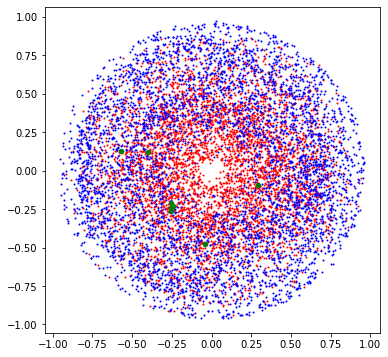


Epoch 17:  99%|█████████▉| 1008/1020 [07:56<00:05,  2.11it/s, loss=0.569, v_num=kt0p]

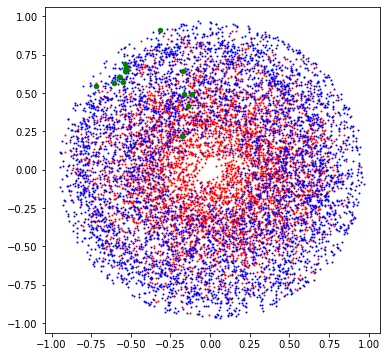


Epoch 17:  99%|█████████▉| 1009/1020 [08:04<00:05,  2.08it/s, loss=0.569, v_num=kt0p]

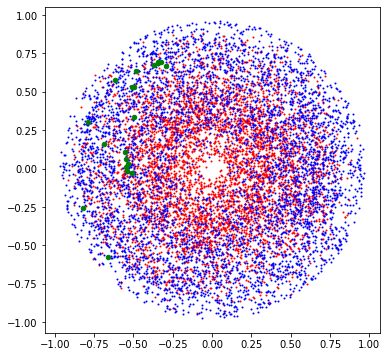


Epoch 17:  99%|█████████▉| 1010/1020 [08:13<00:04,  2.05it/s, loss=0.569, v_num=kt0p]

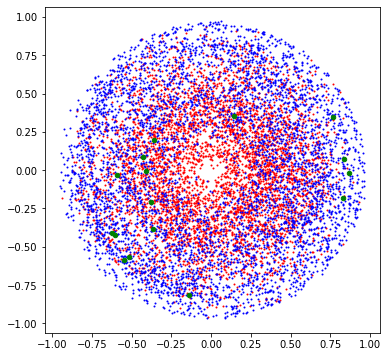


Epoch 17:  99%|█████████▉| 1011/1020 [08:21<00:04,  2.01it/s, loss=0.569, v_num=kt0p]

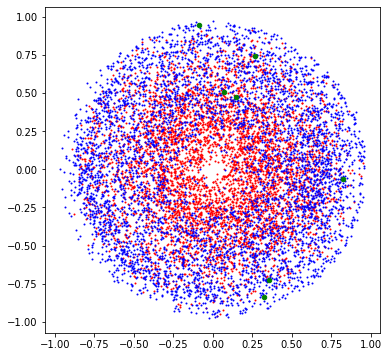


Epoch 17:  99%|█████████▉| 1012/1020 [08:32<00:04,  1.98it/s, loss=0.569, v_num=kt0p]

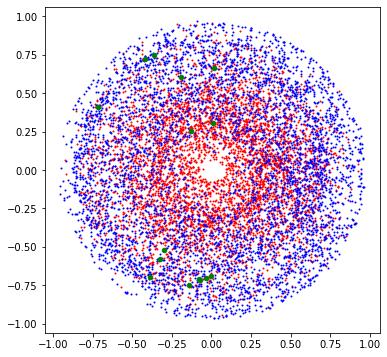


Epoch 17:  99%|█████████▉| 1013/1020 [08:40<00:03,  1.94it/s, loss=0.569, v_num=kt0p]

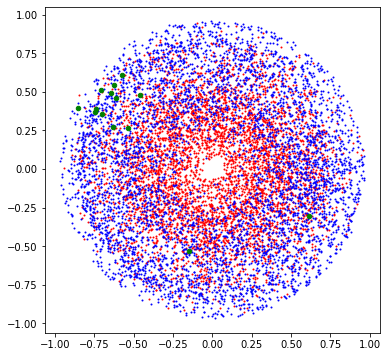


Epoch 17:  99%|█████████▉| 1014/1020 [08:50<00:03,  1.91it/s, loss=0.569, v_num=kt0p]

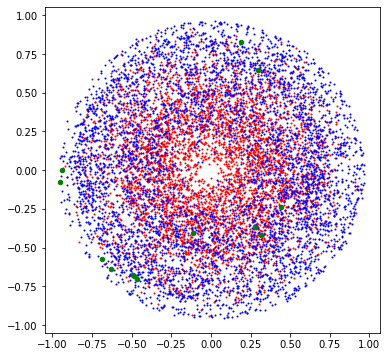


Epoch 17: 100%|█████████▉| 1015/1020 [09:00<00:02,  1.88it/s, loss=0.569, v_num=kt0p]

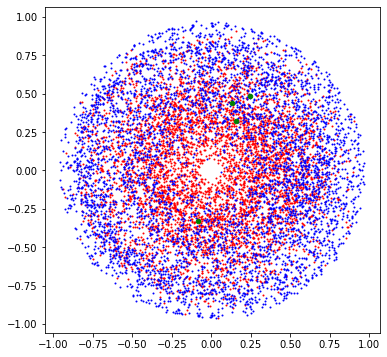


Epoch 17: 100%|█████████▉| 1016/1020 [09:09<00:02,  1.85it/s, loss=0.569, v_num=kt0p]

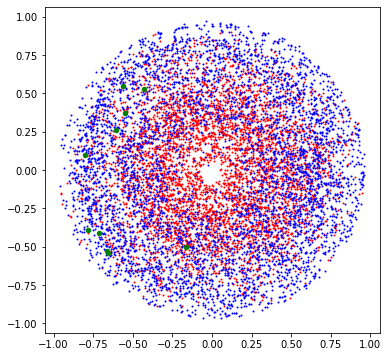


Epoch 17: 100%|█████████▉| 1017/1020 [09:17<00:01,  1.82it/s, loss=0.569, v_num=kt0p]

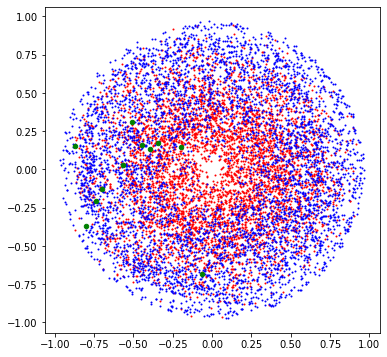


Epoch 17: 100%|█████████▉| 1018/1020 [09:26<00:01,  1.80it/s, loss=0.569, v_num=kt0p]

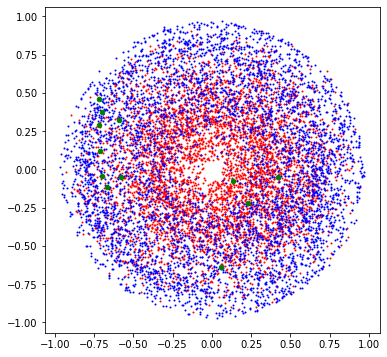


Epoch 17: 100%|█████████▉| 1019/1020 [09:35<00:00,  1.77it/s, loss=0.569, v_num=kt0p]

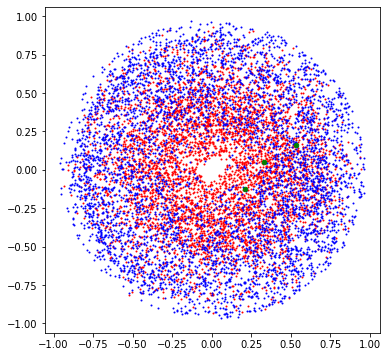


Epoch 17: 100%|██████████| 1020/1020 [09:44<00:00,  1.75it/s, loss=0.569, v_num=kt0p]

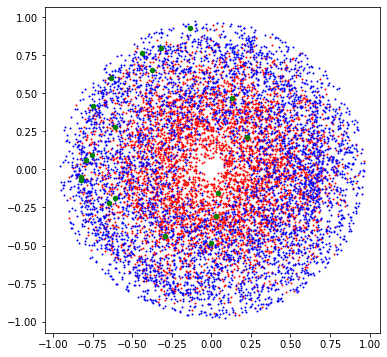


Epoch 18:  98%|█████████▊| 1000/1020 [06:54<00:08,  2.41it/s, loss=0.569, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

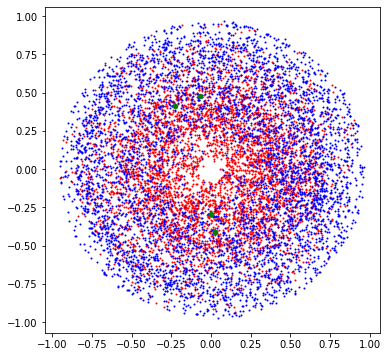


Epoch 18:  98%|█████████▊| 1002/1020 [07:05<00:07,  2.36it/s, loss=0.569, v_num=kt0p]

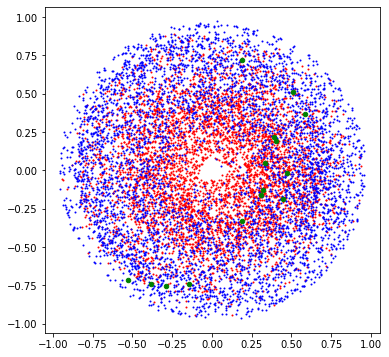


Epoch 18:  98%|█████████▊| 1003/1020 [07:14<00:07,  2.31it/s, loss=0.569, v_num=kt0p]

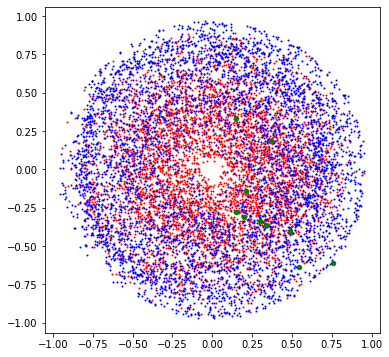


Epoch 18:  98%|█████████▊| 1004/1020 [07:22<00:07,  2.27it/s, loss=0.569, v_num=kt0p]

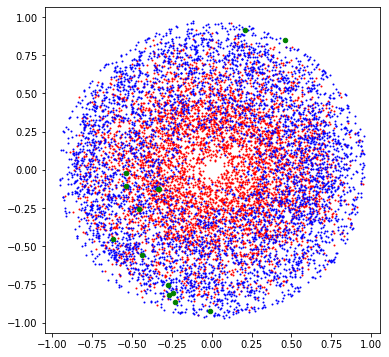


Epoch 18:  99%|█████████▊| 1005/1020 [07:30<00:06,  2.23it/s, loss=0.569, v_num=kt0p]

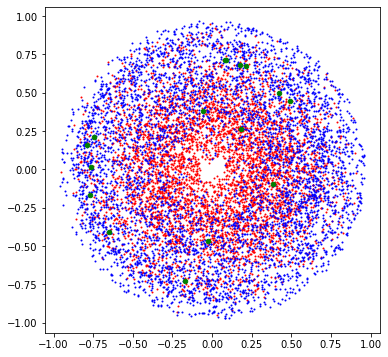


Epoch 18:  99%|█████████▊| 1006/1020 [07:40<00:06,  2.19it/s, loss=0.569, v_num=kt0p]

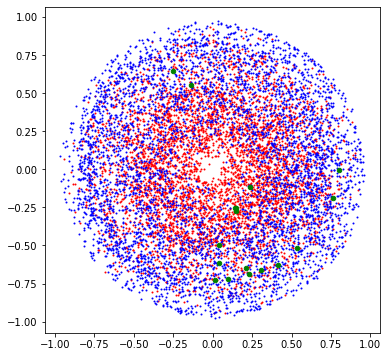


Epoch 18:  99%|█████████▊| 1007/1020 [07:48<00:06,  2.15it/s, loss=0.569, v_num=kt0p]

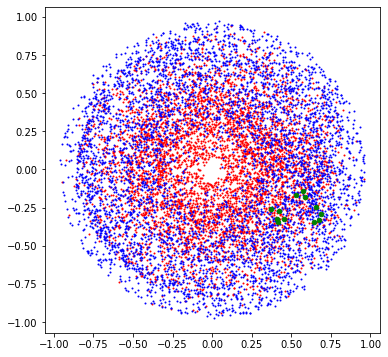


Epoch 18:  99%|█████████▉| 1008/1020 [07:57<00:05,  2.11it/s, loss=0.569, v_num=kt0p]

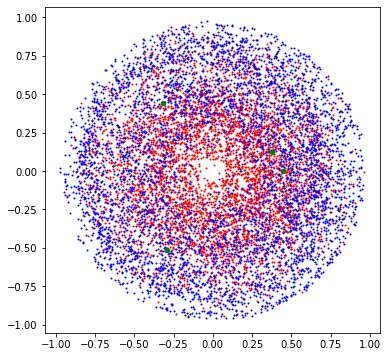


Epoch 18:  99%|█████████▉| 1009/1020 [08:04<00:05,  2.08it/s, loss=0.569, v_num=kt0p]

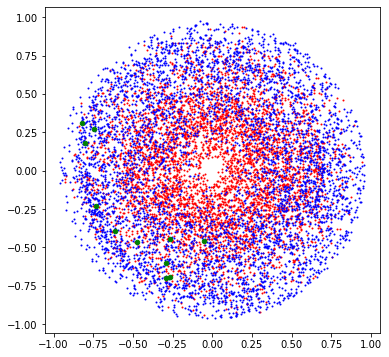


Epoch 18:  99%|█████████▉| 1010/1020 [08:14<00:04,  2.04it/s, loss=0.569, v_num=kt0p]

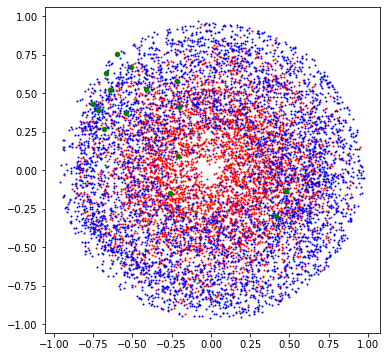


Epoch 18:  99%|█████████▉| 1011/1020 [08:22<00:04,  2.01it/s, loss=0.569, v_num=kt0p]

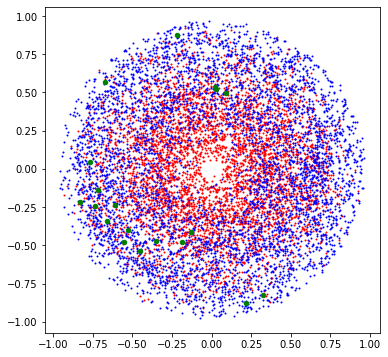


Epoch 18:  99%|█████████▉| 1012/1020 [08:32<00:04,  1.97it/s, loss=0.569, v_num=kt0p]

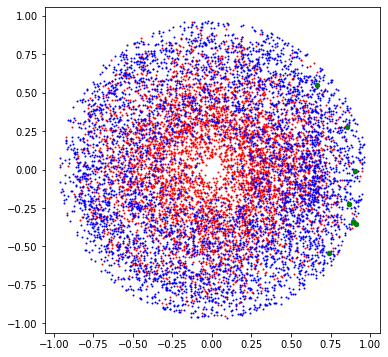


Epoch 18:  99%|█████████▉| 1013/1020 [08:41<00:03,  1.94it/s, loss=0.569, v_num=kt0p]

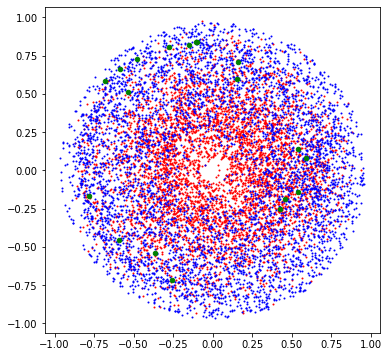


Epoch 18:  99%|█████████▉| 1014/1020 [08:51<00:03,  1.91it/s, loss=0.569, v_num=kt0p]

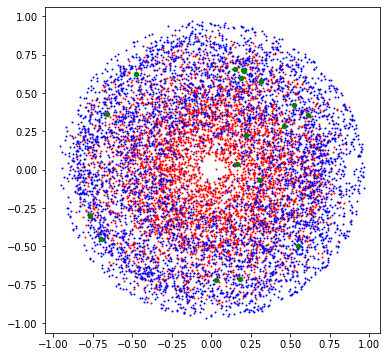


Epoch 18: 100%|█████████▉| 1015/1020 [09:01<00:02,  1.87it/s, loss=0.569, v_num=kt0p]

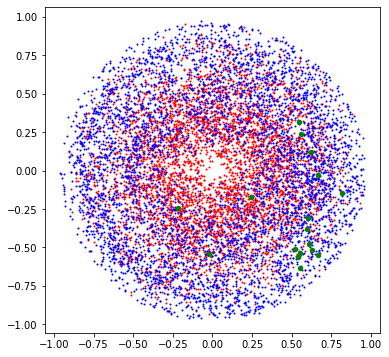


Epoch 18: 100%|█████████▉| 1016/1020 [09:10<00:02,  1.85it/s, loss=0.569, v_num=kt0p]

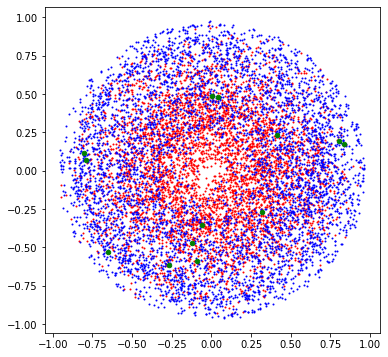


Epoch 18: 100%|█████████▉| 1017/1020 [09:18<00:01,  1.82it/s, loss=0.569, v_num=kt0p]

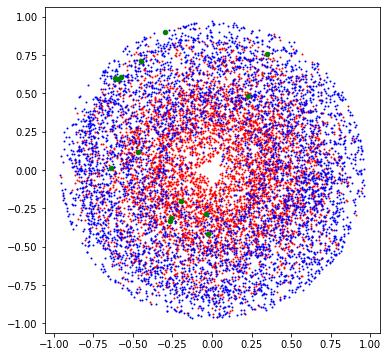


Epoch 18: 100%|█████████▉| 1018/1020 [09:28<00:01,  1.79it/s, loss=0.569, v_num=kt0p]

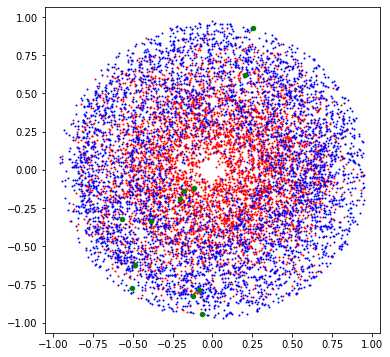


Epoch 18: 100%|█████████▉| 1019/1020 [09:36<00:00,  1.77it/s, loss=0.569, v_num=kt0p]

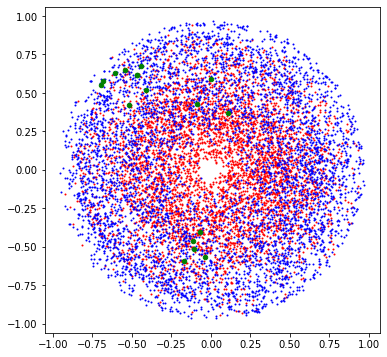


Epoch 18: 100%|██████████| 1020/1020 [09:45<00:00,  1.74it/s, loss=0.569, v_num=kt0p]

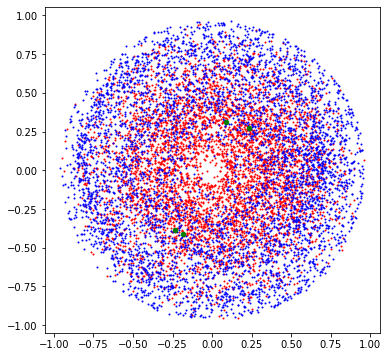


Epoch 19:  98%|█████████▊| 1000/1020 [07:04<00:08,  2.36it/s, loss=0.569, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

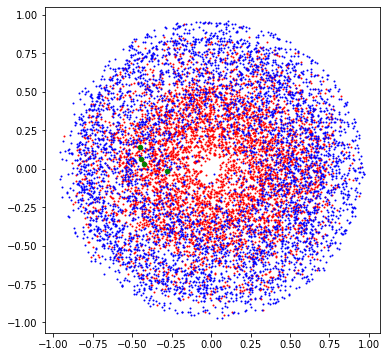


Epoch 19:  98%|█████████▊| 1002/1020 [07:15<00:07,  2.30it/s, loss=0.569, v_num=kt0p]

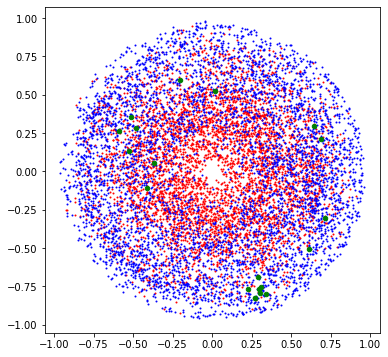


Epoch 19:  98%|█████████▊| 1003/1020 [07:24<00:07,  2.26it/s, loss=0.569, v_num=kt0p]

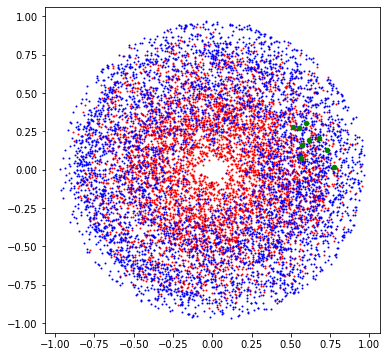


Epoch 19:  98%|█████████▊| 1004/1020 [07:32<00:07,  2.22it/s, loss=0.569, v_num=kt0p]

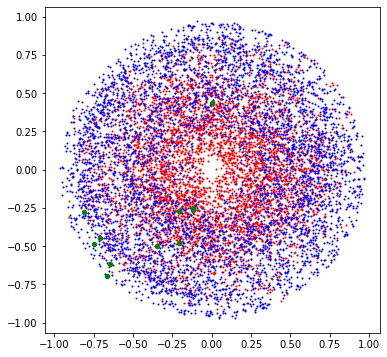


Epoch 19:  99%|█████████▊| 1005/1020 [07:40<00:06,  2.18it/s, loss=0.569, v_num=kt0p]

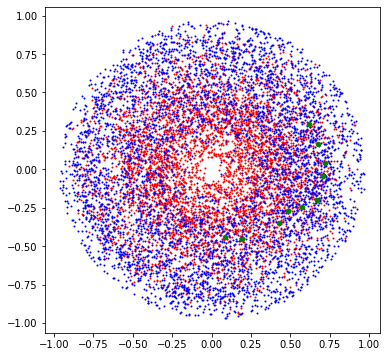


Epoch 19:  99%|█████████▊| 1006/1020 [07:50<00:06,  2.14it/s, loss=0.569, v_num=kt0p]

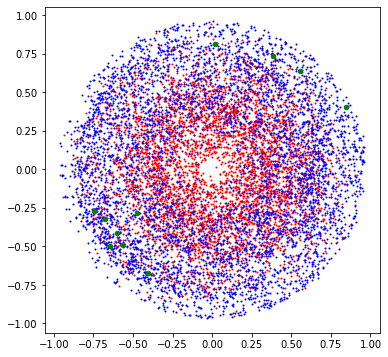


Epoch 19:  99%|█████████▊| 1007/1020 [07:59<00:06,  2.10it/s, loss=0.569, v_num=kt0p]

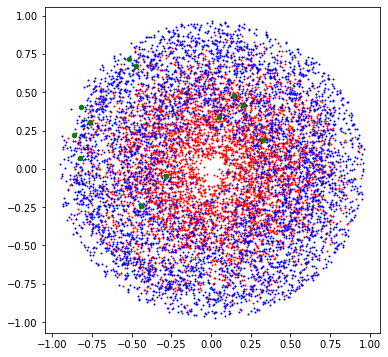


Epoch 19:  99%|█████████▉| 1008/1020 [08:07<00:05,  2.07it/s, loss=0.569, v_num=kt0p]

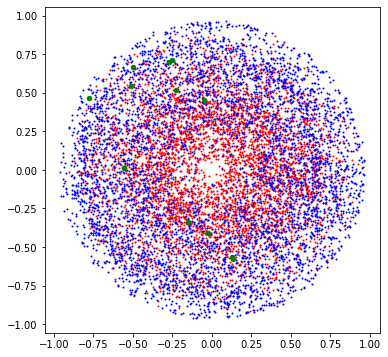


Epoch 19:  99%|█████████▉| 1009/1020 [08:15<00:05,  2.04it/s, loss=0.569, v_num=kt0p]

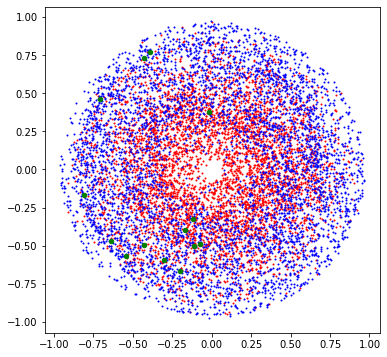


Epoch 19:  99%|█████████▉| 1010/1020 [08:24<00:04,  2.00it/s, loss=0.569, v_num=kt0p]

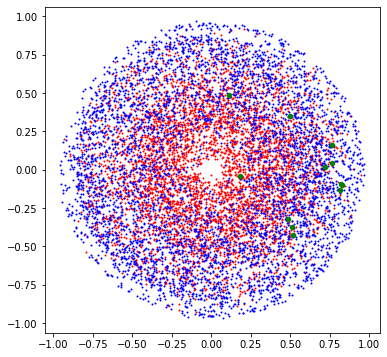


Epoch 19:  99%|█████████▉| 1011/1020 [08:32<00:04,  1.97it/s, loss=0.569, v_num=kt0p]

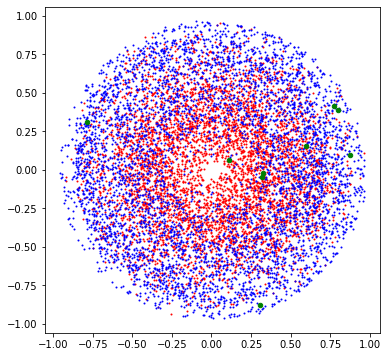


Epoch 19:  99%|█████████▉| 1012/1020 [08:43<00:04,  1.93it/s, loss=0.569, v_num=kt0p]

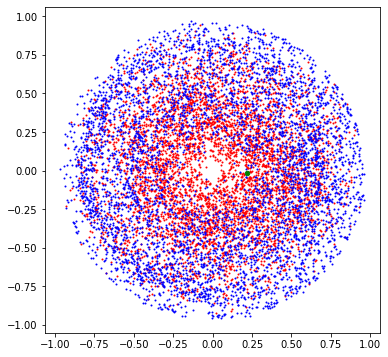


Epoch 19:  99%|█████████▉| 1013/1020 [08:52<00:03,  1.90it/s, loss=0.569, v_num=kt0p]

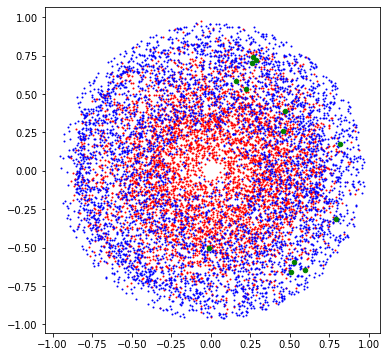


Epoch 19:  99%|█████████▉| 1014/1020 [09:01<00:03,  1.87it/s, loss=0.569, v_num=kt0p]

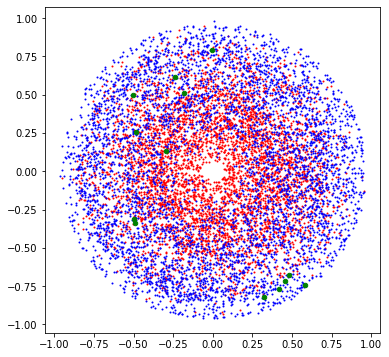


Epoch 19: 100%|█████████▉| 1015/1020 [09:11<00:02,  1.84it/s, loss=0.569, v_num=kt0p]

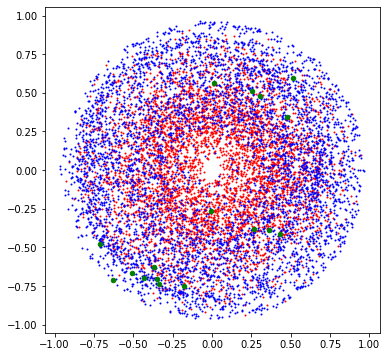


Epoch 19: 100%|█████████▉| 1016/1020 [09:20<00:02,  1.81it/s, loss=0.569, v_num=kt0p]

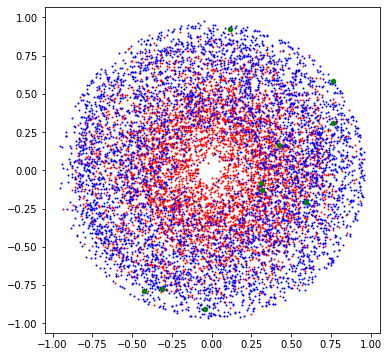


Epoch 19: 100%|█████████▉| 1017/1020 [09:28<00:01,  1.79it/s, loss=0.569, v_num=kt0p]

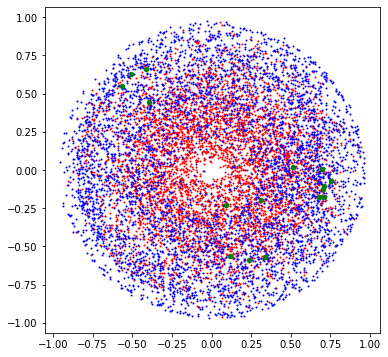


Epoch 19: 100%|█████████▉| 1018/1020 [09:37<00:01,  1.76it/s, loss=0.569, v_num=kt0p]

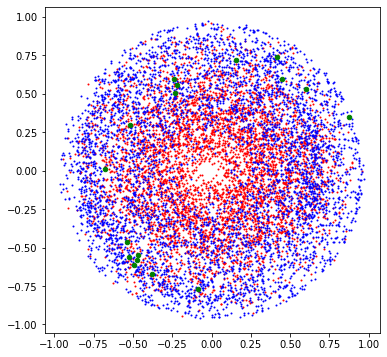


Epoch 19: 100%|█████████▉| 1019/1020 [09:46<00:00,  1.74it/s, loss=0.569, v_num=kt0p]

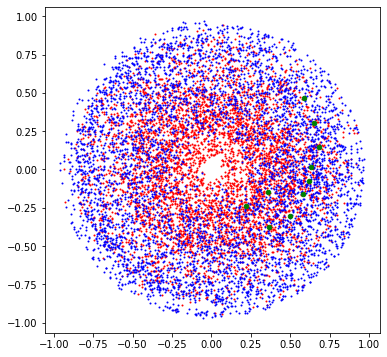


Epoch 19: 100%|██████████| 1020/1020 [09:54<00:00,  1.71it/s, loss=0.569, v_num=kt0p]

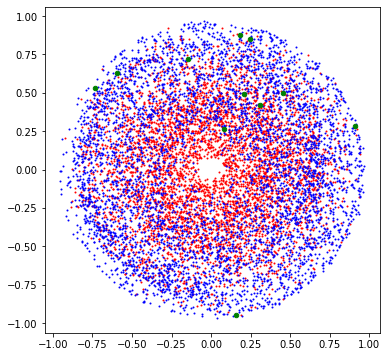


Epoch 20:  98%|█████████▊| 1000/1020 [07:11<00:08,  2.32it/s, loss=0.569, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

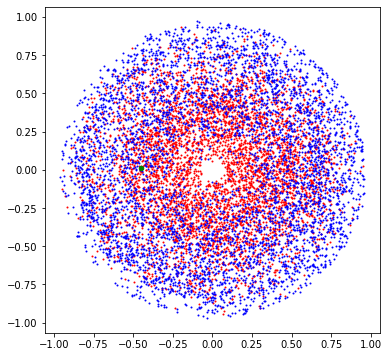


Epoch 20:  98%|█████████▊| 1002/1020 [07:22<00:07,  2.26it/s, loss=0.569, v_num=kt0p]

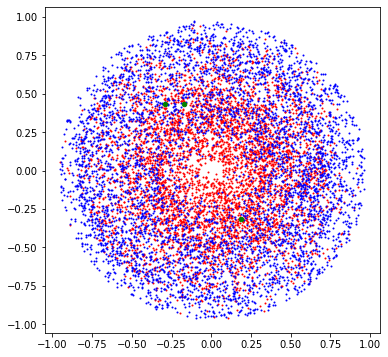


Epoch 20:  98%|█████████▊| 1003/1020 [07:31<00:07,  2.22it/s, loss=0.569, v_num=kt0p]

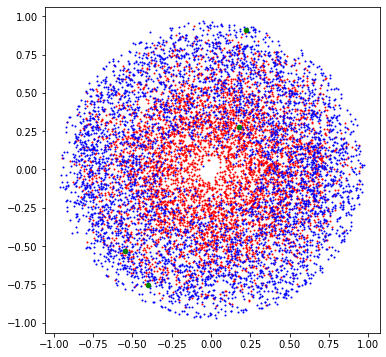


Epoch 20:  98%|█████████▊| 1004/1020 [07:40<00:07,  2.18it/s, loss=0.569, v_num=kt0p]

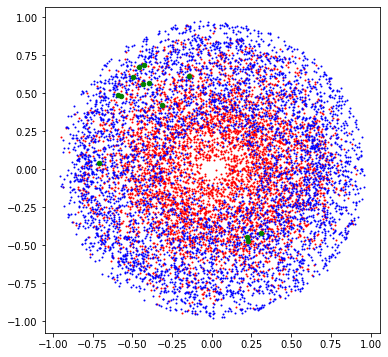


Epoch 20:  99%|█████████▊| 1005/1020 [07:48<00:06,  2.15it/s, loss=0.569, v_num=kt0p]

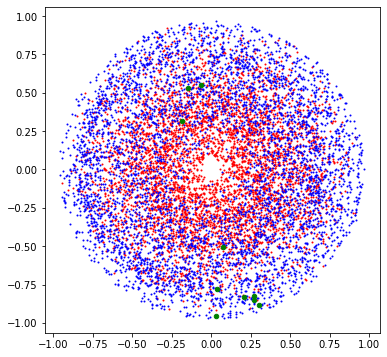


Epoch 20:  99%|█████████▊| 1006/1020 [07:57<00:06,  2.10it/s, loss=0.569, v_num=kt0p]

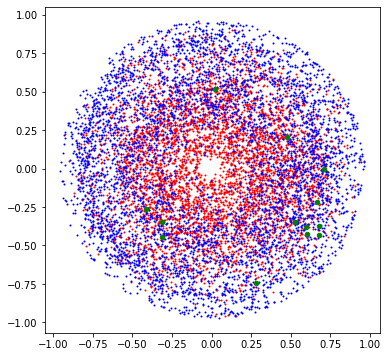


Epoch 20:  99%|█████████▊| 1007/1020 [08:07<00:06,  2.07it/s, loss=0.569, v_num=kt0p]

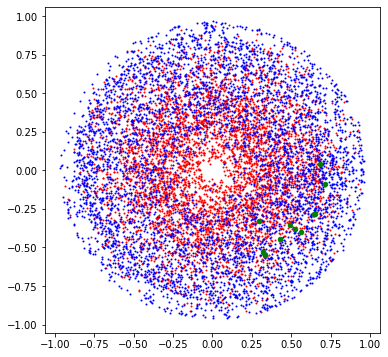


Epoch 20:  99%|█████████▉| 1008/1020 [08:15<00:05,  2.03it/s, loss=0.569, v_num=kt0p]

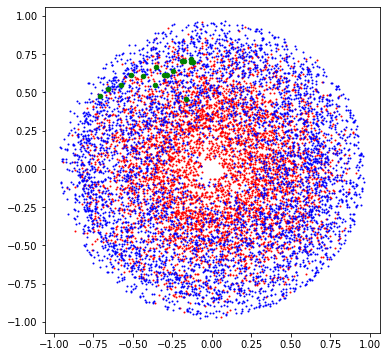


Epoch 20:  99%|█████████▉| 1009/1020 [08:23<00:05,  2.00it/s, loss=0.569, v_num=kt0p]

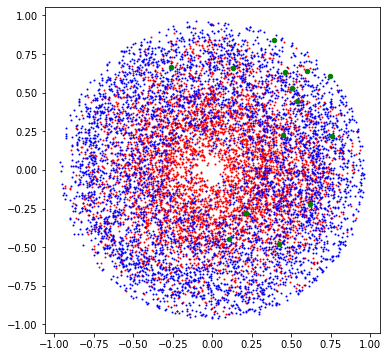


Epoch 20:  99%|█████████▉| 1010/1020 [08:33<00:05,  1.97it/s, loss=0.569, v_num=kt0p]

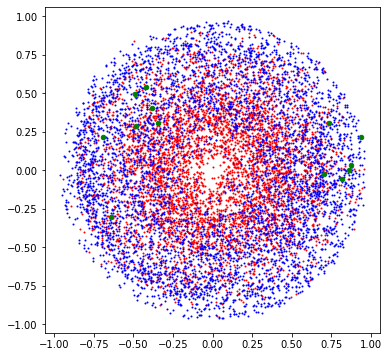


Epoch 20:  99%|█████████▉| 1011/1020 [08:42<00:04,  1.93it/s, loss=0.569, v_num=kt0p]

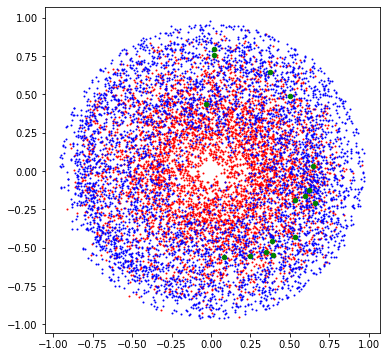


Epoch 20:  99%|█████████▉| 1012/1020 [08:53<00:04,  1.90it/s, loss=0.569, v_num=kt0p]

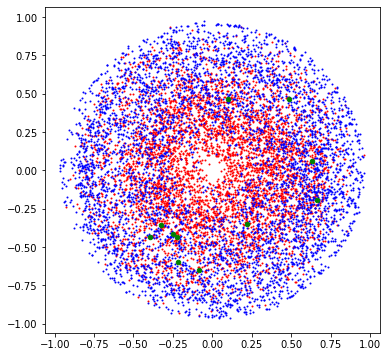


Epoch 20:  99%|█████████▉| 1013/1020 [09:02<00:03,  1.87it/s, loss=0.569, v_num=kt0p]

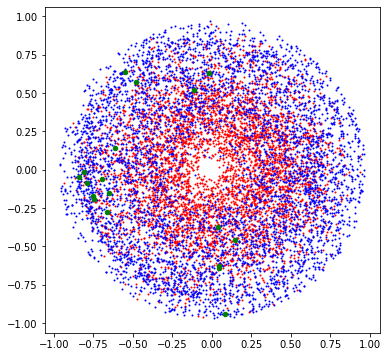


Epoch 20:  99%|█████████▉| 1014/1020 [09:11<00:03,  1.84it/s, loss=0.569, v_num=kt0p]

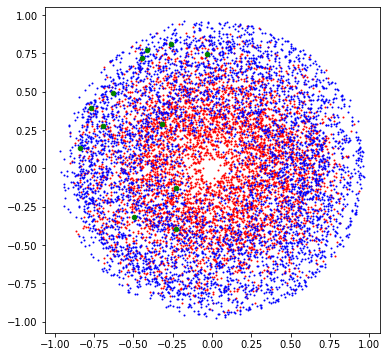


Epoch 20: 100%|█████████▉| 1015/1020 [09:22<00:02,  1.80it/s, loss=0.569, v_num=kt0p]

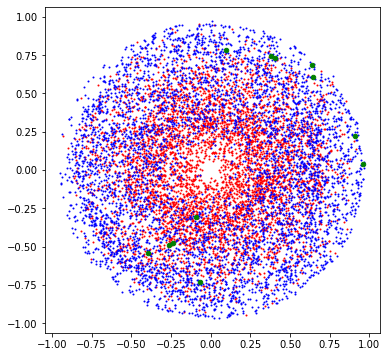


Epoch 20: 100%|█████████▉| 1016/1020 [09:30<00:02,  1.78it/s, loss=0.569, v_num=kt0p]

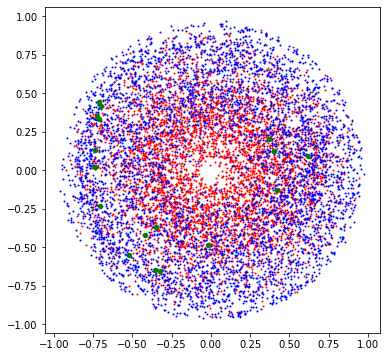


Epoch 20: 100%|█████████▉| 1017/1020 [09:39<00:01,  1.75it/s, loss=0.569, v_num=kt0p]

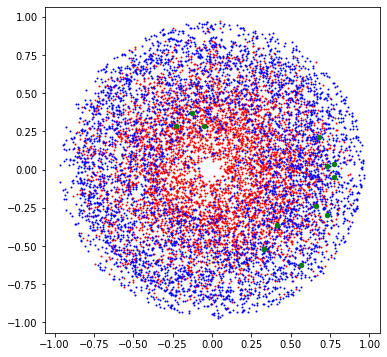


Epoch 20: 100%|█████████▉| 1018/1020 [09:48<00:01,  1.73it/s, loss=0.569, v_num=kt0p]

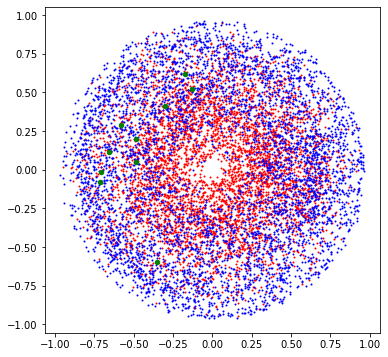


Epoch 20: 100%|█████████▉| 1019/1020 [09:57<00:00,  1.71it/s, loss=0.569, v_num=kt0p]

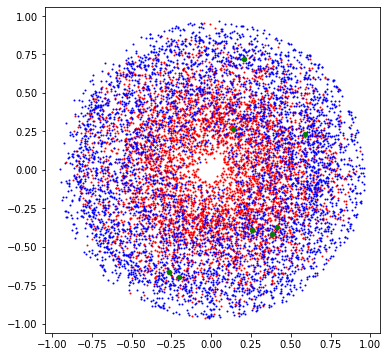


Epoch 20: 100%|██████████| 1020/1020 [10:06<00:00,  1.68it/s, loss=0.569, v_num=kt0p]

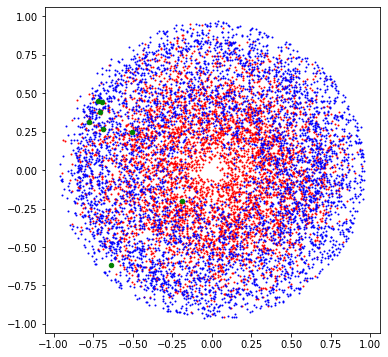


Epoch 21:  98%|█████████▊| 1000/1020 [07:09<00:08,  2.33it/s, loss=0.569, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

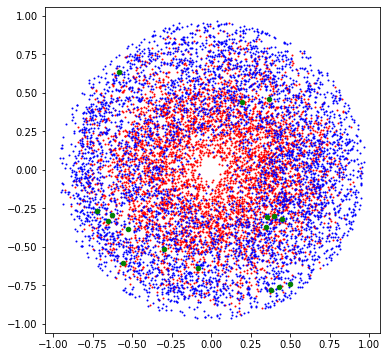


Epoch 21:  98%|█████████▊| 1002/1020 [07:20<00:07,  2.28it/s, loss=0.569, v_num=kt0p]

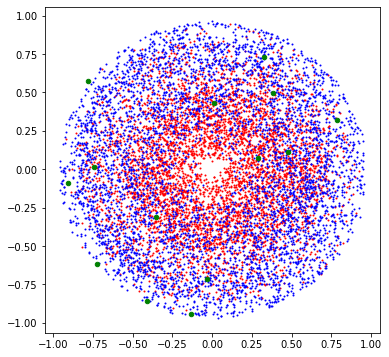


Epoch 21:  98%|█████████▊| 1003/1020 [07:29<00:07,  2.23it/s, loss=0.569, v_num=kt0p]

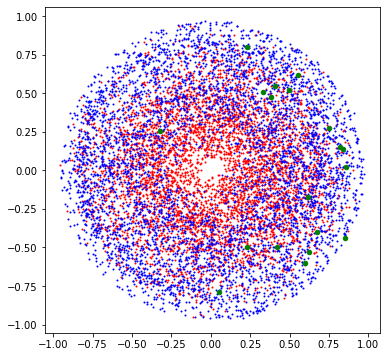


Epoch 21:  98%|█████████▊| 1004/1020 [07:37<00:07,  2.19it/s, loss=0.569, v_num=kt0p]

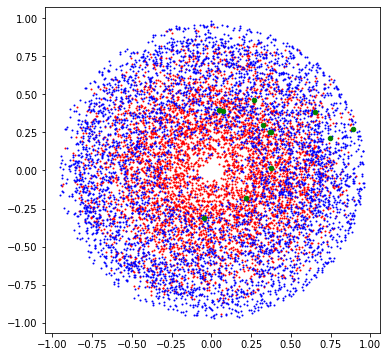


Epoch 21:  99%|█████████▊| 1005/1020 [07:45<00:06,  2.16it/s, loss=0.569, v_num=kt0p]

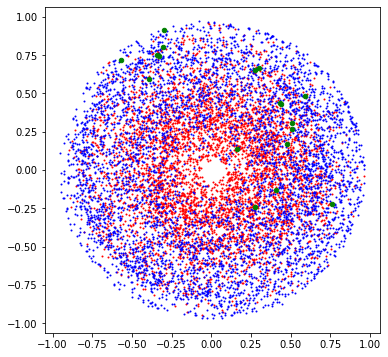


Epoch 21:  99%|█████████▊| 1006/1020 [07:55<00:06,  2.11it/s, loss=0.569, v_num=kt0p]

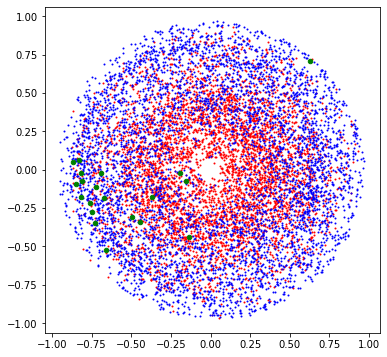


Epoch 21:  99%|█████████▊| 1007/1020 [08:04<00:06,  2.08it/s, loss=0.569, v_num=kt0p]

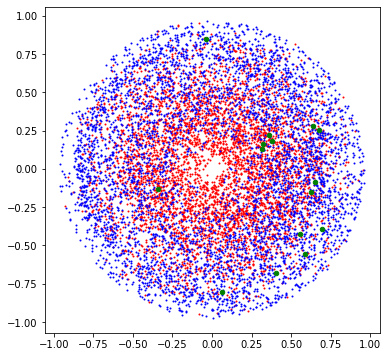


Epoch 21:  99%|█████████▉| 1008/1020 [08:13<00:05,  2.04it/s, loss=0.569, v_num=kt0p]

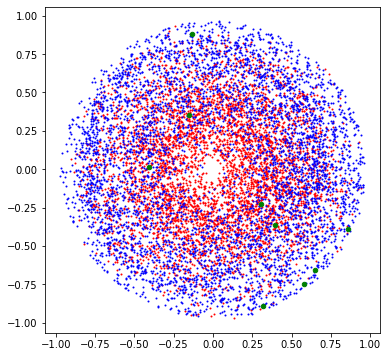


Epoch 21:  99%|█████████▉| 1009/1020 [08:20<00:05,  2.01it/s, loss=0.569, v_num=kt0p]

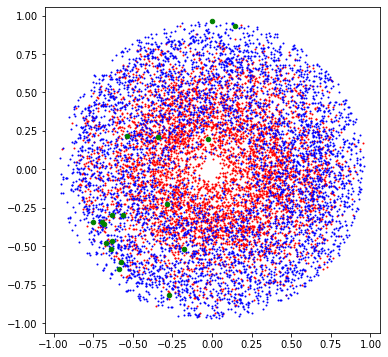


Epoch 21:  99%|█████████▉| 1010/1020 [08:30<00:05,  1.98it/s, loss=0.569, v_num=kt0p]

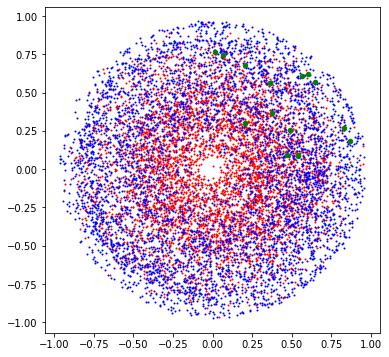


Epoch 21:  99%|█████████▉| 1011/1020 [08:38<00:04,  1.95it/s, loss=0.569, v_num=kt0p]

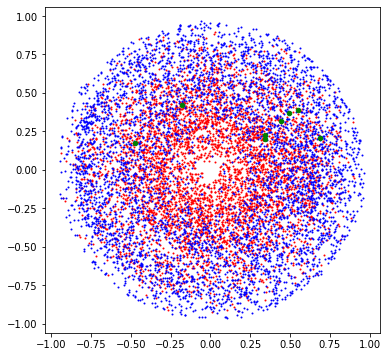


Epoch 21:  99%|█████████▉| 1012/1020 [08:49<00:04,  1.91it/s, loss=0.569, v_num=kt0p]

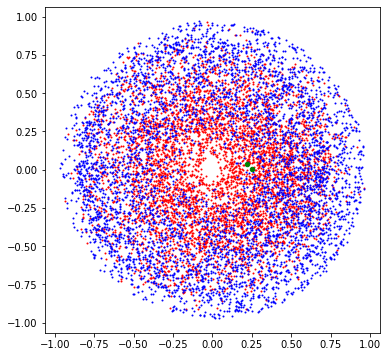


Epoch 21:  99%|█████████▉| 1013/1020 [08:58<00:03,  1.88it/s, loss=0.569, v_num=kt0p]

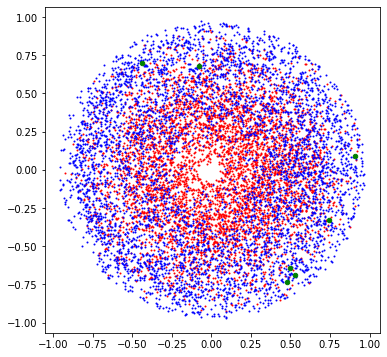


Epoch 21:  99%|█████████▉| 1014/1020 [09:07<00:03,  1.85it/s, loss=0.569, v_num=kt0p]

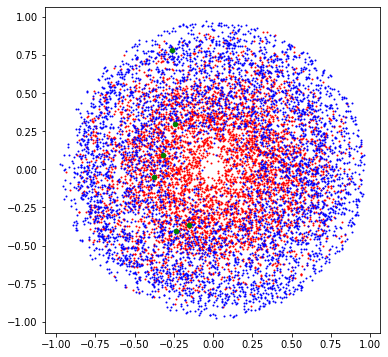


Epoch 21: 100%|█████████▉| 1015/1020 [09:18<00:02,  1.82it/s, loss=0.569, v_num=kt0p]

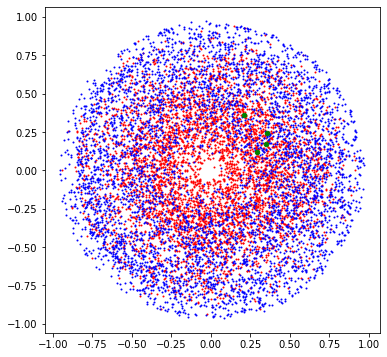


Epoch 21: 100%|█████████▉| 1016/1020 [09:26<00:02,  1.79it/s, loss=0.569, v_num=kt0p]

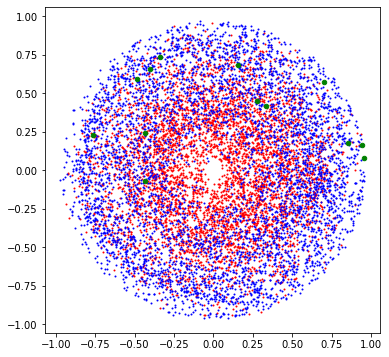


Epoch 21: 100%|█████████▉| 1017/1020 [09:34<00:01,  1.77it/s, loss=0.569, v_num=kt0p]

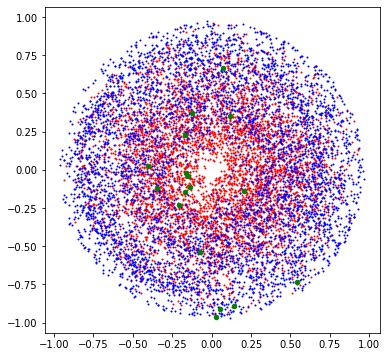


Epoch 21: 100%|█████████▉| 1018/1020 [09:44<00:01,  1.74it/s, loss=0.569, v_num=kt0p]

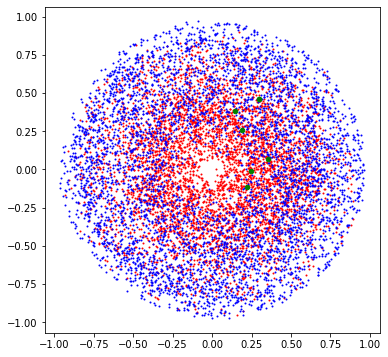


Epoch 21: 100%|█████████▉| 1019/1020 [09:52<00:00,  1.72it/s, loss=0.569, v_num=kt0p]

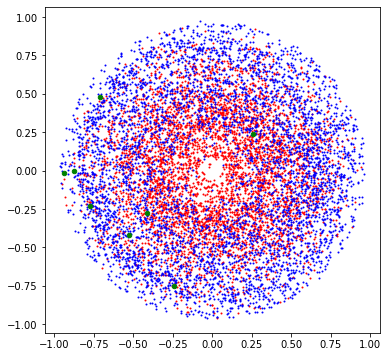


Epoch 21: 100%|██████████| 1020/1020 [10:01<00:00,  1.69it/s, loss=0.569, v_num=kt0p]

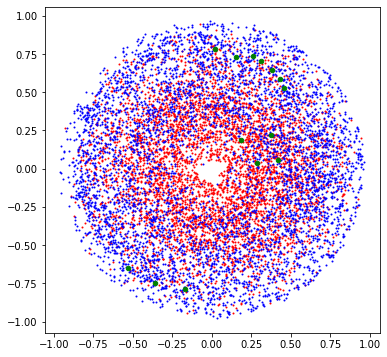


Epoch 22:  98%|█████████▊| 1000/1020 [07:10<00:08,  2.32it/s, loss=0.569, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

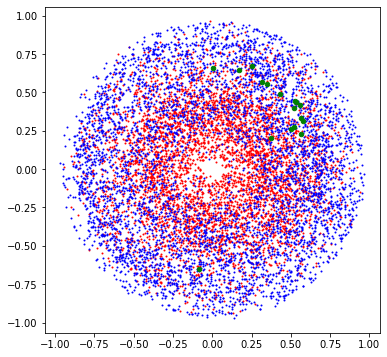


Epoch 22:  98%|█████████▊| 1002/1020 [07:21<00:07,  2.27it/s, loss=0.569, v_num=kt0p]

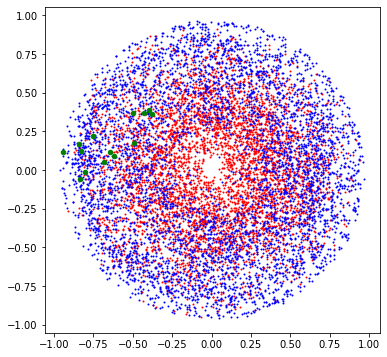


Epoch 22:  98%|█████████▊| 1003/1020 [07:31<00:07,  2.22it/s, loss=0.569, v_num=kt0p]

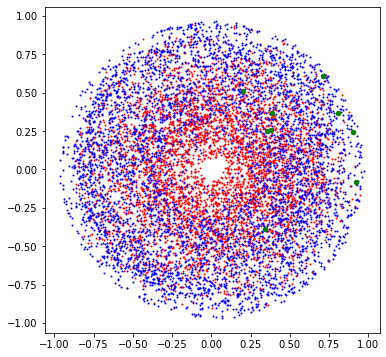


Epoch 22:  98%|█████████▊| 1004/1020 [07:39<00:07,  2.19it/s, loss=0.569, v_num=kt0p]

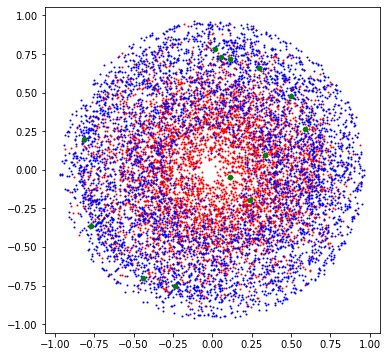


Epoch 22:  99%|█████████▊| 1005/1020 [07:47<00:06,  2.15it/s, loss=0.569, v_num=kt0p]

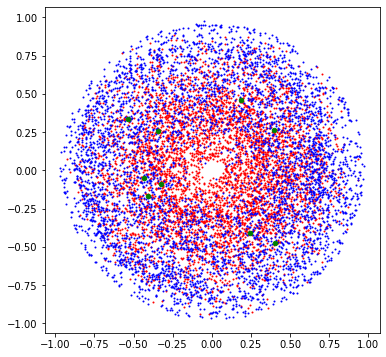


Epoch 22:  99%|█████████▊| 1006/1020 [07:57<00:06,  2.11it/s, loss=0.569, v_num=kt0p]

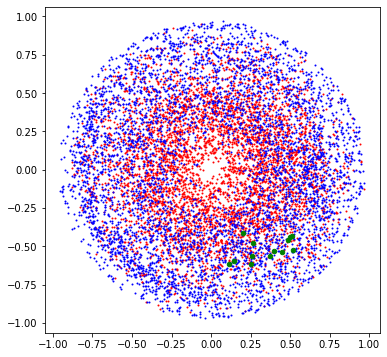


Epoch 22:  99%|█████████▊| 1007/1020 [08:06<00:06,  2.07it/s, loss=0.569, v_num=kt0p]

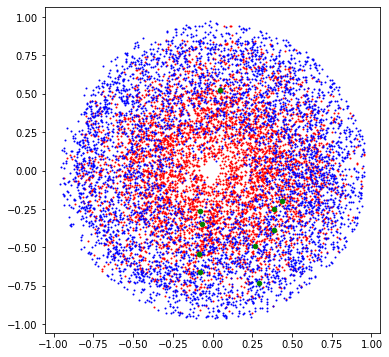


Epoch 22:  99%|█████████▉| 1008/1020 [08:14<00:05,  2.04it/s, loss=0.569, v_num=kt0p]

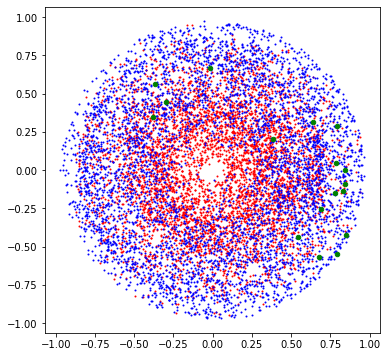


Epoch 22:  99%|█████████▉| 1009/1020 [08:22<00:05,  2.01it/s, loss=0.569, v_num=kt0p]

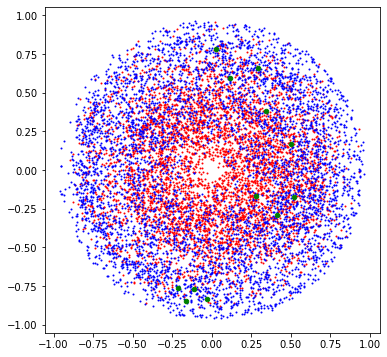


Epoch 22:  99%|█████████▉| 1010/1020 [08:31<00:05,  1.97it/s, loss=0.569, v_num=kt0p]

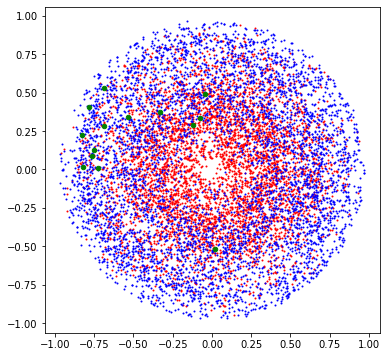


Epoch 22:  99%|█████████▉| 1011/1020 [08:40<00:04,  1.94it/s, loss=0.569, v_num=kt0p]

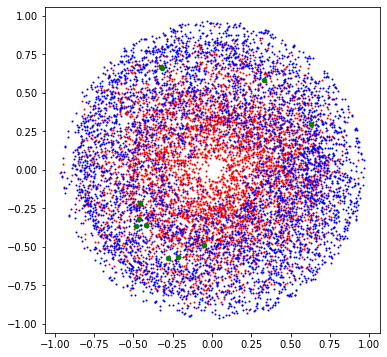


Epoch 22:  99%|█████████▉| 1012/1020 [08:50<00:04,  1.91it/s, loss=0.569, v_num=kt0p]

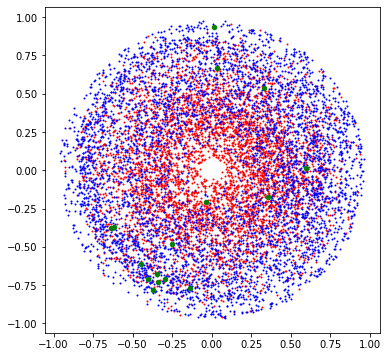


Epoch 22:  99%|█████████▉| 1013/1020 [09:00<00:03,  1.88it/s, loss=0.569, v_num=kt0p]

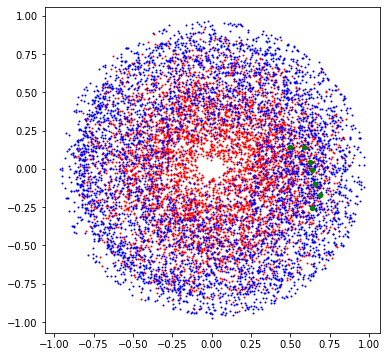


Epoch 22:  99%|█████████▉| 1014/1020 [09:09<00:03,  1.85it/s, loss=0.569, v_num=kt0p]

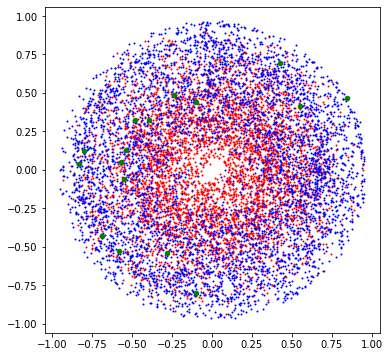


Epoch 22: 100%|█████████▉| 1015/1020 [09:19<00:02,  1.81it/s, loss=0.569, v_num=kt0p]

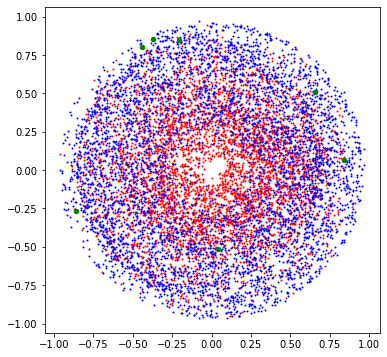


Epoch 22: 100%|█████████▉| 1016/1020 [09:28<00:02,  1.79it/s, loss=0.569, v_num=kt0p]

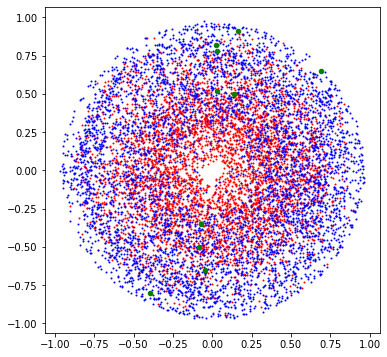


Epoch 22: 100%|█████████▉| 1017/1020 [09:36<00:01,  1.76it/s, loss=0.569, v_num=kt0p]

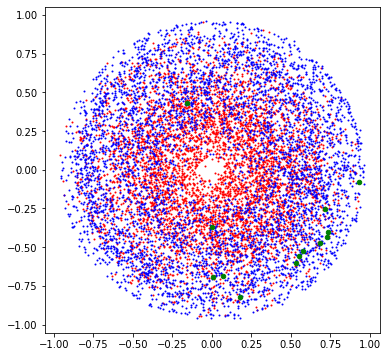


Epoch 22: 100%|█████████▉| 1018/1020 [09:46<00:01,  1.74it/s, loss=0.569, v_num=kt0p]

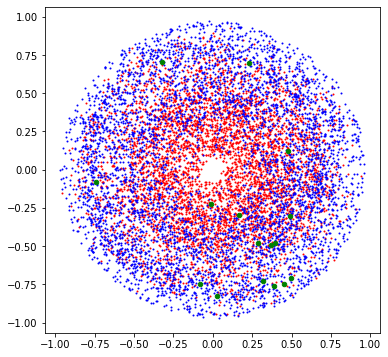


Epoch 22: 100%|█████████▉| 1019/1020 [09:54<00:00,  1.71it/s, loss=0.569, v_num=kt0p]

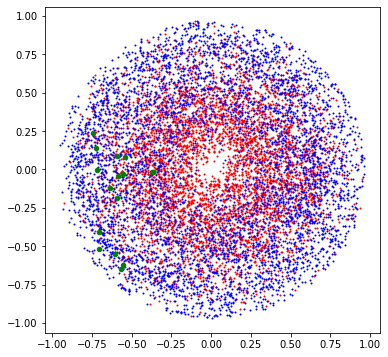


Epoch 22: 100%|██████████| 1020/1020 [10:03<00:00,  1.69it/s, loss=0.569, v_num=kt0p]

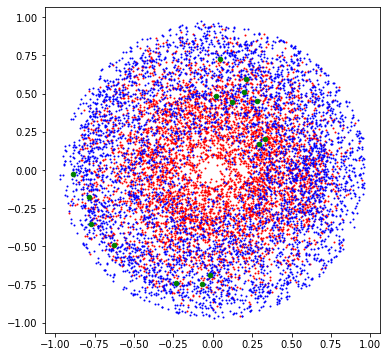


Epoch 23:  98%|█████████▊| 1000/1020 [07:09<00:08,  2.33it/s, loss=0.569, v_num=kt0p]
Validating: 0it [00:00, ?it/s]
Validating:   0%|          | 0/20 [00:00<?, ?it/s]

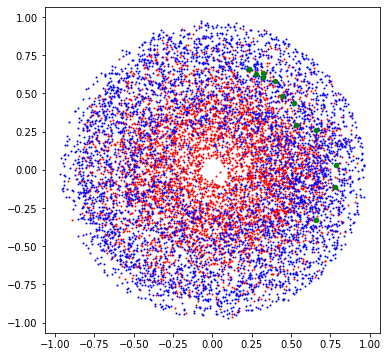


Epoch 23:  98%|█████████▊| 1002/1020 [07:20<00:07,  2.27it/s, loss=0.569, v_num=kt0p]

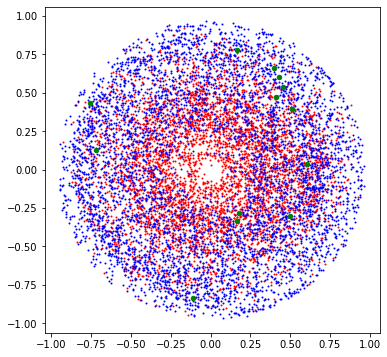


Epoch 23:  98%|█████████▊| 1003/1020 [07:29<00:07,  2.23it/s, loss=0.569, v_num=kt0p]

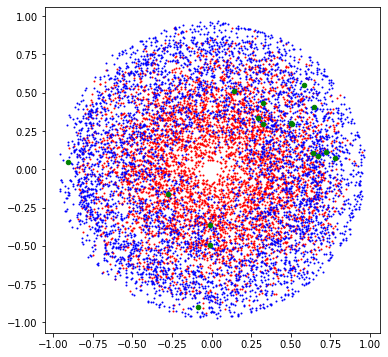


Epoch 23:  98%|█████████▊| 1004/1020 [07:37<00:07,  2.19it/s, loss=0.569, v_num=kt0p]

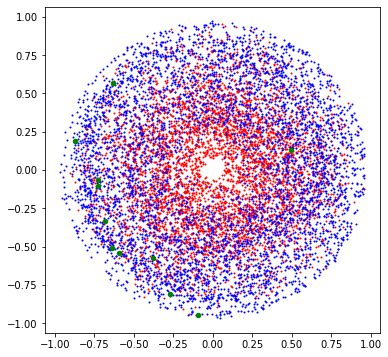


Epoch 23:  99%|█████████▊| 1005/1020 [07:45<00:06,  2.16it/s, loss=0.569, v_num=kt0p]

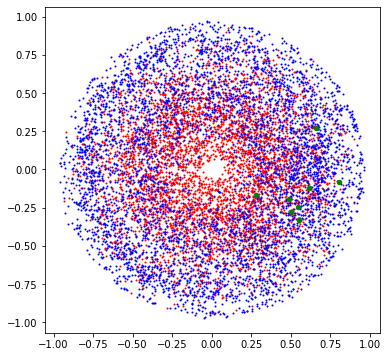


Epoch 23:  99%|█████████▊| 1006/1020 [07:55<00:06,  2.12it/s, loss=0.569, v_num=kt0p]

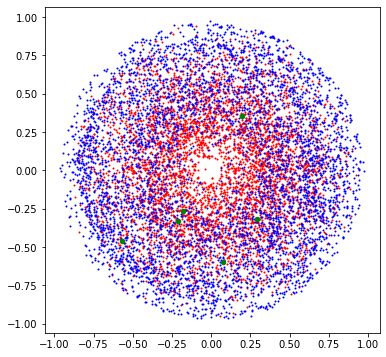


Epoch 23:  99%|█████████▊| 1007/1020 [08:04<00:06,  2.08it/s, loss=0.569, v_num=kt0p]

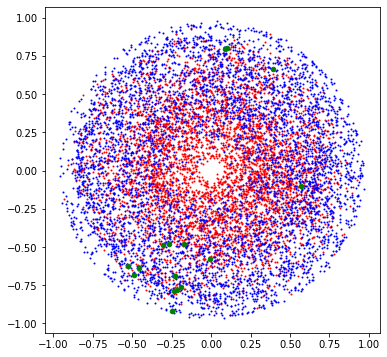


Epoch 23:  99%|█████████▉| 1008/1020 [08:12<00:05,  2.05it/s, loss=0.569, v_num=kt0p]

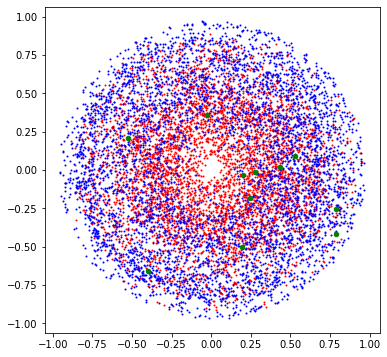


Epoch 23:  99%|█████████▉| 1009/1020 [08:20<00:05,  2.02it/s, loss=0.569, v_num=kt0p]

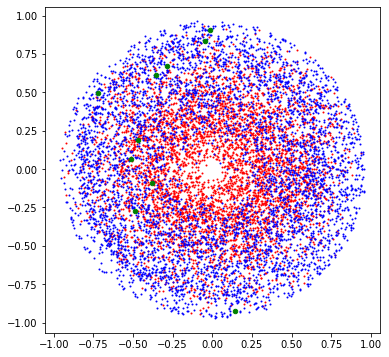


Epoch 23:  99%|█████████▉| 1010/1020 [08:29<00:05,  1.98it/s, loss=0.569, v_num=kt0p]

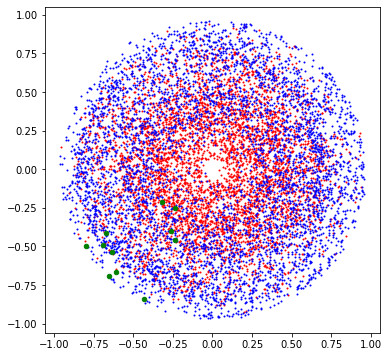


Epoch 23:  99%|█████████▉| 1011/1020 [08:37<00:04,  1.95it/s, loss=0.569, v_num=kt0p]

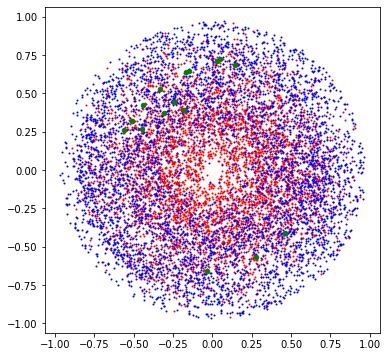


Epoch 23:  99%|█████████▉| 1012/1020 [08:48<00:04,  1.92it/s, loss=0.569, v_num=kt0p]

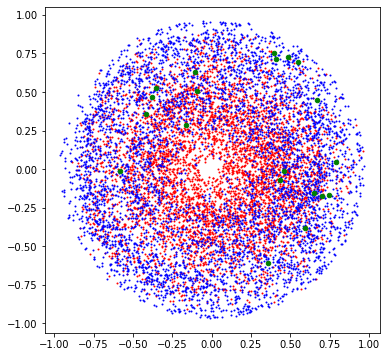


Epoch 23:  99%|█████████▉| 1013/1020 [08:57<00:03,  1.89it/s, loss=0.569, v_num=kt0p]

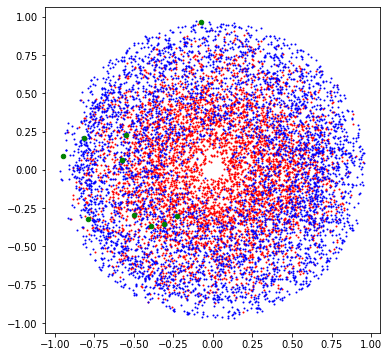


Epoch 23:  99%|█████████▉| 1014/1020 [09:06<00:03,  1.86it/s, loss=0.569, v_num=kt0p]

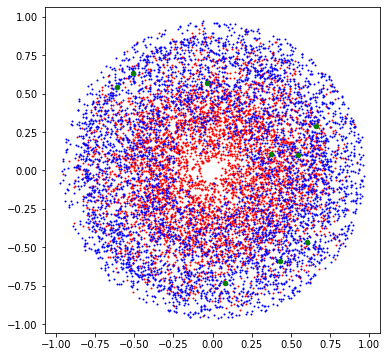


Epoch 23: 100%|█████████▉| 1015/1020 [09:16<00:02,  1.82it/s, loss=0.569, v_num=kt0p]

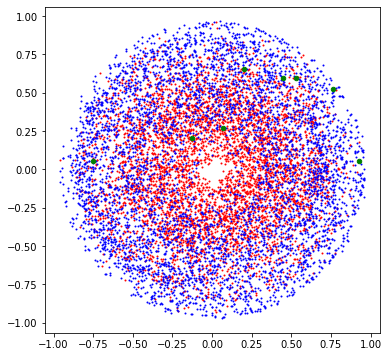


Epoch 23: 100%|█████████▉| 1016/1020 [09:25<00:02,  1.80it/s, loss=0.569, v_num=kt0p]

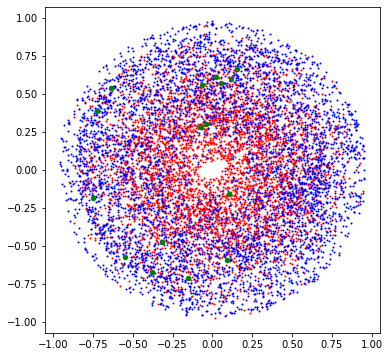


Epoch 23: 100%|█████████▉| 1017/1020 [09:33<00:01,  1.77it/s, loss=0.569, v_num=kt0p]

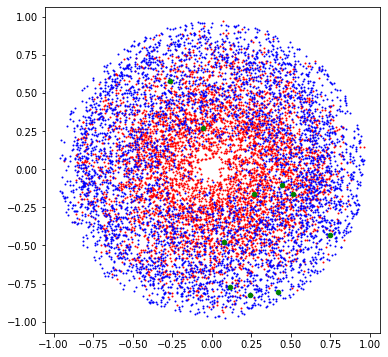


Epoch 23: 100%|█████████▉| 1018/1020 [09:42<00:01,  1.75it/s, loss=0.569, v_num=kt0p]

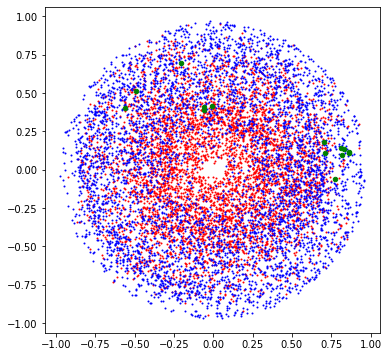


Epoch 23: 100%|█████████▉| 1019/1020 [09:50<00:00,  1.72it/s, loss=0.569, v_num=kt0p]

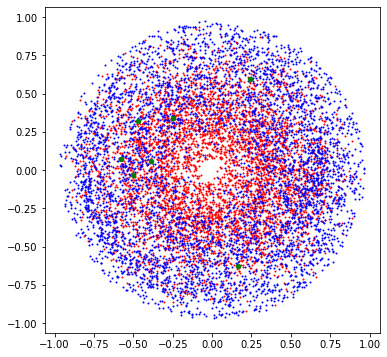


Epoch 23: 100%|██████████| 1020/1020 [09:59<00:00,  1.70it/s, loss=0.569, v_num=kt0p]

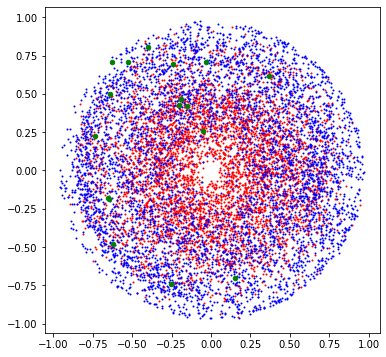


Epoch 24:  63%|██████▎   | 643/1020 [04:36<02:41,  2.33it/s, loss=0.568, v_num=kt0p] 

In [ ]:
from pytorch_lightning.callbacks import ModelCheckpoint

checkpoint_callback = ModelCheckpoint(
    monitor='eff',
    mode="max",
    save_top_k=2,
    save_last=True)

logger = WandbLogger(project="ITk_0GeV", group="Common_track_cosine_embedding", name="cosineembedding_{}".format(training_name))
trainer = Trainer(gpus=1, max_epochs=cosine_hparams["max_epochs"], logger=logger, num_sanity_val_steps=0, callbacks=[checkpoint_callback], default_root_dir="/global/cfs/cdirs/m3443/usr/ryanliu/ITk_embedding/")
trainer.fit(cosine_model)



Test visualization

In [ ]:
checkpoint_path = "/global/cfs/cdirs/m3443/usr/ryanliu/ITk_embedding/ITk_0GeV/4du5uach/checkpoints/epoch=16-step=16999.ckpt"
checkpoint = torch.load(checkpoint_path)
cosine_model = CosineLayerlessEmbedding.load_from_checkpoint(checkpoint_path).to(device)

In [ ]:
cosine_model.setup("val")
batch = cosine_model.valset[5].to(device)

In [ ]:
cosine_model.plot(batch)